In [1]:
#######################################################################################
# Read Me Section:
## Name:
# Kaylen Smith Darnbrook
# Student ID:
# 2135667
# Course:
# M.S.c Machine Learning and Artificial Intelligence
# Module:
## DemonstrationFaceGeneration
## Description: 
# This module generates the baseline GAP Model used for denoising and generating faces.
# It uses the FFHQ256 dataset to train the model. The model is then saved to the
# 'models' directory. The model is then used to generate faces from the FFHQ256 dataset.
# A single model and cascade model implementation of GAP is used. The model is trained
# using the Adam optimizer and the loss function is the PhotonLoss Function. Each model
# is trained for 30 epochs. The models are compared using the Psnr, SSIM and Perceptual
# loss metric.
#####################################################################################

In [2]:
# Import Relevant Libraries:

# Import modules for system managment, io and file management 
import os 
import time 
import random

# Import modules for data manipulation and analysis
import numpy as np
import pandas as pd
import scipy as sp

# Import modules for data visualisation
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid", {"axes.facecolor": ".9"})
sns.set_context("notebook")
from PIL import Image

# Import modules for Deep learning
import torch
from torch.utils.data import DataLoader
torch.set_float32_matmul_precision('medium')
torch.autograd.set_detect_anomaly(True)

# Pytorch Lightning Modules:
import pytorch_lightning as pL
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping, LearningRateMonitor
from pytorch_lightning.callbacks import LearningRateMonitor

# Import modules for model selection and evaluation.
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

# Import the DataLoader
#from BinomDataset4 import FacesDataset
from PoissonDataset10 import FacesDataset
from PoissonValidator2 import ValidationSetGenerator
from OriginalGAPUNet import UNet

# Visualisation Software
import time
import numpy as np
import lpips

INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.14 (you have 1.4.11). Upgrade using: pip install --upgrade albumentations


In [3]:
'''
Samples an image using Generative Accumulation of Photons (GAP) based on an initial photon image.
If the initial photon image contains only zeros the model samples from scratch. 
If it contains photon numbers, the model performs diversity denoising.

        Parameters:
                input_image (torch tensor): the initial photon image, containing integers (batch, channel, y, x).  
                model: the network used to predict the next phton location.
                max_photons (int): stop sampling when image contains more photons. 
                max_its (int): stop sampling after max_its iterations. 
                max_psnr (float): stop sampling when pseudo PSNR is larger max_psnr
                save_every_n (int): store and return images at every nth step. 
                augment (bool): use 8-fold data augmentation (default is False) 
                beta (float): photon number is increased exponentially by factor beta in each step.
        Returns:
                denoised (numpy array): denoised image at the end of that sampling process.
                photons (numpy array): photon image at the end of the sampling process.
                stack (list): list of numpy arrays containing intermediate results.
                i (int) number of executed iterations.
'''
def sample_image_3(input_image,
                 model,
                 max_photons = None,
                 max_its = 500000,
                 max_psnr = -15,
                 save_every_n = 5,
                 beta = 0.1
                ):

    start = input_image.clone()
    photons = start
    photnum = 1

    denoised = None
    stack = []
    
    sumDenoised = start
    region = 64
    
    for i in range(max_its):
        #print(i)
        # compute the pseudo PSNR
        psnr = np.log10(photons.mean().item() + 1e-50) * 10
        psnr = max(-40, psnr)
        if i % 10 == 0:
            print(psnr)
            
        if (max_photons is not None) and (photons.sum().item() > max_photons):
            break
            
        if psnr > max_psnr:
            break
    
        denoised = model(photons)
        denoised.detach()
        denoised = denoised - denoised.max()
        denoised = torch.exp(denoised)   
        denoised = denoised / (denoised.sum(dim=(-1,-2,-3), keepdim = True))

        #denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
        #plt.figure(figsize=(5,5))
        #plt.imshow(denoised.squeeze(0).permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
        #plt.title('denoised')
        #plt.show()
        #plt.clf()

        #photon_image = (photons - photons.min())/(photons.max() - photons.min())
        #plt.imshow(photon_image.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons')
        #plt.show()
        #plt.clf()

        # here we save an image into our stack
        if (save_every_n is not None) and (i%save_every_n == 0):  

            imgsave = denoised.squeeze(0).permute(1,2,0).detach().cpu()
            imgsave = imgsave/imgsave.max()
            photsave = photons.squeeze(0).permute(1,2,0).detach().cpu()
            photsave = photsave / max(photsave.max(),1)      
            combi = torch.hstack((photsave,imgsave))
            stack.append(combi.numpy())

        # increase photon number
        photnum = max(beta* photons.sum(),1)
        
        # draw new photons
        new_photons = torch.poisson(denoised*(photnum)) 
        
        # add new photons
        photons = photons + new_photons 
        #photon_image_new = (photons_new - photons_new.min())/(photons_new.max() - photons_new.min())
        #plt.imshow(photon_image_new.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons_new')
        #plt.show()
        #plt.clf()
    
    #print("Final PSNR Score", psnr)
    return denoised[...].detach().cpu().numpy(), photons[...].detach().cpu().numpy(), stack, i

In [4]:
# Wraps around the sample_image_3 function to generate the faces.
def Sample_Image(input_image, model,  max_psnr, max_its = 1000, beta = 0.005, save_every_n = 10, device = 'cuda'):
    channels = 3
    batch_size = 1
    pixels_x = 128
    pixels_y = 128

    model = model.to(device)
    model.eval()
    input_image = input_image.to(device)

    denoised, photons, stack, i = sample_image_3(input_image, model, max_its = max_its, max_psnr = max_psnr, 
                                                 beta = beta, save_every_n = save_every_n)
    return denoised, photons, stack, i

In [5]:
# Sets the plotting parameters for the visualisation of the images.
plt.rcParams["axes.facecolor"] = "white"
plt.rcParams["savefig.facecolor"] = "red"
plt.rc("text", usetex = False)
plt.rc("font", family = "Times New Roman")
plt.rcParams["axes.grid"] = False

In [6]:
## Configuration
# Set the seed for reproducibility
seed = 42
np.random.seed(seed)
torch.manual_seed(seed)

# Set the device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Device: {device}")
GREYSCALE = False

# Set the path to the data
root_path = r"ffhq256_dataset\ffhq256"  # Replace with the Directory the FFHQ256 dataset is stored in
out_dir =r"TestSet"
Batch_Size = 32
load_pretained = False
NUM_Features = 128 * 128
max_epochs = 30
patience = 10
minpsnr = -40
maxpsnr = 32

Device: cuda


In [7]:
# Generates plots of the Psnr, SSIM and Perceptual Loss from the data.
from IPython.display import display
def Plot_Creater(Psnr_Distribution, SSIM_Distribution, Perceptual_Distribution, minpsnr, maxpsnr):

    # Generate a dataframe of the Psnr, SSIM and Perceptual Loss
    # Calculate the rolling mean and standard deviation of the data.
    # Plot the data using Seaborn.
    # Calculate the area under the curve for the Psnr, SSIM and Perceptual Loss.
    # Print the mean, standard deviation, minimum and maximum values of the data.
    # Return the area under the curve for the Psnr, SSIM and Perceptual Loss.

    Psnr_Distribution = pd.DataFrame(Psnr_Distribution, columns = ["PSNR"])
    Psnr_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution.shape[0])
    Psnr_Distribution["PSNR_Average"] = Psnr_Distribution["PSNR"].rolling(window = 12).mean()
    Psnr_Distribution["PSNR_Variance"] = Psnr_Distribution["PSNR"].rolling(window = 12).std()
    Psnr_Distribution["PSNR_Variance_Upper"] = Psnr_Distribution["PSNR_Average"] + Psnr_Distribution["PSNR"].rolling(window = 12).std()
    Psnr_Distribution["PSNR_Variance_Lower"] = Psnr_Distribution["PSNR_Average"] - Psnr_Distribution["PSNR"].rolling(window = 12).std()   
    Psnr_Distribution.dropna(inplace = True)
    display(Psnr_Distribution.describe())

    SSIM_Distribution = pd.DataFrame(SSIM_Distribution, columns = ["SSIM"])
    SSIM_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution.shape[0])
    SSIM_Distribution["SSIM_Average"] = SSIM_Distribution["SSIM"].rolling(window = 12).mean()
    SSIM_Distribution["SSIM_Variance"] = SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution["SSIM_Variance_Upper"] = SSIM_Distribution["SSIM_Average"] + SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution["SSIM_Variance_Lower"] = SSIM_Distribution["SSIM_Average"] - SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution.dropna(inplace = True)
    display(SSIM_Distribution.describe())

    Perceptual_Distribution = pd.DataFrame(Perceptual_Distribution, columns = ["1-PL"])
    Perceptual_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution.shape[0])
    Perceptual_Distribution["1-PL_Average"] = Perceptual_Distribution["1-PL"].rolling(window = 12).mean()
    Perceptual_Distribution["1-PL_Variance"] = Perceptual_Distribution["1-PL"].rolling(window = 12).std()
    Perceptual_Distribution["1-PL_Variance_Upper"] = Perceptual_Distribution["1-PL_Average"] + Perceptual_Distribution["1-PL_Average"].rolling(window = 12).std()
    Perceptual_Distribution["1-PL_Variance_Lower"] = Perceptual_Distribution["1-PL_Average"] - Perceptual_Distribution["1-PL_Average"].rolling(window = 12).std()
    Perceptual_Distribution.dropna(inplace = True)
    display(Perceptual_Distribution.describe())

    plt.Figure(figsize=(10,10))
    sns.set_style("darkgrid")
    sns.scatterplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
    Psnr_Area = np.trapz(Psnr_Distribution["PSNR_Average"].values, Psnr_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("PSNR")
    plt.title("Psnr vs Pseudo_Psnr")
    plt.show()

    plt.Figure(figsize=(10,10))
    sns.set_style("darkgrid")
    sns.scatterplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
    SSIM_Area = np.trapz(SSIM_Distribution["SSIM_Average"].values, SSIM_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("SSIM")
    plt.title("SSIM vs Pseudo_Psnr")
    plt.show()

    plt.Figure(figsize=(10,10))
    sns.scatterplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red") 
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
    Perceptual_Area = np.trapz(Perceptual_Distribution["1-PL_Average"].values, Perceptual_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("1-Perceptual_Loss")
    plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
    plt.show()

    print(f"Psnr Area: {Psnr_Area}, SSIM Area: {SSIM_Area}, Perceptual Area: {Perceptual_Area}")

    print("Mean Psnr",Psnr_Distribution["PSNR"].mean())
    print("Std Psnr",Psnr_Distribution["PSNR"].std()) 
    print("Min Psnr",Psnr_Distribution["PSNR"].min()) 
    print("Max Psnr",Psnr_Distribution["PSNR"].max())
    print("Mean Roll Var",Psnr_Distribution["PSNR_Variance"].mean())

    print("Mean SSIM",SSIM_Distribution["SSIM"].mean())
    print("Std SSIM",SSIM_Distribution["SSIM"].std()) 
    print("Min SSIM",SSIM_Distribution["SSIM"].min()) 
    print("Max SSIM",SSIM_Distribution["SSIM"].max())
    print("Mean Roll SSIM",SSIM_Distribution["SSIM_Variance"].mean())

    print("Mean 1-PL",Perceptual_Distribution["1-PL"].mean())
    print("Std 1-PL",Perceptual_Distribution["1-PL"].std()) 
    print("Min 1-PL",Perceptual_Distribution["1-PL"].min()) 
    print("Max 1-PL",Perceptual_Distribution["1-PL"].max())
    print("Mean Roll 1-PL",Perceptual_Distribution["1-PL_Variance"].mean())

    return Psnr_Area, SSIM_Area, Perceptual_Area

In [8]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
Steps = 9
Spacing = (maxpsnr - minpsnr) // Steps
PSNR_Ranges = [(i, j) for i, j in zip(range(minpsnr, maxpsnr, Spacing), range(minpsnr + Spacing, maxpsnr + Spacing, Spacing))]
print(PSNR_Ranges)

[(-40, -32), (-32, -24), (-24, -16), (-16, -8), (-8, 0), (0, 8), (8, 16), (16, 24), (24, 32)]


In [9]:
# Generates the metric functions for the PSNR, SSIM and Pseudo_PSNR
def PSNR(original, transformed, maximum):
    mse = np.mean((original-transformed)**2)
    if mse == 0:
        return 100
    max_pixel_value = maximum
    psnr = 20 * np.log10(max_pixel_value/np.sqrt(mse))
    return psnr

def SSIM(original, transformed):
    return sp.signal.ssim(original, transformed, multichannel=True)

def Estimated_Psuedo_PSNR(transformed, image_size):
    intensity = transformed/image_size
    return 10 * np.log(intensity)

In [10]:
# Generates a plot of the random persons in the dataset.
def plot_random_persons(images, sample = 9):
    random_image_indexes=np.array(random.sample(list(range(len(images))),sample))
    images = np.array([np.asarray(Image.open(os.path.join(root_path, images[index]))) for index in random_image_indexes])

    if (np.sqrt(sample) - int(np.sqrt(sample))) == 0:
        sqrt = int(np.sqrt(sample))
        Length, width = sqrt, sqrt
    else:
        Length, width = 1, sample
    
    fig = plt.figure(figsize=(15,15))
    for index, values in enumerate(random_image_indexes):
        images = np.array(images)
        image = (images[index] - images[index].min())/(images[index].max() - images[index].min())
        plt.subplot(Length,width,index+1)
        plt.imshow(image)
        plt.title(f'Person_id: {random_image_indexes[index]}\nShape: {images[index].shape}')
    return fig

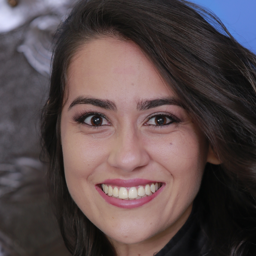

In [11]:
# Grabs the image paths from the dataset.
Image_Paths = [os.path.join(root_path, img) for img in os.listdir(root_path)]
Image_Paths 
Image.open(os.path.join(root_path, Image_Paths[50128]))

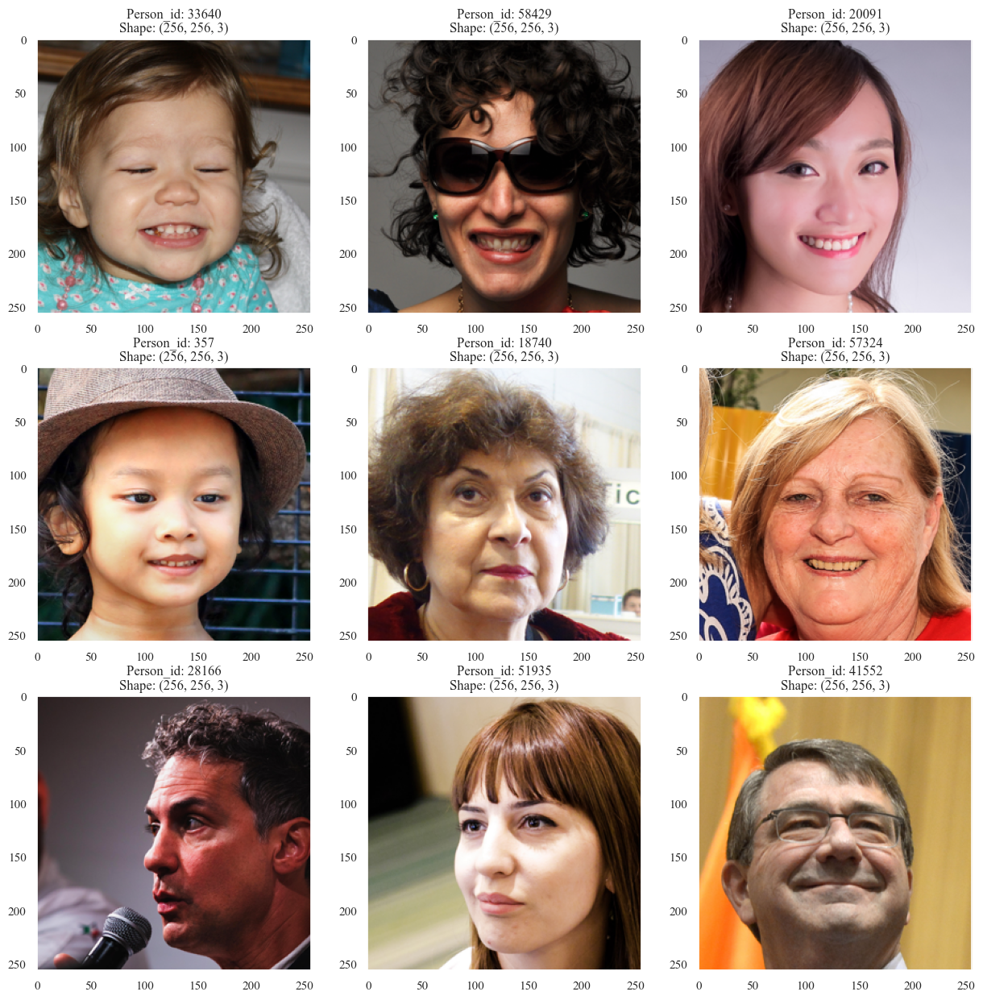

In [12]:
# Plots the Faces
fig = plot_random_persons(Image_Paths, sample = 9)

In [13]:
# Splits the data into the training and validation sets.
Directory = [path for path in os.listdir(root_path)]
rng = np.random.default_rng(seed)
indices = rng.permutation(len(Directory))
split_index = int(len(Directory) * 0.8)
train_indices = indices[:split_index]
val_indices = indices[split_index:]
train_indices.shape, val_indices.shape

((56000,), (14000,))

In [14]:
# Collects the Training and Validation Paths
Train_Paths = [Directory[index] for index in train_indices]
Val_Paths = [Directory[index] for index in val_indices]
Paths = Train_Paths.copy()
Paths.extend(Val_Paths)
np.shape(Train_Paths), np.shape(Val_Paths), np.shape(Paths)

((56000,), (14000,), (70000,))

In [16]:
# Generates the Training and Validation Datasets as well as their respective loaders.
print(PSNR_Ranges[-9][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-9][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-9][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-40 32


(16384, 4096)

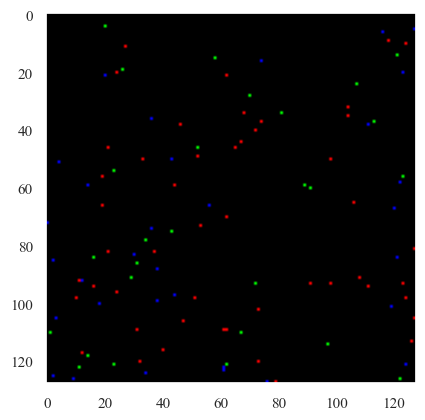

PSNR: -26.592430114746094
True PSNR: -21.29270442542563


In [22]:
# Grabs a sample image from the dataset and evaluates the PSNR.
ImageNoise, psnr_map, image_target = Train_Dataset.__getitem__(42)
ImageNoise = ImageNoise.detach().cpu().numpy().transpose(1,2,0)
image_target = image_target.detach().cpu().numpy().transpose(1,2,0)
normalised_noisy_image = ImageNoise/ImageNoise.mean()
normalised_image_target = image_target/image_target.mean()
true_psnr = psnr(normalised_image_target, normalised_noisy_image, data_range = normalised_image_target.max() - normalised_image_target.min())
normalised_image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
normalised_noisy_image = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
plt.imshow(normalised_noisy_image)
plt.show()
print(f"PSNR: {psnr_map.min().detach().cpu().numpy()}")
print(f"True PSNR: {true_psnr}")

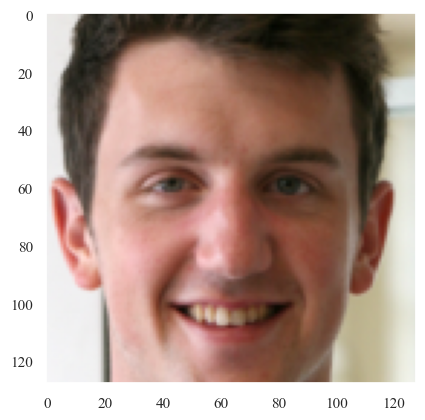

In [23]:
# Compares the original image with the noisy image.
plt.imshow(normalised_image_target)
plt.show()

In [27]:
# Grabs the Validation Paths for the Validation Noisy Images, PSNR Maps and Target Images.
Noisy_Images_Paths = []
Psnr_Maps_Paths = []
Image_Targets_Paths = []
with open(r"Validation_File_PathNames\NoisyImageNames.txt", "r") as File:
    for line in File.readlines():
        Noisy_Images_Paths.append(line[:-1])
with open(r"Validation_File_PathNames\Psnr_MapNames.txt", "r") as File:
    for line in File.readlines():
        Psnr_Maps_Paths.append(line[:-1])
with open(r"Validation_File_PathNames\TargetImageNames.txt", "r") as File:
    for line in File.readlines():
        Image_Targets_Paths.append(line[:-1])
len(Noisy_Images_Paths), len(Psnr_Maps_Paths), len(Image_Targets_Paths)

(10, 10, 10)

In [28]:
# Generates dictionaries to store the Validation Noisy Images, PSNR Maps and Target Images.
Validation_Noisy_Images = {}
Validation_Psnr_Maps = {}
Validation_Target_Images = {}
val_Steps = 10
val_minpsnr = -40
val_maxpsnr = 40
val_Spacing = (val_maxpsnr - val_minpsnr) // val_Steps
val_psnr_ranges = [(i, j) for i, j in zip(range(val_minpsnr, val_maxpsnr, val_Spacing), range(val_minpsnr + val_Spacing, val_maxpsnr + val_Spacing, val_Spacing))]
print(len(val_psnr_ranges))
FaceValidators = [ValidationSetGenerator(root_dir= root_path, out_dir=out_dir, names = Paths, minPSNR= val_psnr_ranges[i][0], targetPSNR = val_psnr_ranges[i][1], augment= True, sample_size = 100, grayscale= GREYSCALE, amplification_factor= 1e2) for i in range(len(val_psnr_ranges))]
FaceValidators[0].out_dir
print(val_psnr_ranges)
for index in range(len(val_psnr_ranges)):
    psnr_label = str(val_psnr_ranges[index][0]) + str(val_psnr_ranges[index][1])
    print(f"Loading Validation Data for {index} Val_Dataset at psnr range {psnr_label}")
    FaceValidator = FaceValidators[index]
    File_Path_NI = Noisy_Images_Paths[index]
    File_Path_PSM = Psnr_Maps_Paths[index]
    File_Path_TI = Image_Targets_Paths[index]
    Noisy_Images, Psnr_Maps, Target_Images = FaceValidator.Load_Noisy_Faces(File_Path_NI, File_Path_PSM, File_Path_TI, device=device)
    Validation_Noisy_Images[psnr_label] = Noisy_Images
    Validation_Psnr_Maps[psnr_label] = Psnr_Maps
    Validation_Target_Images[psnr_label] = Target_Images
len(Validation_Noisy_Images), len(Validation_Psnr_Maps), len(Validation_Target_Images)

10
[(-40, -32), (-32, -24), (-24, -16), (-16, -8), (-8, 0), (0, 8), (8, 16), (16, 24), (24, 32), (32, 40)]
Loading Validation Data for 0 Val_Dataset at psnr range -40-32
Loading Validation Data for 1 Val_Dataset at psnr range -32-24
Loading Validation Data for 2 Val_Dataset at psnr range -24-16
Loading Validation Data for 3 Val_Dataset at psnr range -16-8
Loading Validation Data for 4 Val_Dataset at psnr range -80
Loading Validation Data for 5 Val_Dataset at psnr range 08
Loading Validation Data for 6 Val_Dataset at psnr range 816
Loading Validation Data for 7 Val_Dataset at psnr range 1624
Loading Validation Data for 8 Val_Dataset at psnr range 2432
Loading Validation Data for 9 Val_Dataset at psnr range 3240


(10, 10, 10)

In [29]:
# Outputs the different keys (Noise Ranges) in the Validation Noisy Images, PSNR Maps and Target Images.
Validation_Noisy_Images.keys()

dict_keys(['-40-32', '-32-24', '-24-16', '-16-8', '-80', '08', '816', '1624', '2432', '3240'])

In [30]:
# Generates a sample image from the Validation Noisy Images across different noise levels
# and evaluates the visualisation of the image.
ValidationNoisyTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
ValidationPsnrTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
ValidationTargetTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
for index, key in enumerate(Validation_Noisy_Images.keys()):
    ValidationNoisyTest_Batch[index] = Validation_Noisy_Images[key][-10]
    ValidationPsnrTest_Batch[index] = Validation_Psnr_Maps[key][-10].view(1, 3, 128, 128)
    ValidationTargetTest_Batch[index] = Validation_Target_Images[key][-10]
ValidationNoisyTest_Batch.shape, ValidationPsnrTest_Batch.shape, ValidationTargetTest_Batch.shape

(torch.Size([10, 3, 128, 128]),
 torch.Size([10, 3, 128, 128]),
 torch.Size([10, 3, 128, 128]))

In [31]:
# Moves the validation data to the gpu
ValidationNoisyTest_Batch = ValidationNoisyTest_Batch.to(device)
ValidationPsnrTest_Batch = ValidationPsnrTest_Batch.to(device)
ValidationTargetTest_Batch = ValidationTargetTest_Batch.to(device)

In [26]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the Baseline U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [24]:
# Creates the directory to save the model in.
name = "FaceGenerationUNet128x128-m40-32"
CHECKPOINT_PATH = "./models/" 

In [28]:
# Trains the model using the Pytorch Lightning Trainer.
# The model is trained for 30 epochs and the model is saved in the models directory.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=10)])
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [25]:
# Loads the model from the checkpoint
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [33]:
# Validates the trained model on the Train Set
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.13366636633872986    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.13366636633872986}]

In [34]:
# Validates the trained model on the Validation Set
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.13710051774978638    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.13710051774978638}]

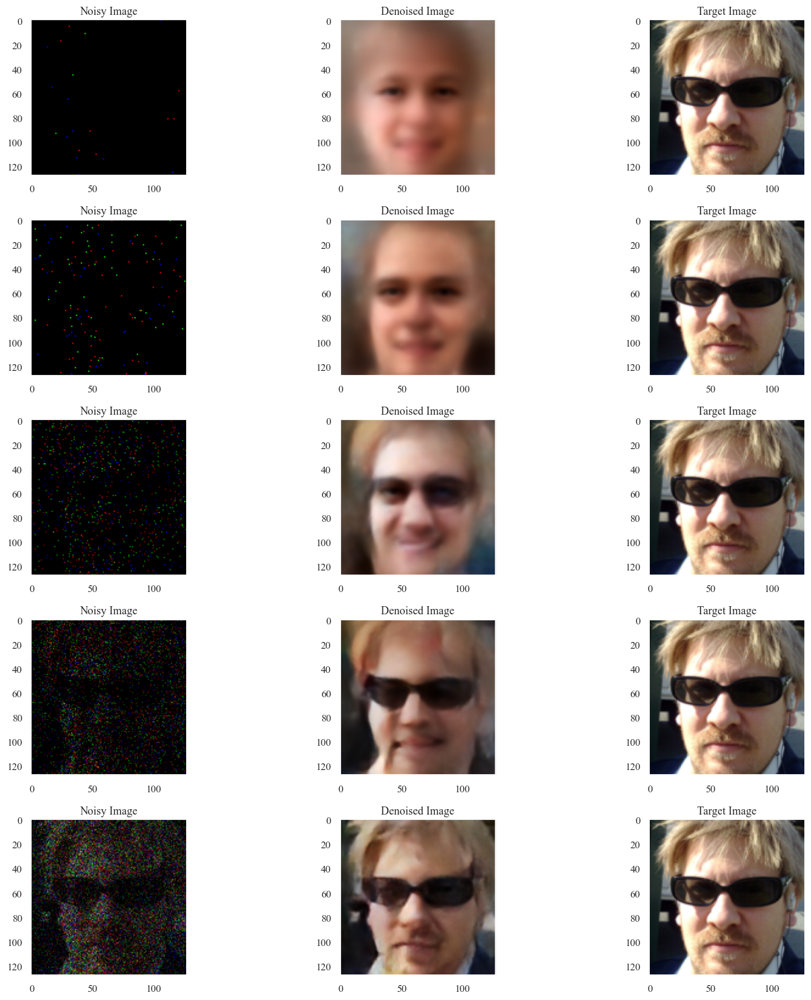

In [32]:
# Plots and visualises the sample Validation Noisy Image, Denoised Image and Target Image across the different noise levels.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

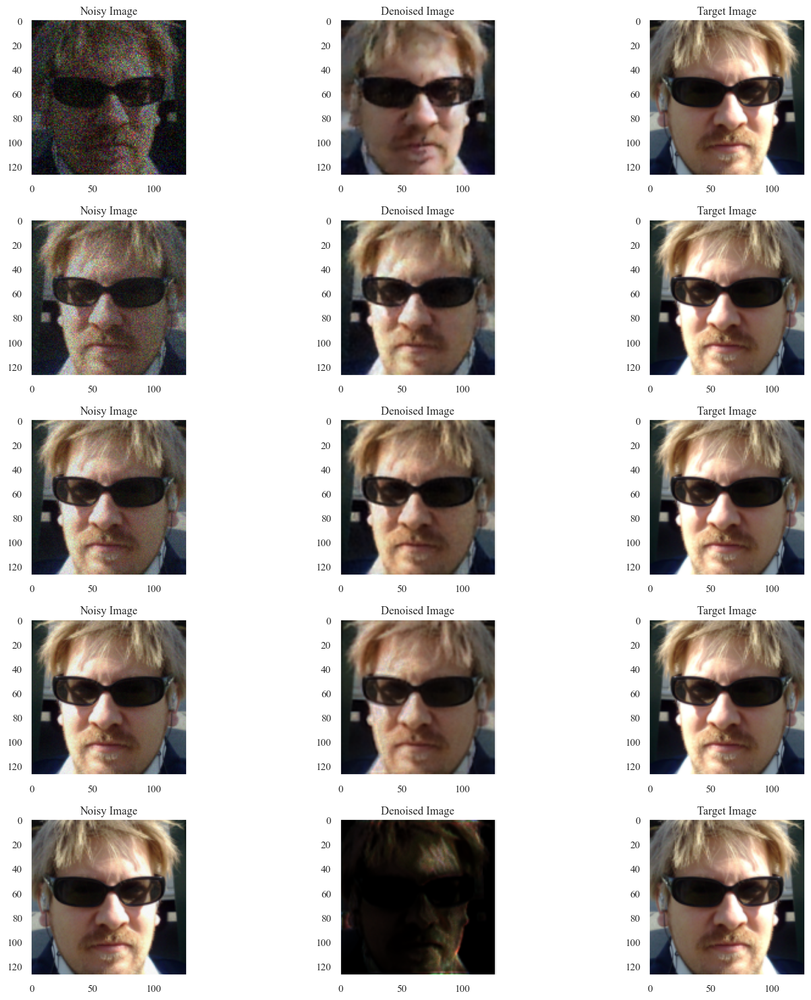

In [109]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [34]:
# Generates an unseen face from the dataset and evaluates the PSNR.
ImageNoise, Psnr_map, image_target = ValidationNoisyTest_Batch[0], ValidationPsnrTest_Batch[0], ValidationTargetTest_Batch[0]
model = model.to(device)
model.eval()
inp_img = ImageNoise.unsqueeze(0).to(device)
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
vmax = np.percentile(image_target.detach().cpu().numpy(), 99.9)

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 3
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 128
pixels_y = 128

#inp_img =  ImageNoise.unsqueeze(0).to(device)
print(inp_img.shape)
model = model.to(device)

for i in range(1):
    
    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_image_3(inp_img,
                                                        model.to(device), 
                                                        max_its=1000,
                                                        beta = 0.05,
                                                        save_every_n = 30,
                                                        max_psnr = PSNR_Ranges[-1][1])
denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
plt.figure(figsize=(5,5))
plt.imshow(denoised[0].transpose(1,2,0),vmin = 0, vmax = vmax)
plt.title('denoised')
plt.show()
plt.clf()
print('_______________________________________', iterations)
endTime = time.time()
elapsedTime = endTime - startTime
print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])

torch.Size([1, 3, 128, 128])
-33.6932189928148
-32.765678301147545
-32.001794734601276
-30.68291903617499
-29.591474341924307
-28.654663789511254
-27.830561751367494
-27.27753348662214
-27.047694255903522
-26.54114665676575
-26.087557963154463
-25.676895281355026
-25.212794562325776
-24.95641520501682
-24.766973358658603
-24.560127278438742
-24.082399653118497
-23.6932189928148
-23.223253366052564
-22.83301215760566
-22.29143173265382
-21.704030903510983
-21.31634568979287
-20.949440816122102
-20.61113287951464
-20.21295340941275
-19.755378248928782
-19.371928349705502
-18.963566043329752
-18.47685761898244
-18.067458214265123
-17.616116027824795
-17.263394642709272
-16.86790038424398
-16.415483370952565
-15.946311598015582


RuntimeError: CUDA error: out of memory
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.


In [73]:
# Evaluates the model on the test set of the Validation Noisy Images, PSNR Maps and Target Images.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_1 = np.array(Psnr_Distribution)
SSIM_Distribution_1 = np.array(SSIM_Distribution)
Perceptual_Distribution_1 = np.array(Perceptual_Distribution)
Psnr_Distribution_1.shape, SSIM_Distribution_1.shape, Perceptual_Distribution_1.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [45]:
# Generates the dataframe for the Psnr
Psnr_Distribution_1 = pd.DataFrame(Psnr_Distribution_1, columns = ["PSNR"])
Psnr_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution_1.shape[0])
Psnr_Distribution_1["PSNR_Average"] = Psnr_Distribution_1["PSNR"].rolling(window = 12).mean()
Psnr_Distribution_1["PSNR_Variance"] = Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1["PSNR_Variance_Upper"] = Psnr_Distribution_1["PSNR_Average"] + Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1["PSNR_Variance_Lower"] = Psnr_Distribution_1["PSNR_Average"] - Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1.dropna(inplace = True)
Psnr_Distribution_1.describe()

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,22.946108,-3.559511,22.851904,1.419083,24.270986,21.432821
std,6.524294,20.564969,6.396547,0.340836,6.361009,6.449925
min,9.534812,-39.119021,13.076077,0.703284,14.475742,11.329538
25%,16.927605,-21.339266,16.770744,1.188115,18.092826,15.316895
50%,22.823743,-3.559511,22.721654,1.358948,24.025030,21.420345
75%,29.226769,14.220245,29.881936,1.612756,31.285603,28.237103
max,35.376661,32.000000,31.961869,2.553532,33.917736,30.955282


In [25]:
# Generates the dataframe for the SSIM
SSIM_Distribution_1 = pd.DataFrame(SSIM_Distribution_1, columns = ["SSIM"])
SSIM_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution_1.shape[0])
SSIM_Distribution_1["SSIM_Average"] = SSIM_Distribution_1["SSIM"].rolling(window = 12).mean()
SSIM_Distribution_1["SSIM_Variance"] = SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1["SSIM_Variance_Upper"] = SSIM_Distribution_1["SSIM_Average"] + SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1["SSIM_Variance_Lower"] = SSIM_Distribution_1["SSIM_Average"] - SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1.dropna(inplace = True)
SSIM_Distribution_1.describe()

,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.673632,-3.559511,0.670108,0.050748,0.720856,0.619359
std,0.217673,20.564969,0.211923,0.020682,0.194796,0.229635
min,0.185041,-39.119021,0.332490,0.009061,0.396513,0.252586
25%,0.477732,-21.339266,0.456092,0.034303,0.514691,0.390345
50%,0.705189,-3.559511,0.694195,0.052941,0.749749,0.638867
75%,0.886519,14.220245,0.885591,0.066979,0.920308,0.835858
max,0.971518,32.000000,0.950868,0.107478,0.990535,0.934394


In [26]:
# Generates the dataframe for the Perceptual Loss
Perceptual_Distribution_1 = pd.DataFrame(Perceptual_Distribution_1, columns = ["1-PL"])
Perceptual_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution_1.shape[0])
Perceptual_Distribution_1["1-PL_Average"] = Perceptual_Distribution_1["1-PL"].rolling(window = 12).mean()
Perceptual_Distribution_1["1-PL_Variance"] = Perceptual_Distribution_1["1-PL"].rolling(window = 12).std()
Perceptual_Distribution_1["1-PL_Variance_Upper"] = Perceptual_Distribution_1["1-PL_Average"] + Perceptual_Distribution_1["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_1["1-PL_Variance_Lower"] = Perceptual_Distribution_1["1-PL_Average"] - Perceptual_Distribution_1["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_1.dropna(inplace = True)
Perceptual_Distribution_1.describe()

,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.465052,-3.119021,0.461664,0.055355,0.471579,0.451749
std,0.299528,20.310653,0.294188,0.028444,0.298115,0.290840
min,-0.052407,-38.238042,0.098707,0.010989,0.101214,0.093494
25%,0.132980,-20.678532,0.124758,0.033289,0.127995,0.120599
50%,0.619635,-3.119021,0.667601,0.053993,0.686700,0.654774
75%,0.735786,14.440489,0.716669,0.072825,0.727453,0.707677
max,0.914533,32.000000,0.824970,0.242917,0.836123,0.814135


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

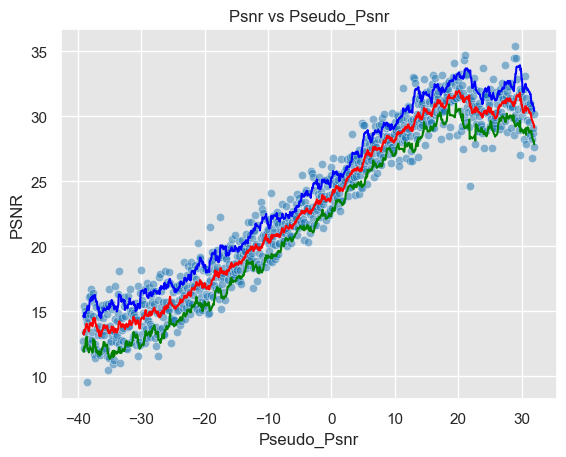

In [ ]:
# Generates the plots for the Psnr
plt.Figure(figsize=(10,10))
sns.scatterplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
Psnr_Area_1 = np.trapz(Psnr_Distribution_1["PSNR_Average"].values, Psnr_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("PSNR")
plt.title("Psnr vs Pseudo_Psnr")
plt.show()

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

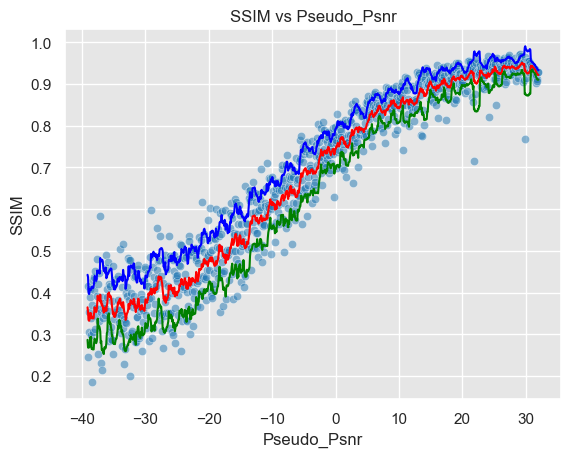

In [ ]:
# Generates the plots for the SSIM
plt.Figure(figsize=(10,10))
sns.scatterplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
SSIM_Area_1 = np.trapz(SSIM_Distribution_1["SSIM_Average"].values, SSIM_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("SSIM")
plt.title("SSIM vs Pseudo_Psnr")
plt.show()

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

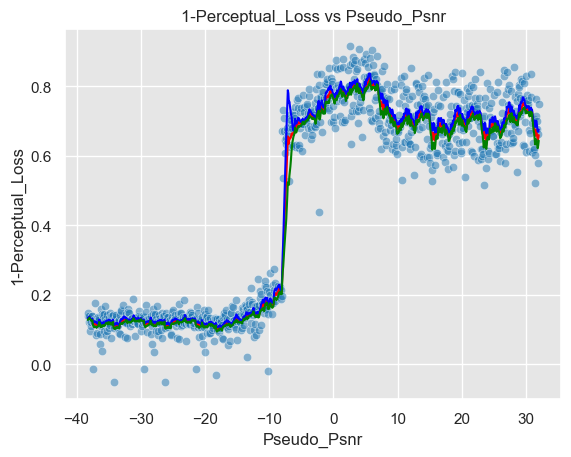

In [ ]:
# Generates the plots for the Perceptual Loss
plt.Figure(figsize=(10,10))
sns.scatterplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red")
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
Perceptual_Area_1 = np.trapz(Perceptual_Distribution_1["1-PL_Average"].values, Perceptual_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("1-Perceptual_Loss")
plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
plt.show()

In [49]:
# Prints the Areas under the curve for the Psnr, SSIM and Perceptual Loss.
print(Psnr_Area_1), print(SSIM_Area_1), print(Perceptual_Area_1)

1625.3343218156792
47.65957568391943
32.43177531425892


(None, None, None)

In [50]:
# Generates the summary statistics for the Psnr
print("Mean Psnr",Psnr_Distribution_1["PSNR"].mean())
print("Std Psnr",Psnr_Distribution_1["PSNR"].std()) 
print("Min Psnr",Psnr_Distribution_1["PSNR"].min()) 
print("Max Psnr",Psnr_Distribution_1["PSNR"].max())
print("Mean Roll Var",Psnr_Distribution_1["PSNR_Variance"].mean())

Mean Psnr 22.946107974973163
Std Psnr 6.524294312550647
Min Psnr 9.534811680980802
Max Psnr 35.37666074161767
Mean Roll Var 1.4190828863838074


In [51]:
# Generates the summary statistics for the SSIM
print("Mean SSIM",SSIM_Distribution_1["SSIM"].mean())
print("Std SSIM",SSIM_Distribution_1["SSIM"].std()) 
print("Min SSIM",SSIM_Distribution_1["SSIM"].min()) 
print("Max SSIM",SSIM_Distribution_1["SSIM"].max())
print("Mean Roll SSIM",SSIM_Distribution_1["SSIM_Variance"].mean())

Mean SSIM 0.6736319
Std SSIM 0.21767307817935944
Min SSIM 0.18504057824611664
Max SSIM 0.9715179800987244
Mean Roll SSIM 0.05074841963372095


In [52]:
# Generates the summary statistics for the Perceptual Loss
print("Mean 1-PL",Perceptual_Distribution_1["1-PL"].mean())
print("Std 1-PL",Perceptual_Distribution_1["1-PL"].std()) 
print("Min 1-PL",Perceptual_Distribution_1["1-PL"].min()) 
print("Max 1-PL",Perceptual_Distribution_1["1-PL"].max())
print("Mean Roll 1-PL",Perceptual_Distribution_1["1-PL_Variance"].mean())

Mean 1-PL 0.4650525
Std 1-PL 0.29952818155288696
Min 1-PL -0.05240678787231445
Max 1-PL 0.914533257484436
Mean Roll 1-PL 0.0553552430007652


In [20]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Starts with the Highest PSNR Range
print(PSNR_Ranges[-1][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-1][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-1][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

24 32


(16384, 4096)

In [21]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [20]:
# Creates the directory to save the model in for the Highest PSNR Range.
name = "FaceGenerationUNet128x128-24-32"
CHECKPOINT_PATH = "./models/" 

In [26]:
# Trains the model using the Pytorch Lightning Trainer for the Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [21]:
# Loads the model from the checkpoint for the Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [27]:
# Validates the trained model on the Train Set for the Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1706543117761612    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1706543117761612}]

In [28]:
# Validates the trained model on the Validation Set for the Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.17073354125022888    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.17073354125022888}]

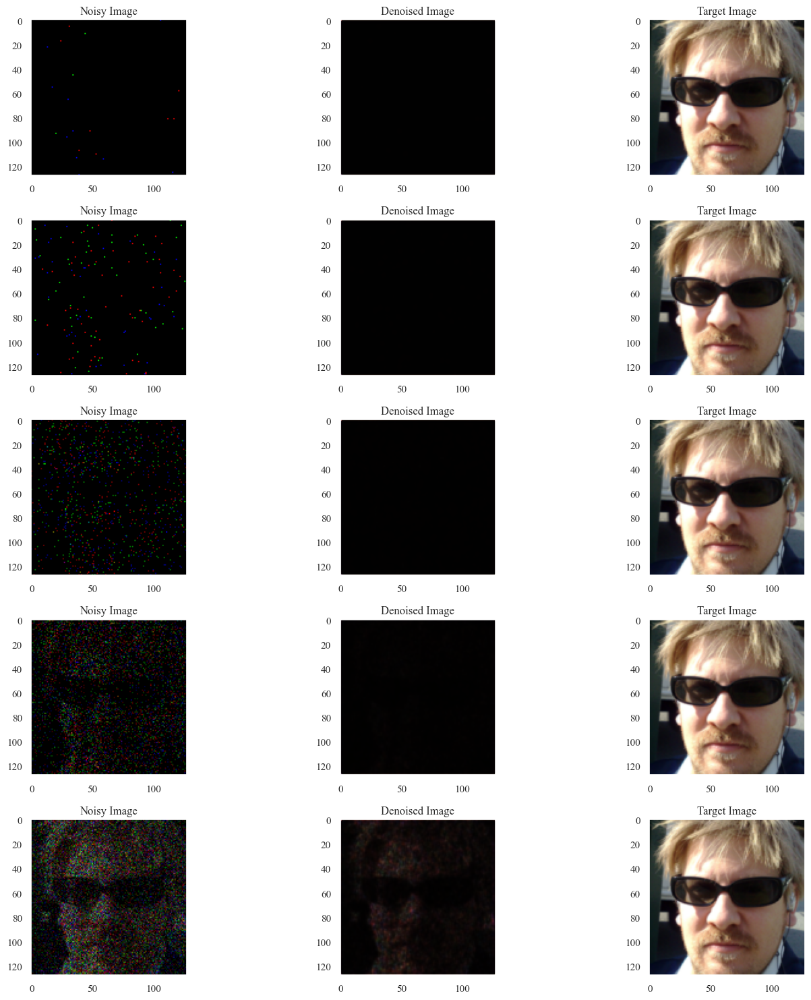

In [29]:
# Plots and visualises the sample Validation Noisy Image, Denoised Image and Target Image across the different noise levels for the Highest PSNR Range.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

1.8706633 0.07893094 1.8311978578567505 1.0418883562088013
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 24.642314910888672
24.642454558616635 24.64245501369784 0.0


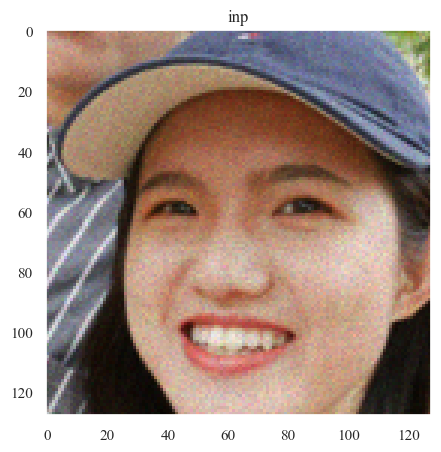

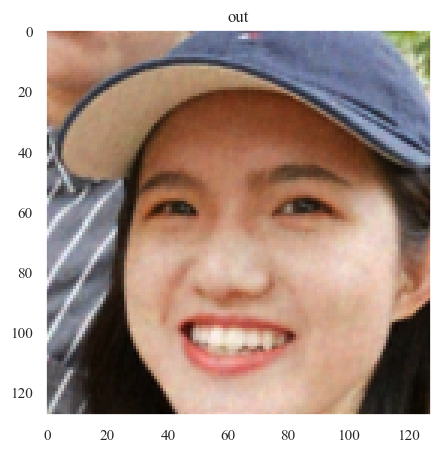

Text(0.5, 1.0, 'GT')

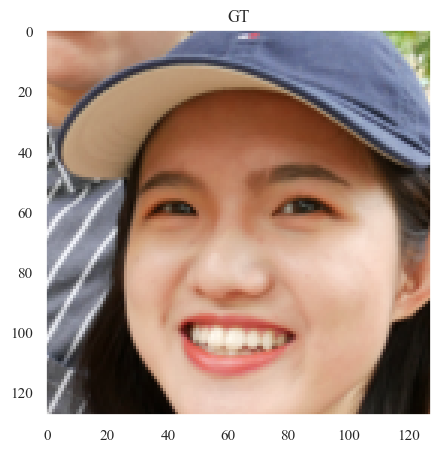

In [30]:
# Generates a smaple image from the dataset, denoises it and evaluates the visual quality of the denoised image
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

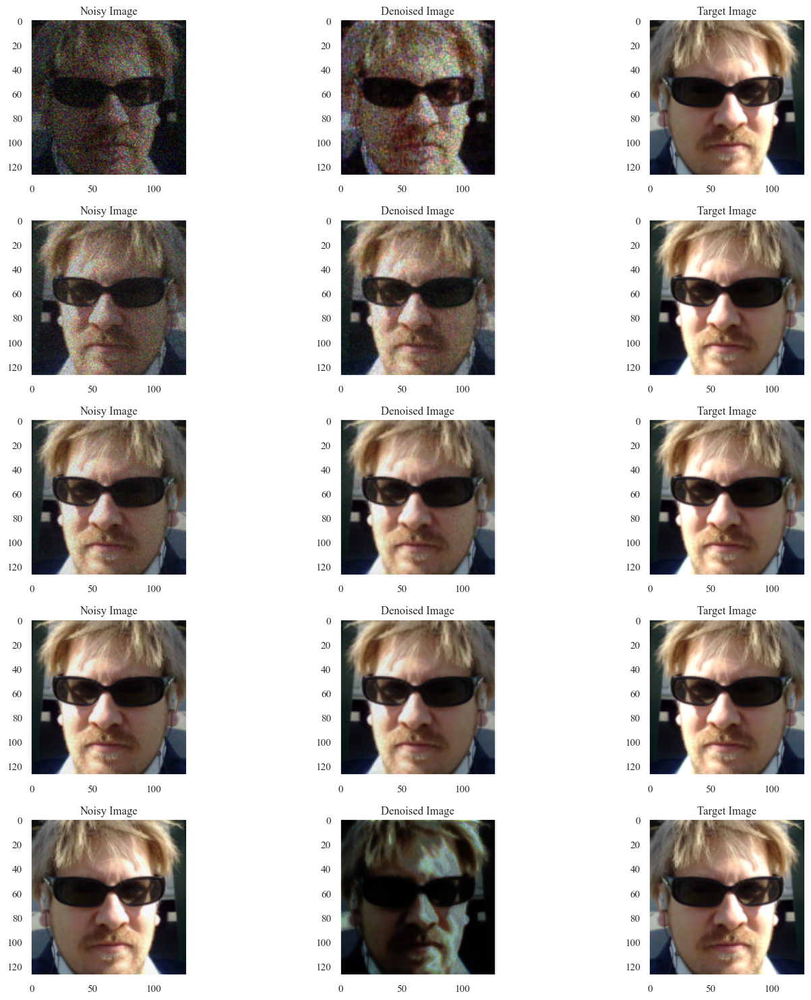

In [31]:
# continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [22]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_2 = np.array(Psnr_Distribution)
SSIM_Distribution_2 = np.array(SSIM_Distribution)
Perceptual_Distribution_2 = np.array(Perceptual_Distribution)
Psnr_Distribution_2.shape, SSIM_Distribution_2.shape, Perceptual_Distribution_2.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [30]:
# Generates the dataframe for the Psnr
Psnr_Distribution_2 = pd.DataFrame(Psnr_Distribution_2, columns = ["PSNR"])
Psnr_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution_2.shape[0])
Psnr_Distribution_2["PSNR_Average"] = Psnr_Distribution_2["PSNR"].rolling(window = 12).mean()
Psnr_Distribution_2["PSNR_Variance"] = Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2["PSNR_Variance_Upper"] = Psnr_Distribution_2["PSNR_Average"] + Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2["PSNR_Variance_Lower"] = Psnr_Distribution_2["PSNR_Average"] - Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2.dropna(inplace = True)
Psnr_Distribution_2.describe()

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,15.309023,-3.559511,15.098508,1.573481,16.671988,13.525027
std,12.847046,20.564969,12.654149,0.406509,12.713951,12.607177
min,0.072885,-39.119021,3.268055,0.711929,4.463653,1.761109
25%,4.370616,-21.339266,4.312837,1.282565,5.877285,2.895324
50%,8.679818,-3.559511,8.129908,1.504145,9.923594,6.464473
75%,27.280841,14.220245,26.591410,1.907295,28.413225,24.495030
max,42.707022,32.000000,40.028957,2.734805,41.830967,38.226946


In [31]:
# Generates the dataframe for the SSIM
SSIM_Distribution_2 = pd.DataFrame(SSIM_Distribution_2, columns = ["SSIM"])
SSIM_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution_2.shape[0])
SSIM_Distribution_2["SSIM_Average"] = SSIM_Distribution_2["SSIM"].rolling(window = 12).mean()
SSIM_Distribution_2["SSIM_Variance"] = SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2["SSIM_Variance_Upper"] = SSIM_Distribution_2["SSIM_Average"] + SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2["SSIM_Variance_Lower"] = SSIM_Distribution_2["SSIM_Average"] - SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2.dropna(inplace = True)
SSIM_Distribution_2.describe()

,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.479050,-3.559511,0.474578,0.064175,0.538753,0.410403
std,0.279164,20.564969,0.268369,0.030869,0.260634,0.279320
min,0.125353,-39.119021,0.230535,0.003099,0.262149,0.154741
25%,0.252990,-21.339266,0.264450,0.042993,0.326354,0.208523
50%,0.349298,-3.559511,0.312054,0.063226,0.382616,0.252285
75%,0.752588,14.220245,0.724634,0.086358,0.822098,0.642929
max,0.990214,32.000000,0.984580,0.151812,0.993716,0.981374


In [32]:
# Generates the dataframe for the Perceptual Loss
Perceptual_Distribution_2 = pd.DataFrame(Perceptual_Distribution_2, columns = ["1-PL"])
Perceptual_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution_2.shape[0])
Perceptual_Distribution_2["1-PL_Average"] = Perceptual_Distribution_2["1-PL"].rolling(window = 12).mean()
Perceptual_Distribution_2["1-PL_Variance"] = Perceptual_Distribution_2["1-PL"].rolling(window = 12).std()
Perceptual_Distribution_2["1-PL_Variance_Upper"] = Perceptual_Distribution_2["1-PL_Average"] + Perceptual_Distribution_2["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_2["1-PL_Variance_Lower"] = Perceptual_Distribution_2["1-PL_Average"] - Perceptual_Distribution_2["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_2.dropna(inplace = True)
Perceptual_Distribution_2.describe()

,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.380334,-3.119021,0.376671,0.059863,0.386228,0.367114
std,0.234896,20.310653,0.224821,0.032495,0.228676,0.221134
min,-0.051564,-38.238042,0.104692,0.011073,0.106856,0.100934
25%,0.147896,-20.678532,0.135559,0.027887,0.139594,0.131706
50%,0.354267,-3.119021,0.385508,0.054765,0.391524,0.379276
75%,0.592686,14.440489,0.608242,0.085103,0.619489,0.589513
max,0.872927,32.000000,0.765393,0.146431,0.781813,0.754410


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

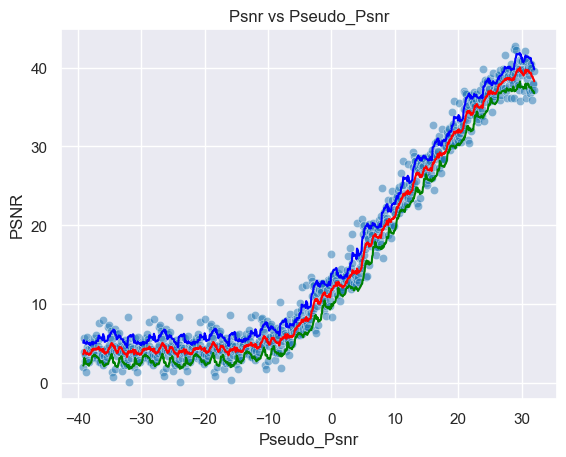

In [41]:
# Generates the plots for the Psnr
plt.Figure(figsize=(10,10))
sns.set_style("darkgrid")
sns.scatterplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
Psnr_Area_2 = np.trapz(Psnr_Distribution_2["PSNR_Average"].values, Psnr_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("PSNR")
plt.title("Psnr vs Pseudo_Psnr")
plt.show()

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

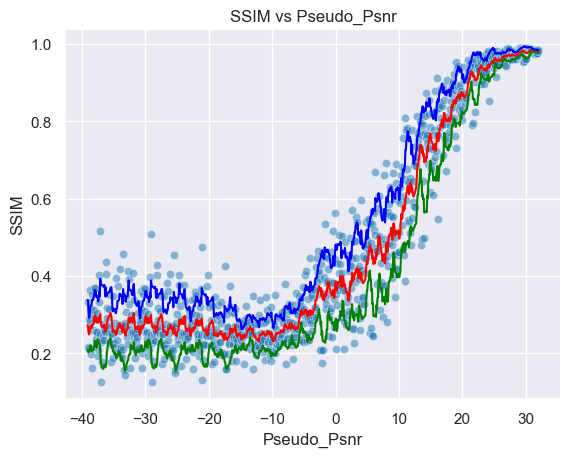

In [42]:
# Generates the plots for the SSIM
plt.Figure(figsize=(10,10))
sns.set_style("darkgrid")
sns.scatterplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
SSIM_Area_2 = np.trapz(SSIM_Distribution_2["SSIM_Average"].values, SSIM_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("SSIM")
plt.title("SSIM vs Pseudo_Psnr")
plt.show()

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

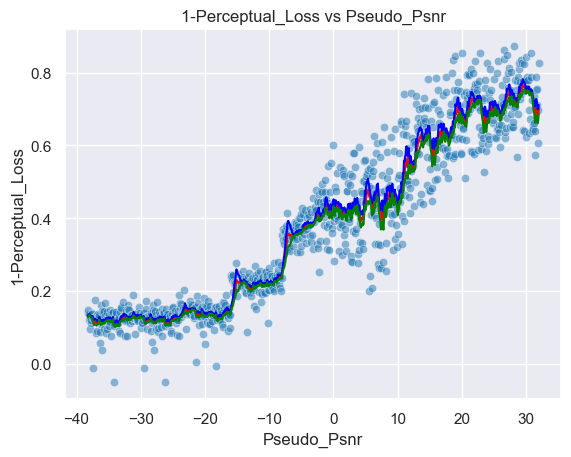

In [43]:
# Generates the plots for the Perceptual Loss
plt.Figure(figsize=(10,10))
sns.scatterplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red")
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
Perceptual_Area_2 = np.trapz(Perceptual_Distribution_2["1-PL_Average"].values, Perceptual_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("1-Perceptual_Loss")
plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
plt.show()

In [44]:
# Prints the Areas under the curve for the Psnr, SSIM and Perceptual Loss.
print(Psnr_Area_2), print(SSIM_Area_2), print(Perceptual_Area_2)

1073.3225725066152
33.73936939057174
26.453612165403314


(None, None, None)

In [45]:
# Generates the summary statistics for the Psnr
print("Mean Psnr",Psnr_Distribution_2["PSNR"].mean())
print("Std Psnr",Psnr_Distribution_2["PSNR"].std()) 
print("Min Psnr",Psnr_Distribution_2["PSNR"].min()) 
print("Max Psnr",Psnr_Distribution_2["PSNR"].max())
print("Mean Roll Var",Psnr_Distribution_2["PSNR_Variance"].mean())

Mean Psnr 15.309023177870603
Std Psnr 12.847045676927152
Min Psnr 0.0728851471473138
Max Psnr 42.70702244849568
Mean Roll Var 1.5734805180190787


In [46]:
# Generates the summary statistics for the SSIM
print("Mean SSIM",SSIM_Distribution_2["SSIM"].mean())
print("Std SSIM",SSIM_Distribution_2["SSIM"].std()) 
print("Min SSIM",SSIM_Distribution_2["SSIM"].min()) 
print("Max SSIM",SSIM_Distribution_2["SSIM"].max())
print("Mean Roll SSIM",SSIM_Distribution_2["SSIM_Variance"].mean())

Mean SSIM 0.4790502
Std SSIM 0.2791635990142822
Min SSIM 0.12535303831100464
Max SSIM 0.9902143478393555
Mean Roll SSIM 0.06417542498013469


In [47]:
# Generates the summary statistics for the Perceptual Loss
print("Mean 1-PL",Perceptual_Distribution_2["1-PL"].mean())
print("Std 1-PL",Perceptual_Distribution_2["1-PL"].std()) 
print("Min 1-PL",Perceptual_Distribution_2["1-PL"].min()) 
print("Max 1-PL",Perceptual_Distribution_2["1-PL"].max())
print("Mean Roll 1-PL",Perceptual_Distribution_2["1-PL_Variance"].mean())

Mean 1-PL 0.38033426
Std 1-PL 0.2348962128162384
Min 1-PL -0.05156397819519043
Max 1-PL 0.8729273080825806
Mean Roll 1-PL 0.059862767122001


In [23]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Second Highest PSNR Range
print(PSNR_Ranges[-2][0], PSNR_Ranges[-2][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-2][0] , maxPSNR = PSNR_Ranges[-2][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-2][0], maxPSNR = PSNR_Ranges[-2][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

16 24


(16384, 4096)

In [15]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [24]:
# Creates the directory to save the model in for the Second Highest PSNR Range.
name = "FaceGenerationUNet128x128-16-24"
CHECKPOINT_PATH = "./models/" 

In [17]:
# Trains the model using the Pytorch Lightning Trainer for the Second Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [18]:
# Validations the trained model on the Train Set for the Second Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16867320239543915    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16867320239543915}]

In [19]:
# Validates the trained model on the Validation Set for the Second Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16841018199920654    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16841018199920654}]

In [25]:
# Loads the model from the checkpoint for the Second Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

2.131276 0.008663723 2.0606579689979725 0.9443458914756775
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 25.161712646484375
25.16109718251166 25.16109718251166 0.0


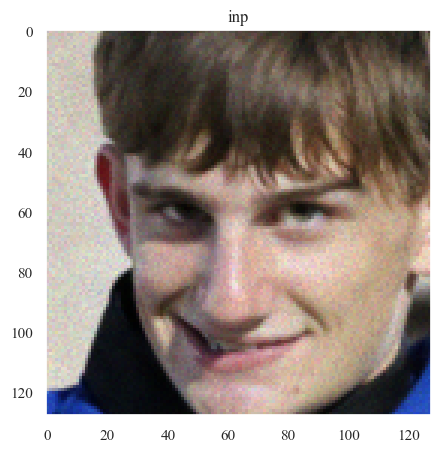

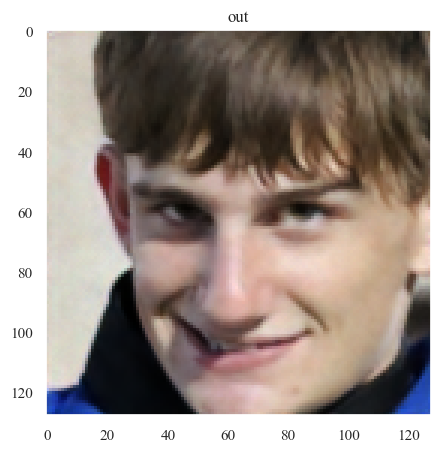

Text(0.5, 1.0, 'GT')

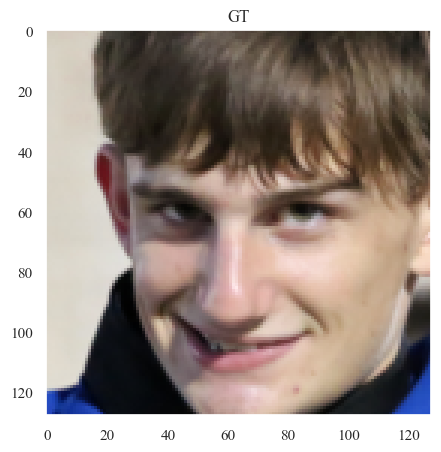

In [24]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

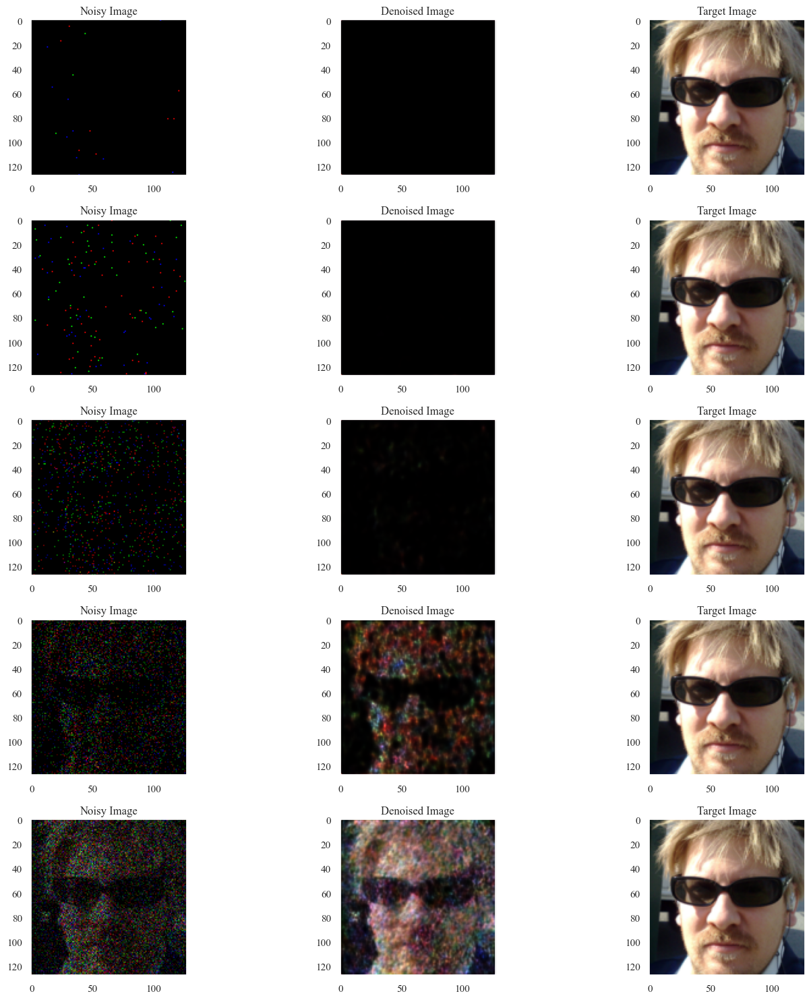

In [23]:
# Plots for a sample image the Noisy Image, its corresponding denoised image 
# and the target image for the Second Highest PSNR Range.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

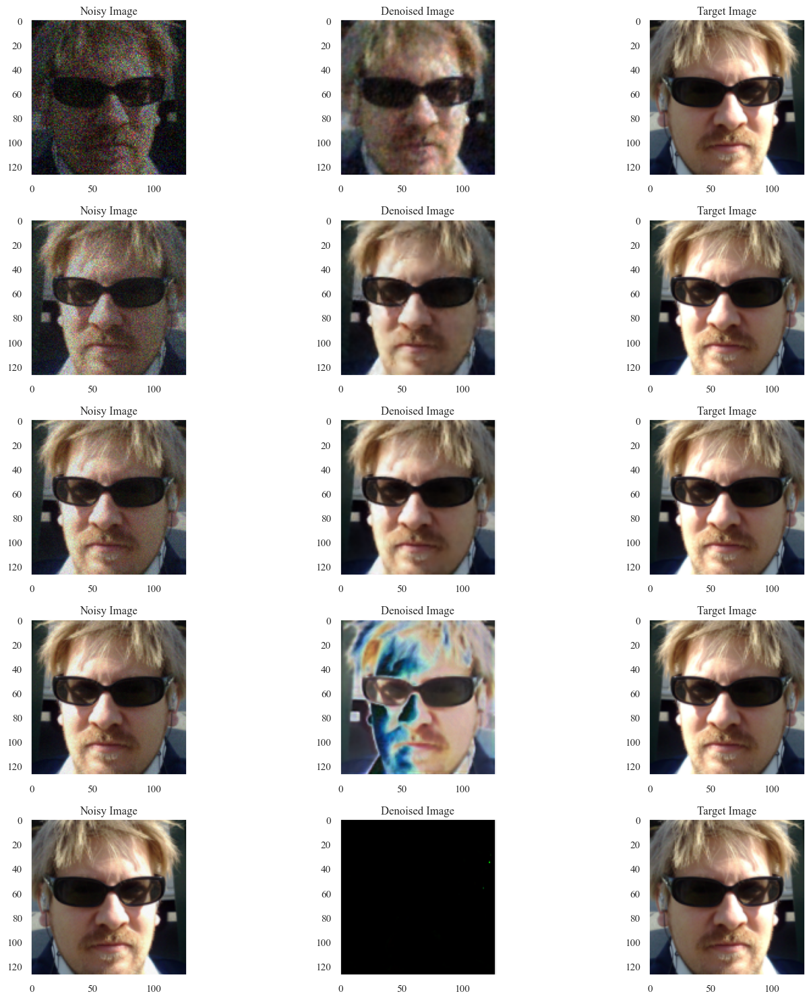

In [25]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [26]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Second Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_3 = np.array(Psnr_Distribution)
SSIM_Distribution_3 = np.array(SSIM_Distribution)
Perceptual_Distribution_3 = np.array(Perceptual_Distribution)
Psnr_Distribution_3.shape, SSIM_Distribution_3.shape, Perceptual_Distribution_3.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,12.931983,-3.554054,12.790400,1.756284,14.546684,11.034115
std,16.917700,20.562248,16.923917,0.721776,16.866714,17.011578
min,-14.937804,-39.108108,-11.637495,0.735076,-10.223100,-13.323552
25%,-5.530537,-21.331081,-5.774709,1.297977,-3.607940,-7.660372
50%,14.574055,-3.554054,14.506804,1.627807,17.079872,12.631470
75%,28.615897,14.222973,28.733160,2.039835,30.664438,27.322457
max,38.696890,32.000000,36.730201,5.590065,37.975717,35.703383


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.465766,-3.554054,0.464264,0.051161,0.515426,0.413103
std,0.348237,20.562248,0.343883,0.033648,0.340939,0.350052
min,0.043186,-39.108108,0.098326,0.005889,0.126202,0.059423
25%,0.140354,-21.331081,0.138573,0.024723,0.176873,0.101362
50%,0.319436,-3.554054,0.307675,0.042384,0.413085,0.205428
75%,0.861913,14.222973,0.842416,0.072410,0.901874,0.793660
max,0.980673,32.000000,0.969853,0.207008,0.981930,0.963964


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.423034,-3.119021,0.420520,0.059310,0.430441,0.410600
std,0.240632,20.310653,0.233173,0.028253,0.236474,0.229993
min,-0.050689,-38.238042,0.105457,0.010840,0.107617,0.101731
25%,0.193885,-20.678532,0.185923,0.033015,0.190383,0.181268
50%,0.362672,-3.119021,0.335457,0.060641,0.345861,0.323831
75%,0.649643,14.440489,0.679706,0.081136,0.696705,0.661246
max,0.868588,32.000000,0.762579,0.145072,0.776889,0.752534


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

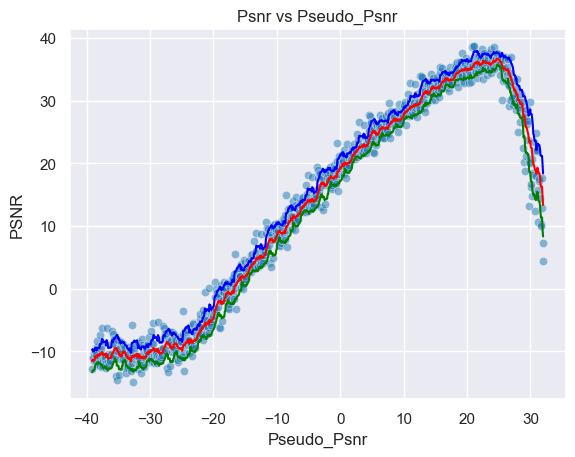

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

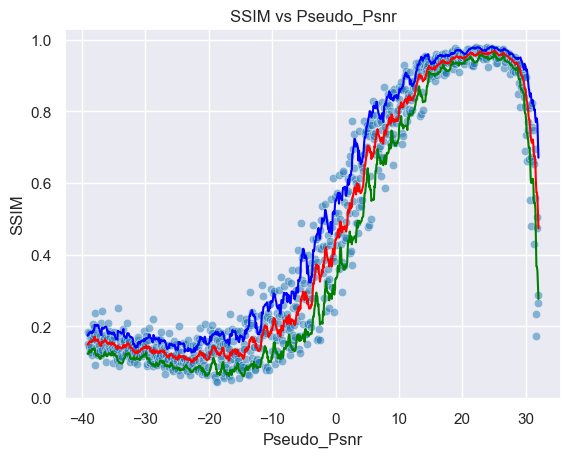

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

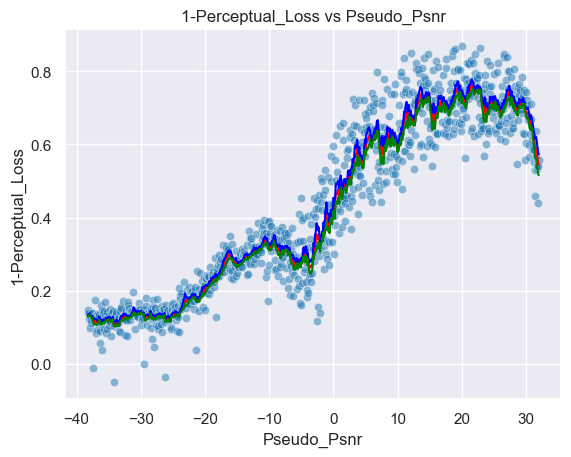

Psnr Area: 910.4644113584911, SSIM Area: 33.025413941289926, Perceptual Area: 29.543170545801303
Mean Psnr 12.931982725150188
Std Psnr 16.917700482876985
Min Psnr -14.937803825288754
Max Psnr 38.69688986455843
Mean Roll Var 1.7562840542891363
Mean SSIM 0.46576646
Std SSIM 0.3482374846935272
Min SSIM 0.0431855209171772
Max SSIM 0.9806734919548035
Mean Roll SSIM 0.05116147415271161
Mean 1-PL 0.423034
Std 1-PL 0.24063187837600708
Min 1-PL -0.0506892204284668
Max 1-PL 0.8685884475708008
Mean Roll 1-PL 0.05931012395295445


(910.4644113584911, 33.025413941289926, 29.543170545801303)

In [34]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Second Highest PSNR Range.
Plot_Creater(Psnr_Distribution_3, SSIM_Distribution_3, Perceptual_Distribution_3, minpsnr, maxpsnr)

In [27]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Third Highest PSNR Range
print(PSNR_Ranges[-3][0], PSNR_Ranges[-3][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-3][0] , maxPSNR = PSNR_Ranges[-3][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-3][0], maxPSNR = PSNR_Ranges[-3][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

8 16


(16384, 4096)

In [36]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [28]:
# Creates the directory to save the model in for the Third Highest PSNR Range.
name = "FaceGenerationUNet128x128-8-16"
CHECKPOINT_PATH = "./models/" 

In [42]:
# Trains the model using the Pytorch Lightning Trainer for the Third Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
# Trains the model using the Pytorch Lightning Trainer for the Third Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

In [29]:
# Loads the model from the checkpoint for the Third Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [43]:
# Validates the trained model on the Train Set for the Third Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16894006729125977    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16894006729125977}]

In [44]:
# Validates the trained model on the Validation Set for the Third Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1725340485572815    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1725340485572815}]

1.7494212 0.117116064 1.6908632516860962 0.9954865574836731
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 9.801837921142578
9.801628627443833 9.801628627443833 0.0


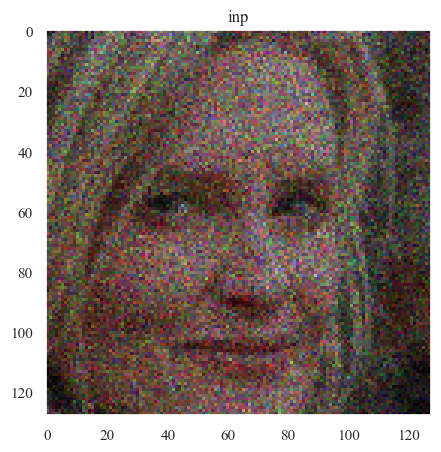

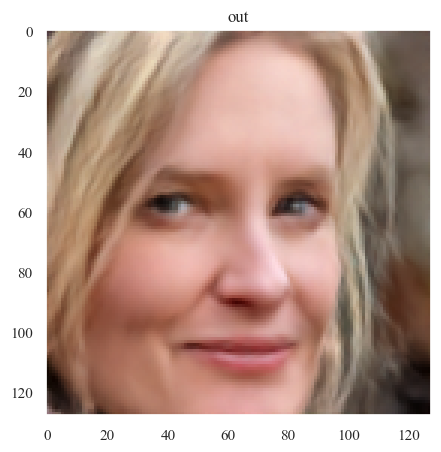

Text(0.5, 1.0, 'GT')

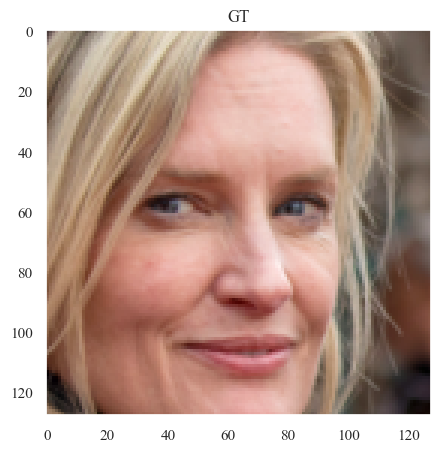

In [51]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

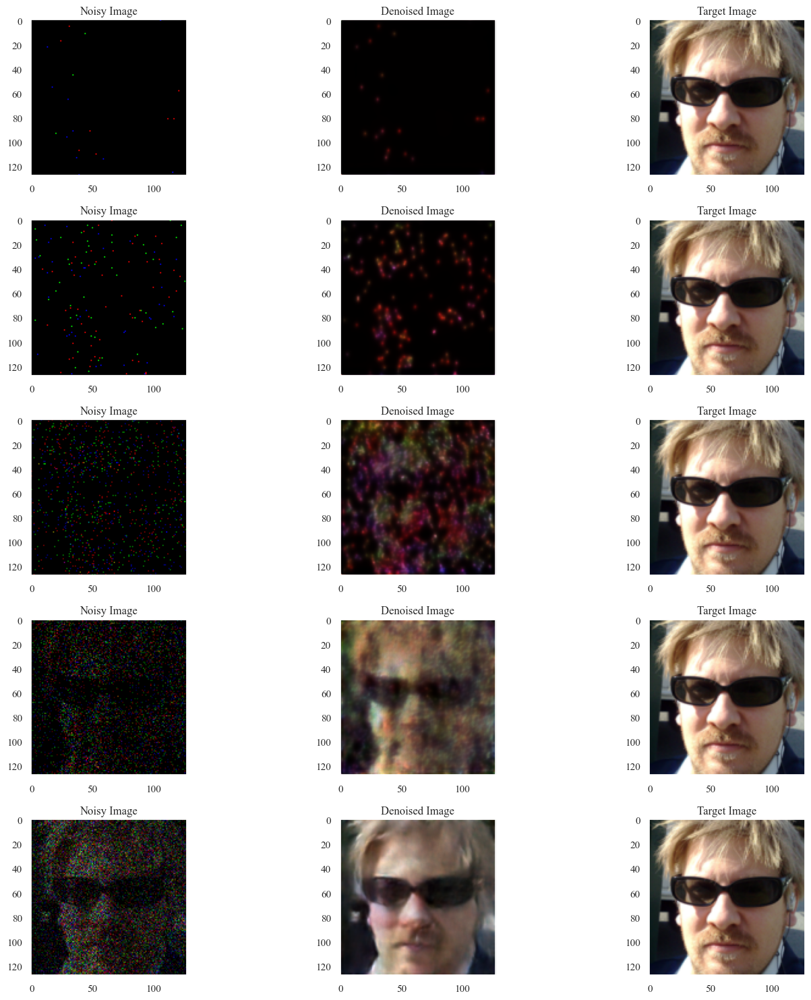

In [52]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

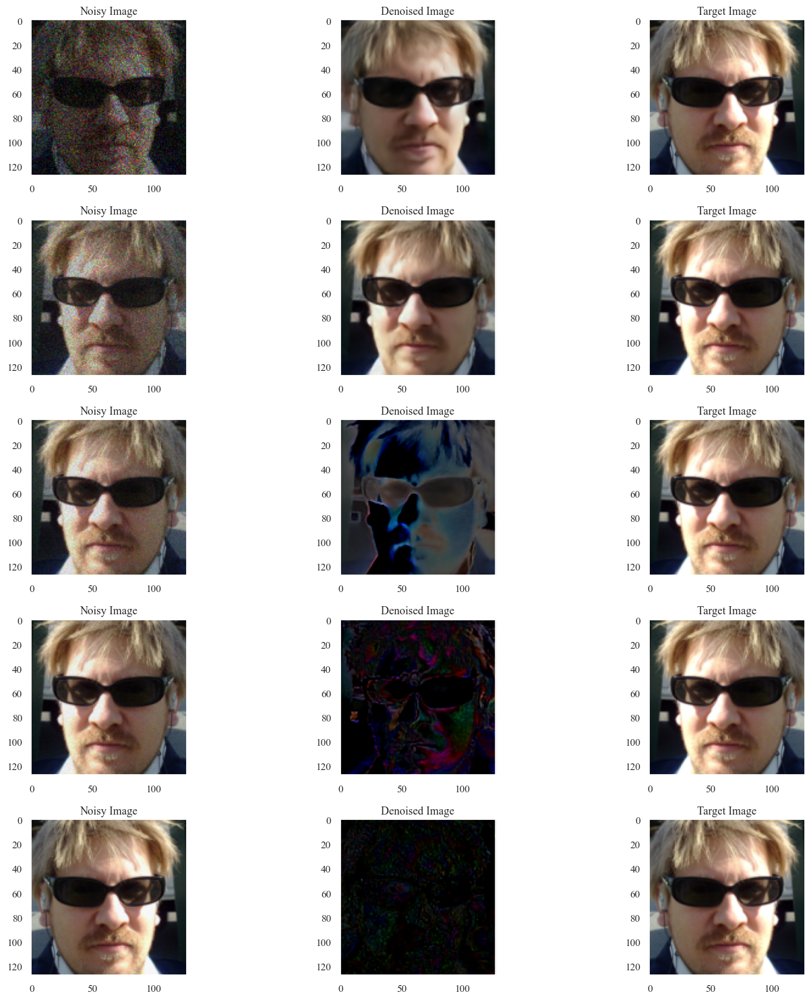

In [53]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [30]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Third Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_4 = np.array(Psnr_Distribution)
SSIM_Distribution_4 = np.array(SSIM_Distribution)
Perceptual_Distribution_4 = np.array(Perceptual_Distribution)
Psnr_Distribution_4.shape, SSIM_Distribution_4.shape, Perceptual_Distribution_4.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,13.636555,-3.559511,13.588417,1.836155,15.424572,11.752262
std,12.870084,20.564969,12.765218,0.960156,12.647046,12.953671
min,-7.116517,-39.119021,-4.073668,0.540681,-2.578315,-5.690109
25%,1.922286,-21.339266,1.377049,1.277914,4.108114,-0.969384
50%,12.683971,-3.559511,12.274750,1.579142,15.044316,9.901687
75%,25.682162,14.220245,25.870219,2.017643,27.625119,23.783365
max,35.597940,32.000000,33.925830,6.204620,35.983493,33.025732


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.402631,-3.559511,0.403553,0.048697,0.452251,0.354856
std,0.355434,20.564969,0.349985,0.034754,0.349449,0.353948
min,-0.340186,-39.119021,-0.094154,0.009246,-0.028233,-0.190624
25%,0.094057,-21.339266,0.097568,0.025980,0.134108,0.057312
50%,0.237348,-3.559511,0.236047,0.039508,0.324441,0.164175
75%,0.793052,14.220245,0.793702,0.062212,0.847436,0.736977
max,0.962680,32.000000,0.947322,0.255715,0.973632,0.937397


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.440248,-3.119021,0.438996,0.048603,0.448192,0.429800
std,0.263875,20.310653,0.259807,0.022626,0.263109,0.256668
min,-0.047958,-38.238042,0.107304,0.012980,0.109375,0.103062
25%,0.200776,-20.678532,0.202939,0.029140,0.208174,0.198037
50%,0.388756,-3.119021,0.418310,0.045356,0.424499,0.401986
75%,0.702864,14.440489,0.723887,0.064206,0.736845,0.713986
max,0.930895,32.000000,0.864432,0.141191,0.880079,0.859392


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

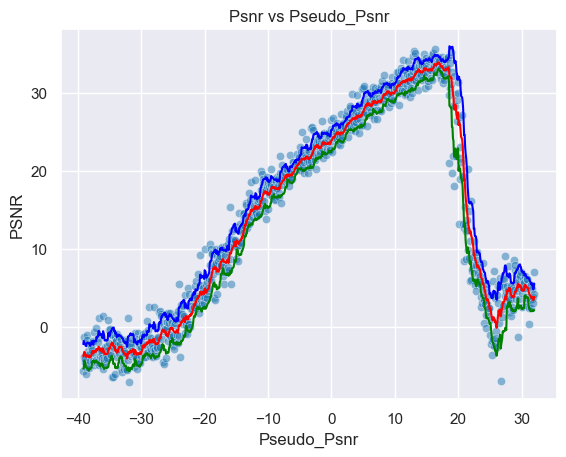

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

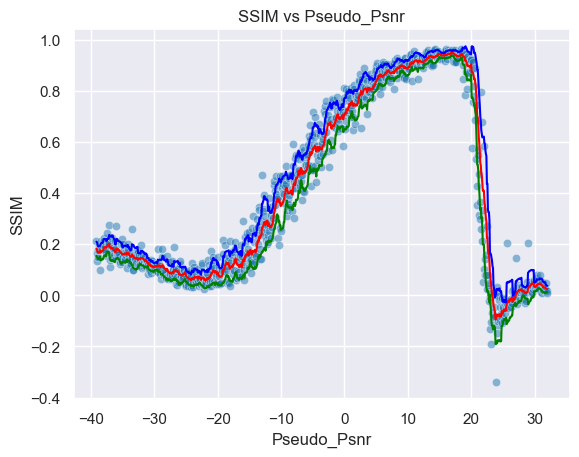

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

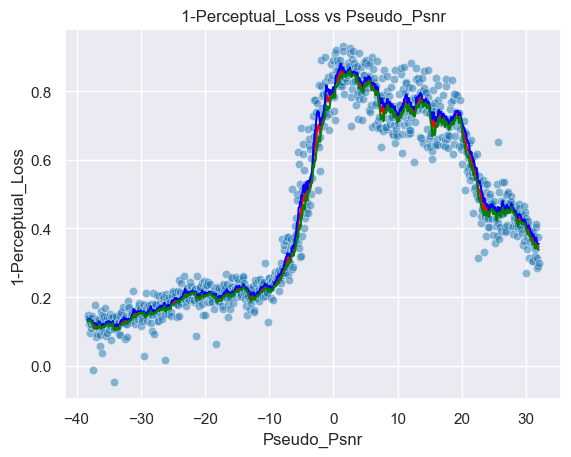

Psnr Area: 967.4823667523874, SSIM Area: 28.72439254783933, Perceptual Area: 30.850255272213424
Mean Psnr 13.636555312764543
Std Psnr 12.870084428546582
Min Psnr -7.1165165513354065
Max Psnr 35.597940145174114
Mean Roll Var 1.8361551608021445
Mean SSIM 0.40263128
Std SSIM 0.355433851480484
Min SSIM -0.34018567204475403
Max SSIM 0.9626795649528503
Mean Roll SSIM 0.0486971869885045
Mean 1-PL 0.44024763
Std 1-PL 0.2638750374317169
Min 1-PL -0.047957539558410645
Max 1-PL 0.9308950901031494
Mean Roll 1-PL 0.04860346282570918


(967.4823667523874, 28.72439254783933, 30.850255272213424)

In [54]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Third Highest PSNR Range.
Plot_Creater(Psnr_Distribution_4, SSIM_Distribution_4, Perceptual_Distribution_4, minpsnr, maxpsnr)

In [31]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Fourth Highest PSNR Range
print(PSNR_Ranges[-4][0], PSNR_Ranges[-4][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-4][0] , maxPSNR = PSNR_Ranges[-4][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-4][0], maxPSNR = PSNR_Ranges[-4][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

0 8


(16384, 4096)

In [106]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

In [32]:
# Creates the directory to save the model in for the Fourth Highest PSNR Range.
name = "FaceGenerationUNet128x128-0-8"
CHECKPOINT_PATH = "./models/" 

In [108]:
# Trains the model using the Pytorch Lightning Trainer for the Fourth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [109]:
# Trains the model using the Pytorch Lightning Trainer for the Fourth Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [33]:
# Loads the model from the checkpoint for the Fourth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [111]:
# Validates the trained model on the Train Set for the Fourth Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16516909003257751    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16516909003257751}]

In [112]:
# Validates the trained model on the Validation Set for the Fourth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1671794056892395    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1671794056892395}]

1.4115704 0.07253128 1.411570429801941 1.0154379606246948
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 0.27474498748779297
0.2758285815430137 0.27582809568253114 0.0


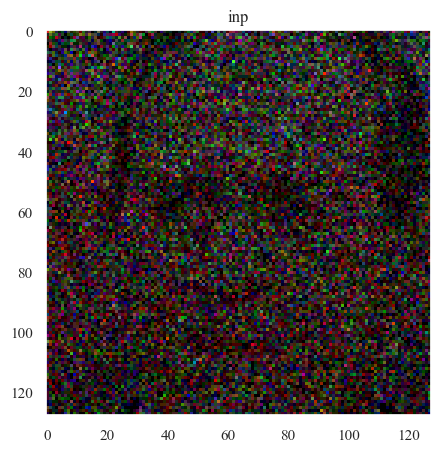

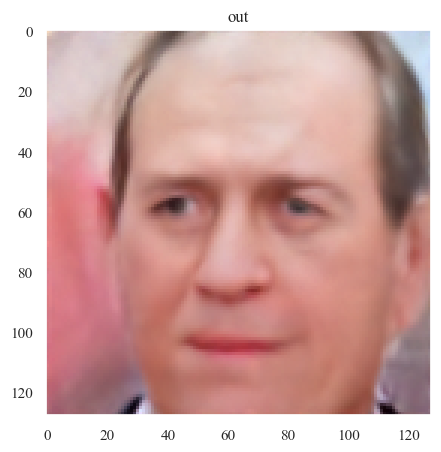

Text(0.5, 1.0, 'GT')

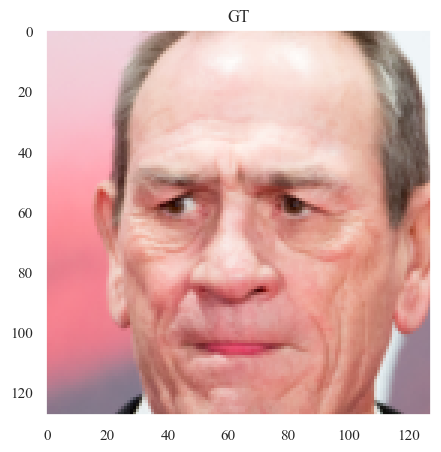

In [34]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

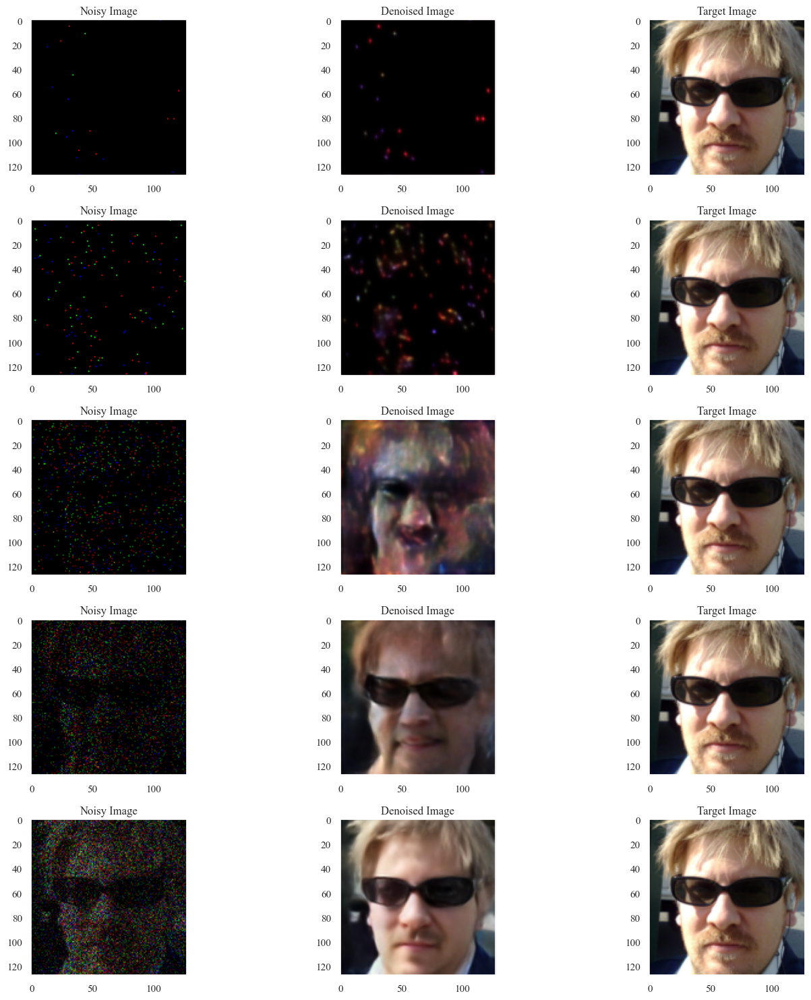

In [35]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

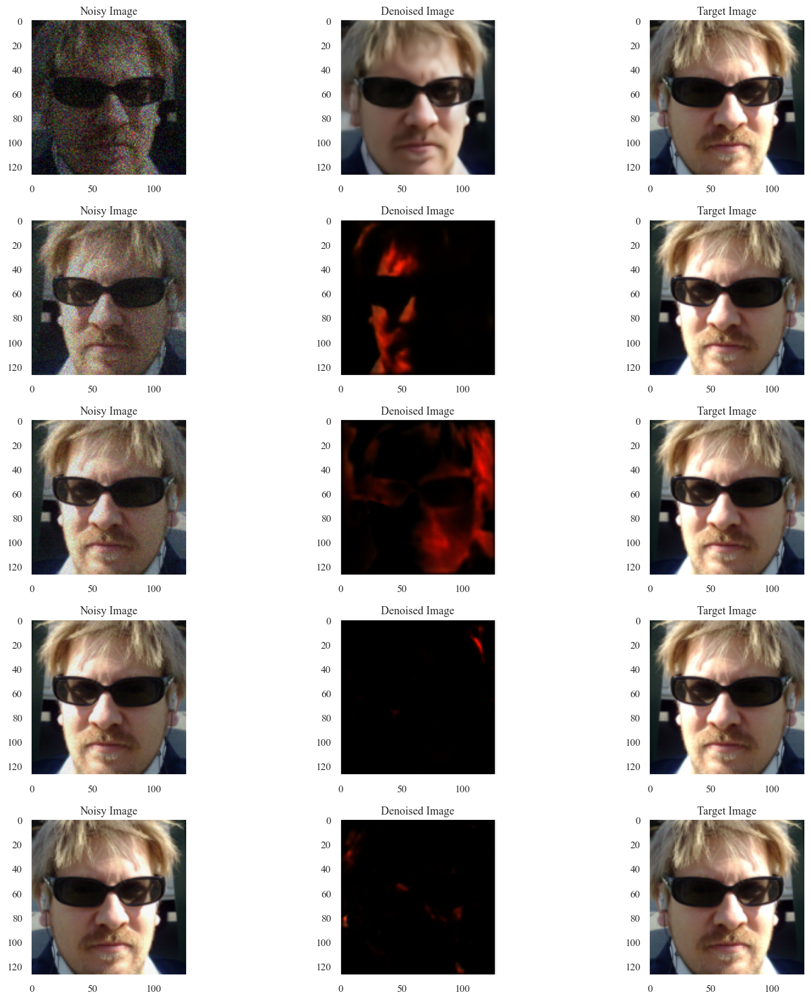

In [36]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [37]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Fourth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_5 = np.array(Psnr_Distribution)
SSIM_Distribution_5 = np.array(SSIM_Distribution)
Perceptual_Distribution_5 = np.array(Perceptual_Distribution)
Psnr_Distribution_5.shape, SSIM_Distribution_5.shape, Perceptual_Distribution_5.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,8.461476,-3.559511,8.479389,1.986904,10.466292,6.492485
std,14.027737,20.564969,13.842232,0.992116,13.541249,14.206265
min,-20.570462,-39.119021,-11.455079,0.446978,-8.851824,-16.309626
25%,-4.410307,-21.339266,-4.864062,1.347808,-2.814118,-6.752263
50%,6.237432,-3.559511,5.945548,1.697703,8.641850,3.622072
75%,22.101314,14.220245,22.110510,2.245118,24.097892,20.711753
max,32.305718,32.000000,30.204886,5.677395,31.534803,29.296609


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.359921,-3.559511,0.360487,0.044761,0.405248,0.315726
std,0.323416,20.564969,0.319465,0.020510,0.323964,0.316234
min,-0.084939,-39.119021,-0.027834,0.007578,0.013402,-0.084228
25%,0.079697,-21.339266,0.071322,0.026238,0.112233,0.047057
50%,0.197605,-3.559511,0.176941,0.042289,0.234801,0.141299
75%,0.690790,14.220245,0.697128,0.058046,0.761196,0.628716
max,0.930207,32.000000,0.902775,0.110470,0.934229,0.882312


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.422726,-3.119021,0.420988,0.044565,0.430862,0.411114
std,0.258797,20.310653,0.255679,0.017811,0.259082,0.252467
min,-0.033840,-38.238042,0.117300,0.011241,0.120377,0.113366
25%,0.180421,-20.678532,0.174578,0.031155,0.179604,0.170035
50%,0.392086,-3.119021,0.405881,0.043460,0.414428,0.398152
75%,0.621422,14.440489,0.631103,0.053758,0.662028,0.597964
max,0.941172,32.000000,0.894123,0.109300,0.901272,0.887591


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

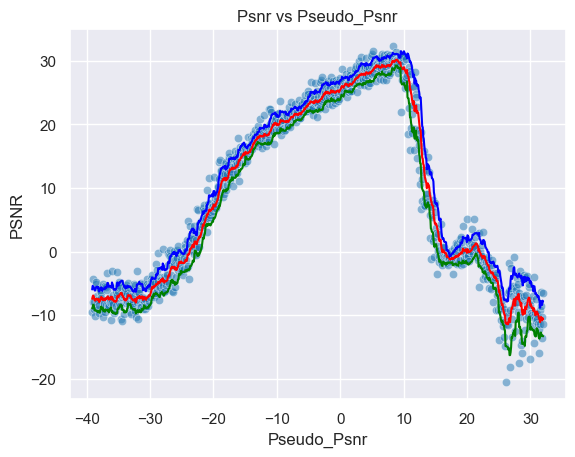

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

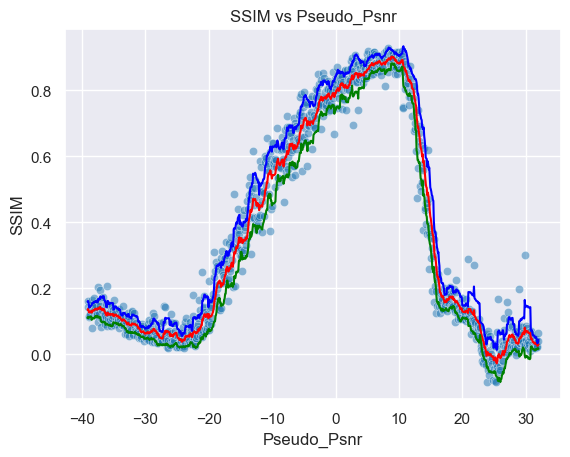

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

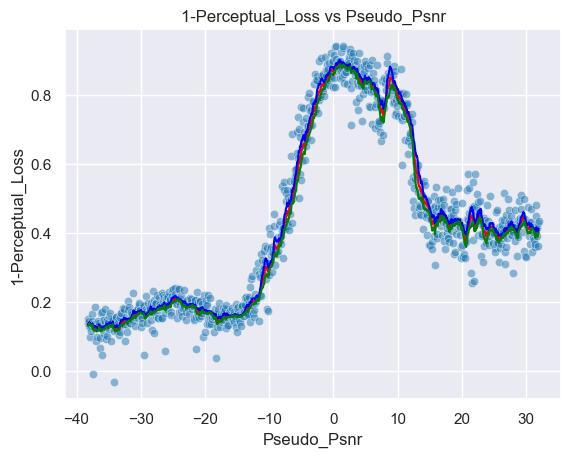

Psnr Area: 604.4479904095907, SSIM Area: 25.659761515979426, Perceptual Area: 29.581494576342248
Mean Psnr 8.461476379700136
Std Psnr 14.027736864055806
Min Psnr -20.570462376667933
Max Psnr 32.30571815110922
Mean Roll Var 1.9869035305027707
Mean SSIM 0.35992062
Std SSIM 0.3234157860279083
Min SSIM -0.08493881672620773
Max SSIM 0.9302074909210205
Mean Roll SSIM 0.04476101686550996
Mean 1-PL 0.422726
Std 1-PL 0.2587966024875641
Min 1-PL -0.03383958339691162
Max 1-PL 0.9411723017692566
Mean Roll 1-PL 0.0445648884966328


(604.4479904095907, 25.659761515979426, 29.581494576342248)

In [117]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Fourth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_5, SSIM_Distribution_5, Perceptual_Distribution_5, minpsnr, maxpsnr)

In [38]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Fifth Highest PSNR Range
print(PSNR_Ranges[-5][0], PSNR_Ranges[-5][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-5][0] , maxPSNR = PSNR_Ranges[-5][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-5][0], maxPSNR = PSNR_Ranges[-5][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-8 0


(16384, 4096)

In [75]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [39]:
# Creates the directory to save the model in for the Fifth Highest PSNR Range.
name = "FaceGenerationUNet128x128-m8-0"
CHECKPOINT_PATH = "./models/" 

In [77]:
# Trains the model using the Pytorch Lightning Trainer for the Fifth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
# Trains the model using the Pytorch Lightning Trainer for the Fifth Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

In [40]:
# Loads the model from the checkpoint for the Fifth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [79]:
# Validates the trained model on the Train Set for the Fifth Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.15781211853027344    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.15781211853027344}]

In [80]:
# Validates the trained model on the Validation Set for the Fifth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16271597146987915    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16271597146987915}]

2.131276 0.008663723 2.0606579689979725 0.9443458914756775
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -2.4635567665100098
-2.497047043665343 -2.497047043665343 0.0


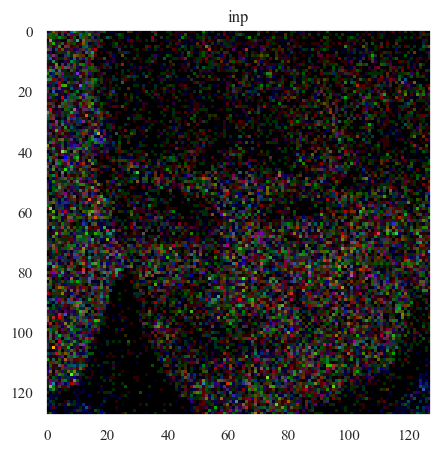

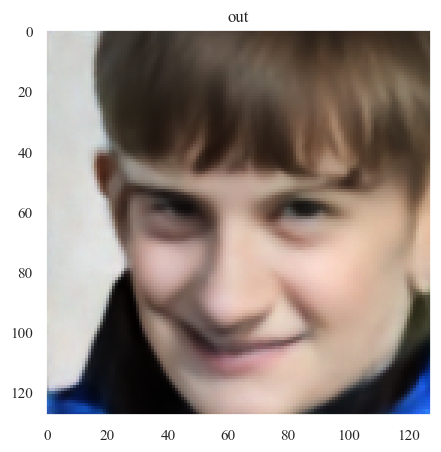

Text(0.5, 1.0, 'GT')

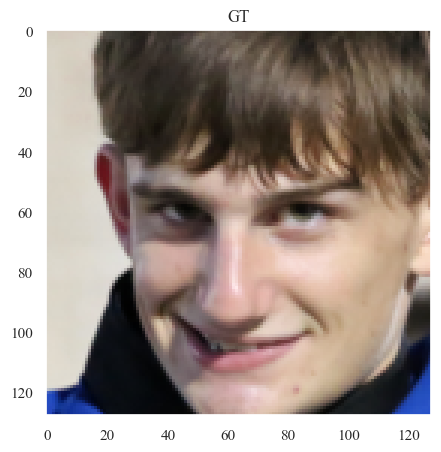

In [41]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

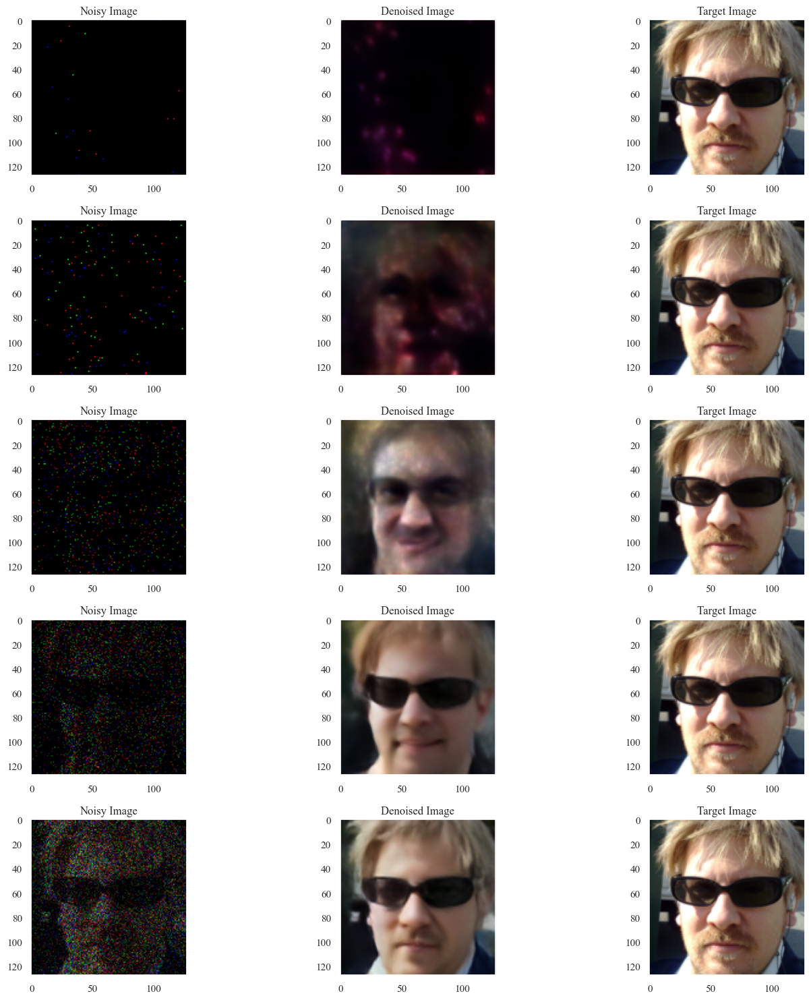

In [42]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

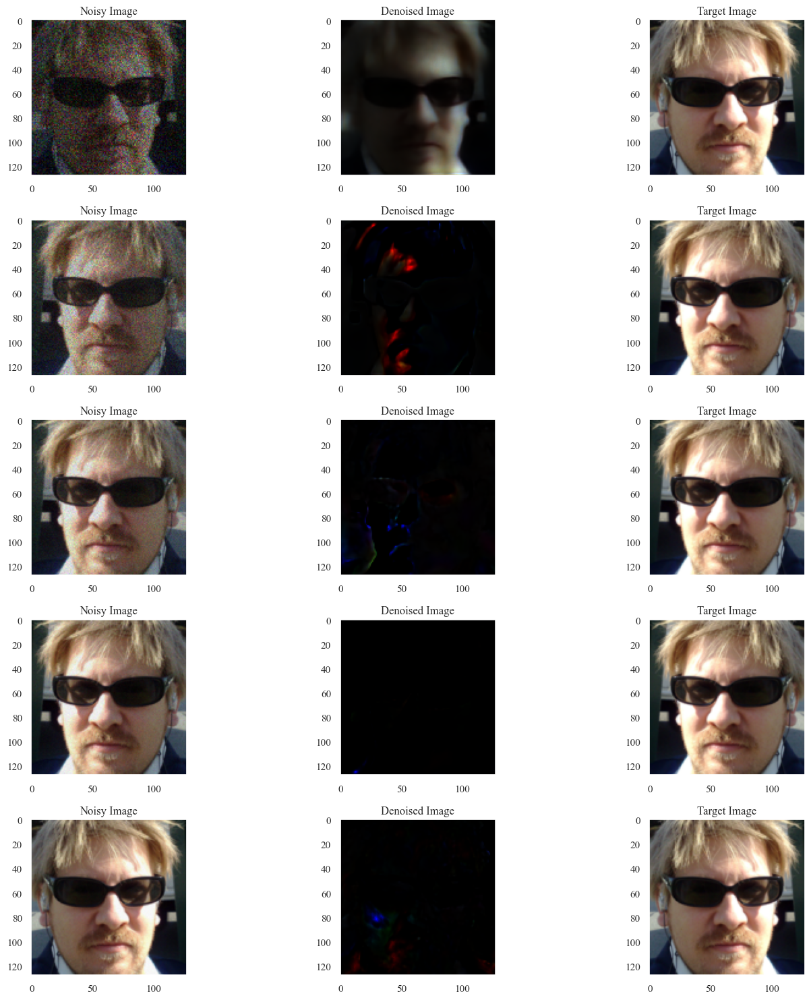

In [43]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [44]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Fifth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_6 = np.array(Psnr_Distribution)
SSIM_Distribution_6 = np.array(SSIM_Distribution)
Perceptual_Distribution_6 = np.array(Perceptual_Distribution)
Psnr_Distribution_6.shape, SSIM_Distribution_6.shape, Perceptual_Distribution_6.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,10.315009,-3.559511,10.333674,2.325283,12.658957,8.008391
std,10.817523,20.564969,10.487882,1.240564,9.705116,11.352536
min,-21.620141,-39.119021,-9.075037,0.555920,-4.147139,-14.861148
25%,1.341888,-21.339266,0.874362,1.402629,3.151565,-1.288069
50%,11.291150,-3.559511,11.567294,1.906282,13.555843,9.349992
75%,19.861467,14.220245,20.110948,3.079641,21.812024,18.598146
max,29.103983,32.000000,26.687819,6.220405,28.057998,25.512380


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.351144,-3.559511,0.351539,0.049989,0.401528,0.301550
std,0.292890,20.564969,0.287853,0.021340,0.289202,0.288083
min,-0.104770,-39.119021,-0.041131,0.011357,-0.013146,-0.086508
25%,0.090285,-21.339266,0.100948,0.033408,0.133960,0.057191
50%,0.272638,-3.559511,0.277709,0.047347,0.324580,0.217575
75%,0.630769,14.220245,0.652741,0.062126,0.705151,0.597547
max,0.875559,32.000000,0.826107,0.146420,0.874850,0.795453


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.380249,-3.119021,0.378518,0.043724,0.387369,0.369667
std,0.253699,20.310653,0.250420,0.017004,0.253808,0.247185
min,-0.053935,-38.238042,0.097033,0.010609,0.100516,0.091288
25%,0.131534,-20.678532,0.122188,0.029913,0.125527,0.118853
50%,0.386676,-3.119021,0.405032,0.043033,0.412875,0.396968
75%,0.517833,14.440489,0.529644,0.054245,0.540978,0.503978
max,0.949325,32.000000,0.901397,0.100830,0.909426,0.893367


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

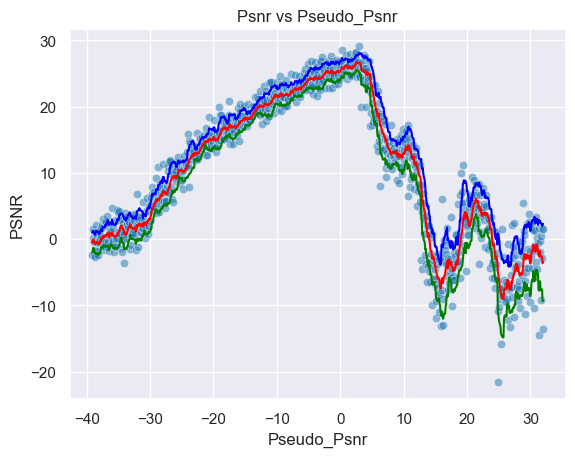

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

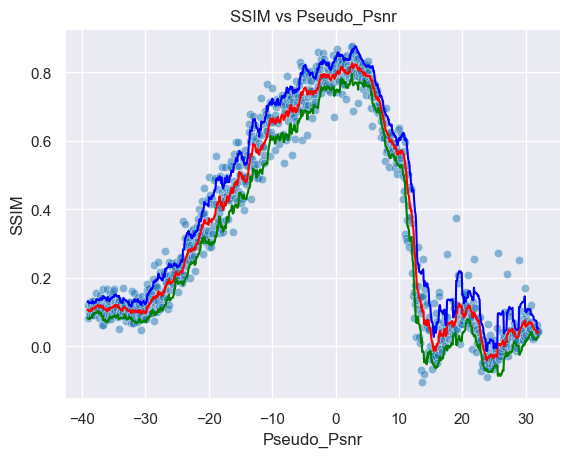

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

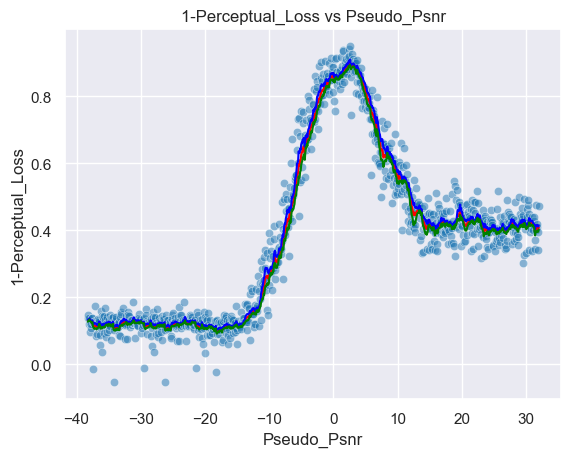

Psnr Area: 735.9115832496456, SSIM Area: 25.023361753484856, Perceptual Area: 26.59515286360487
Mean Psnr 10.315009225086675
Std Psnr 10.817522762660253
Min Psnr -21.620141429180386
Max Psnr 29.103982730371545
Mean Roll Var 2.3252828785963184
Mean SSIM 0.35114378
Std SSIM 0.29289019107818604
Min SSIM -0.10476956516504288
Max SSIM 0.8755587935447693
Mean Roll SSIM 0.04998896223343096
Mean 1-PL 0.38024873
Std 1-PL 0.25369876623153687
Min 1-PL -0.05393481254577637
Max 1-PL 0.9493250250816345
Mean Roll 1-PL 0.04372416304848315


(735.9115832496456, 25.023361753484856, 26.59515286360487)

In [88]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Fifth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_6, SSIM_Distribution_6, Perceptual_Distribution_6, minpsnr, maxpsnr)

In [45]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Sixth Highest PSNR Range
print(PSNR_Ranges[-6][0], PSNR_Ranges[-6][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-6][0] , maxPSNR = PSNR_Ranges[-6][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-6][0], maxPSNR = PSNR_Ranges[-6][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-16 -8


(16384, 4096)

In [90]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [46]:
# Creates the directory to save the model in for the Sixth Highest PSNR Range.
name = "FaceGenerationUNet128x128-m16-m8"
CHECKPOINT_PATH = "./models/" 

In [93]:
# Trains the model using the Pytorch Lightning Trainer for the Sixth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
# Trains the model using the Pytorch Lightning Trainer for the Sixth Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

In [47]:
# Loads the model from the checkpoint for the Sixth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [95]:
# Validates the trained model on the Train Set for the Sixth Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1458033174276352    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1458033174276352}]

In [96]:
# Validates the trained model on the Validation Set for the Sixth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.14946036040782928    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.14946036040782928}]

2.002968 0.08640254 2.0029680728912354 0.9190089106559753
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -14.551651954650879
-14.534950755645049 -14.534951215308032 0.0


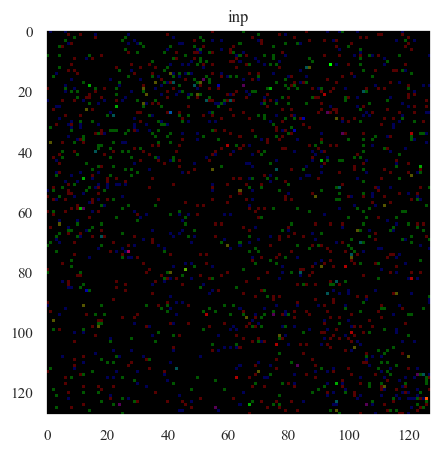

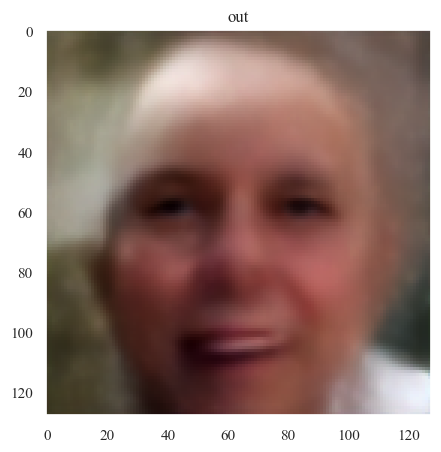

Text(0.5, 1.0, 'GT')

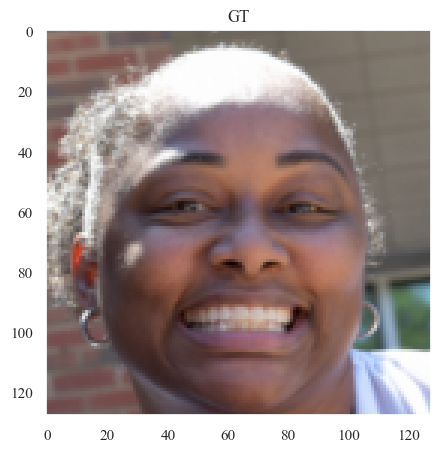

In [48]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

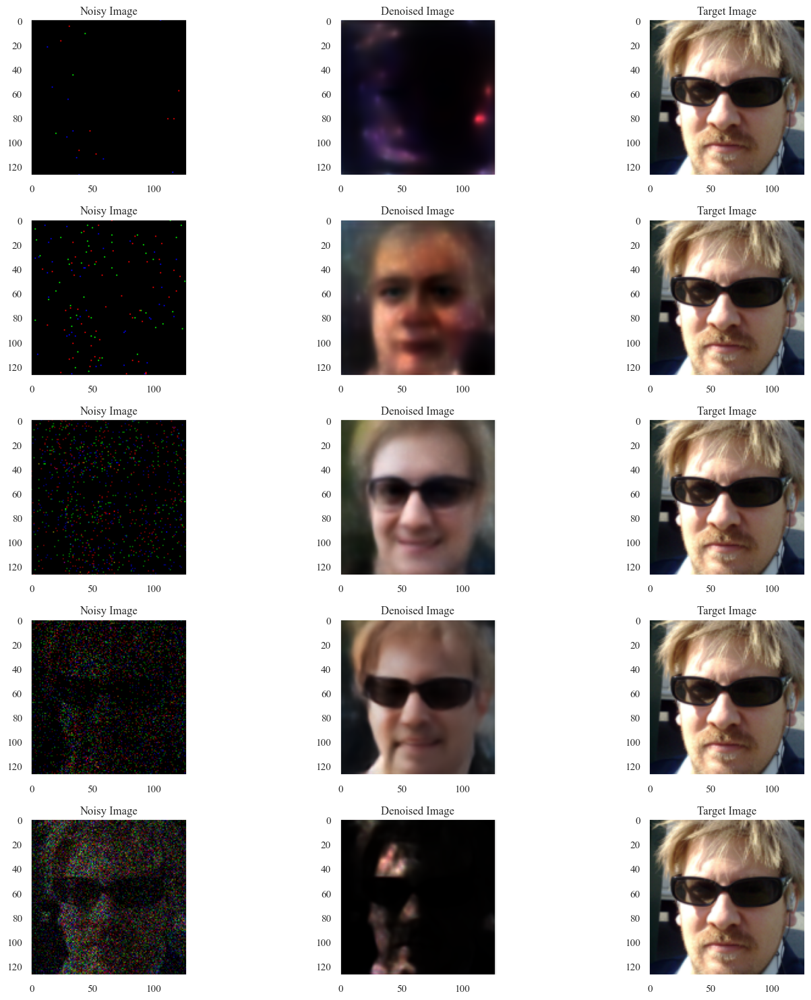

In [49]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

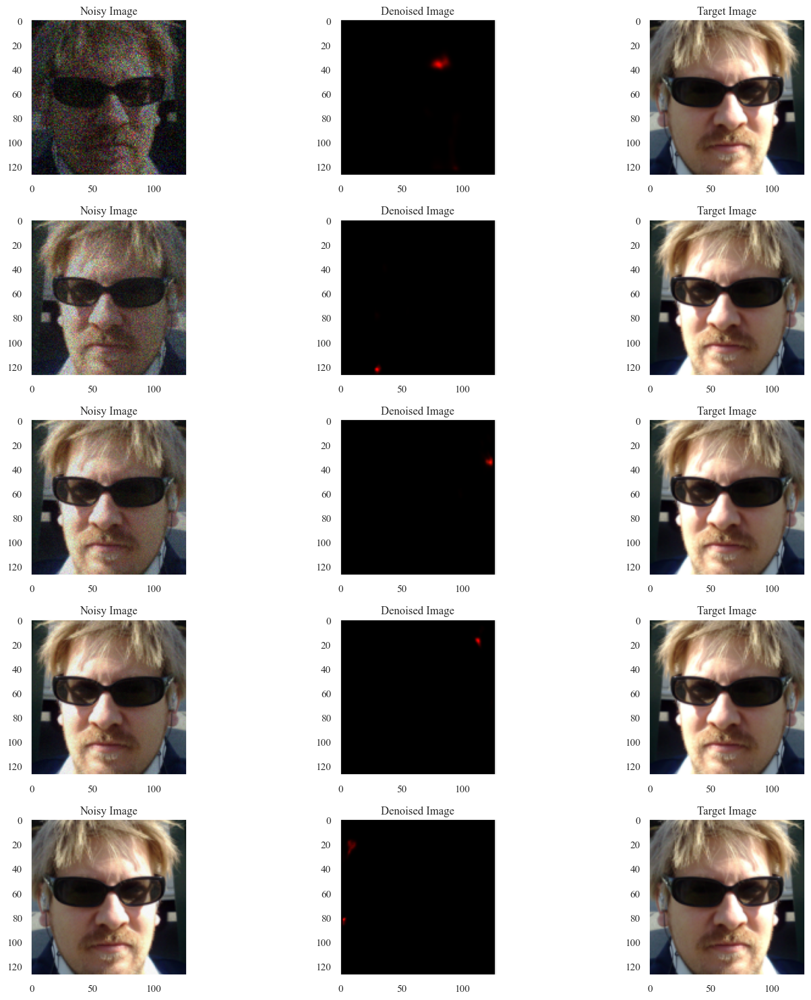

In [50]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [51]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Sixth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_7 = np.array(Psnr_Distribution)
SSIM_Distribution_7 = np.array(SSIM_Distribution)
Perceptual_Distribution_7 = np.array(Perceptual_Distribution)
Psnr_Distribution_7.shape, SSIM_Distribution_7.shape, Perceptual_Distribution_7.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.913197,-3.559511,1.067405,2.665861,3.733266,-1.598456
std,16.423897,20.564969,16.073884,1.378943,15.290863,16.933162
min,-29.245427,-39.119021,-23.094510,0.767113,-20.630365,-26.884392
25%,-15.044562,-21.339266,-16.509360,1.479373,-12.167534,-20.209941
50%,4.296851,-3.559511,4.936488,2.456876,7.542674,2.352382
75%,16.890409,14.220245,16.843755,3.566273,18.766436,15.217378
max,25.569778,32.000000,23.412957,8.386777,24.699235,22.397049


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.251768,-3.559511,0.252537,0.048601,0.301138,0.203936
std,0.256260,20.564969,0.250075,0.027321,0.264714,0.237686
min,-0.007443,-39.119021,0.003105,0.003328,0.007710,-0.047212
25%,0.012477,-21.339266,0.024915,0.032147,0.063710,-0.003817
50%,0.156935,-3.559511,0.162695,0.048855,0.197174,0.124296
75%,0.492778,14.220245,0.481489,0.063972,0.568821,0.402236
max,0.813470,32.000000,0.728877,0.160874,0.793904,0.669754


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.167212,-3.119021,0.167037,0.048348,0.177386,0.156687
std,0.088797,20.310653,0.071262,0.026397,0.076632,0.067670
min,-0.053752,-38.238042,0.095647,0.008147,0.098091,0.036930
25%,0.117822,-20.678532,0.118111,0.027027,0.122389,0.113131
50%,0.136283,-3.119021,0.133671,0.044224,0.144167,0.128260
75%,0.195943,14.440489,0.188699,0.060976,0.200895,0.176782
max,0.555835,32.000000,0.446968,0.184564,0.474740,0.419197


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

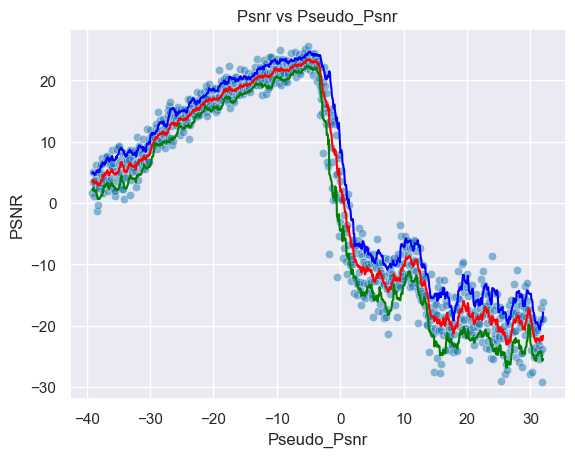

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

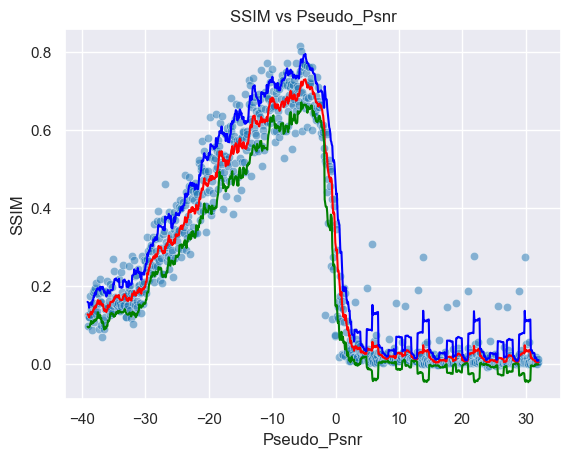

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

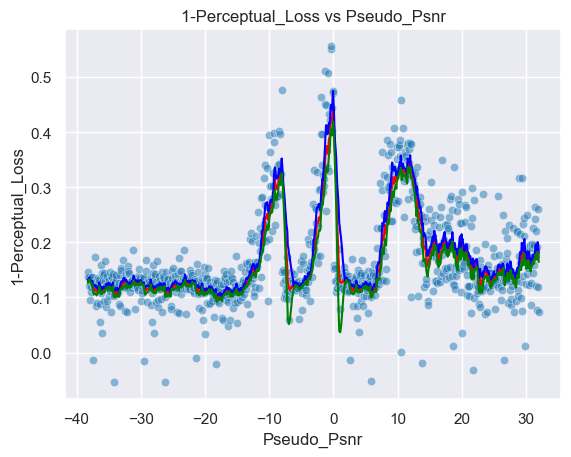

Psnr Area: 76.72698603903632, SSIM Area: 17.9751858220712, Perceptual Area: 11.733608367445736
Mean Psnr 0.9131970010808254
Std Psnr 16.42389674303251
Min Psnr -29.24542689015383
Max Psnr 25.569778019358683
Mean Roll Var 2.6658613560819533
Mean SSIM 0.25176767
Std SSIM 0.2562596797943115
Min SSIM -0.007443114649504423
Max SSIM 0.813469648361206
Mean Roll SSIM 0.04860108567800009
Mean 1-PL 0.16721189
Std 1-PL 0.08879714459180832
Min 1-PL -0.05375230312347412
Max 1-PL 0.5558351278305054
Mean Roll 1-PL 0.048348141612241484


(76.72698603903632, 17.9751858220712, 11.733608367445736)

In [101]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Sixth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_7, SSIM_Distribution_7, Perceptual_Distribution_7, minpsnr, maxpsnr)

In [52]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Seventh Highest PSNR Range
print(PSNR_Ranges[-7][0], PSNR_Ranges[-7][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-7][0] , maxPSNR = PSNR_Ranges[-7][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-7][0], maxPSNR = PSNR_Ranges[-7][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-24 -16


(16384, 4096)

In [17]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [53]:
# Creates the directory to save the model in for the Seventh Highest PSNR Range.
name = "FaceGenerationUNet128x128-m24-m16"
CHECKPOINT_PATH = "./models/" 

In [19]:
# Trains the model using the Pytorch Lightning Trainer for the Seventh Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [20]:
# Trains the model using the Pytorch Lightning Trainer for the Seventh Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [54]:
# Loads the model from the checkpoint for the Seventh Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [22]:
# Validates the trained model on the Train Set for the Seventh Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.11829553544521332    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.11829553544521332}]

In [23]:
# Validates the trained model on the Validation Set for the Seventh Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.11829269677400589    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.11829269677400589}]

2.6738317 0.05326358 2.524693727493286 0.9693971872329712
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -22.917308807373047
-22.585718909144106 -22.585718909144106 -2.588596909321764e-07


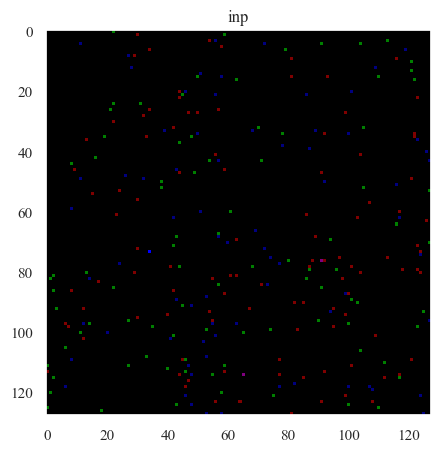

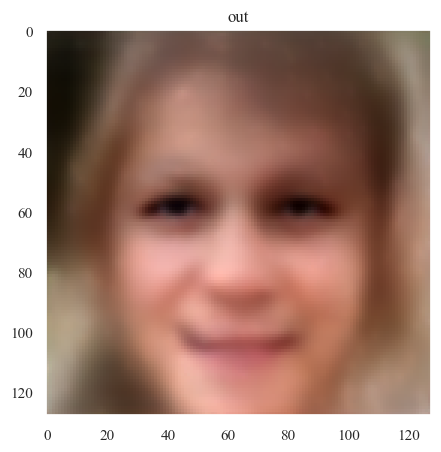

Text(0.5, 1.0, 'GT')

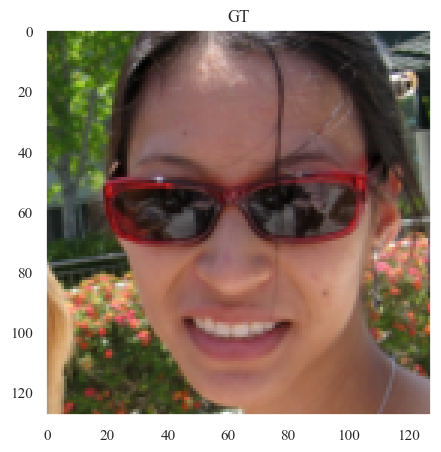

In [24]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

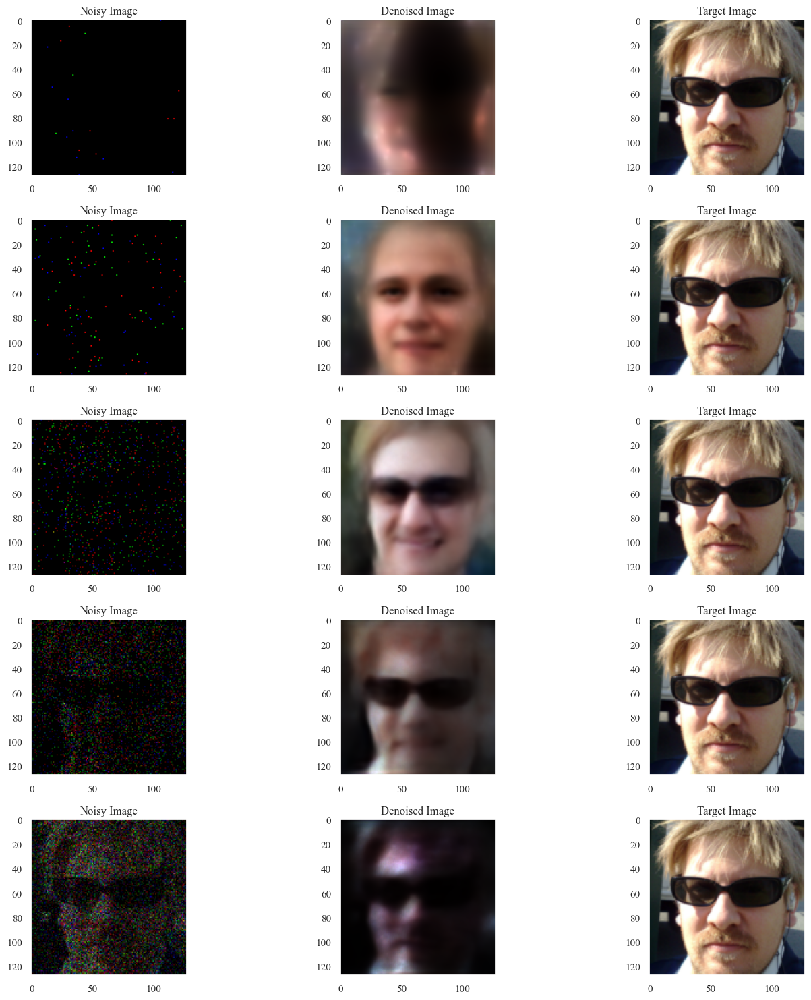

In [31]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

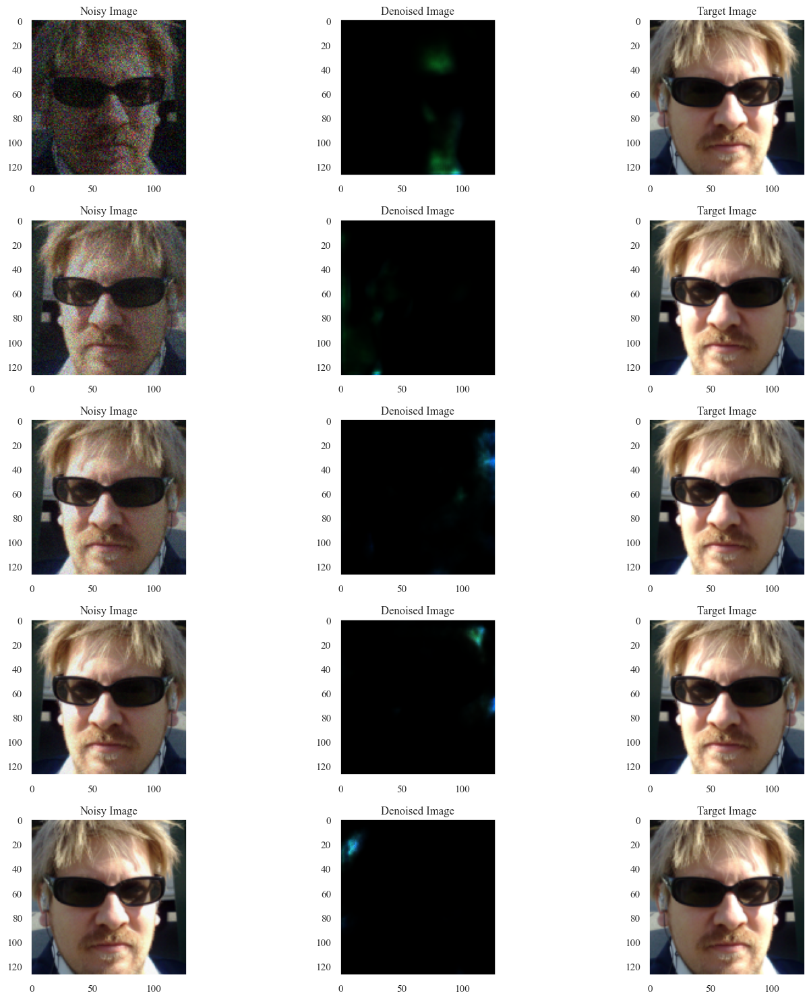

In [32]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [55]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Seventh Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_8 = np.array(Psnr_Distribution)
SSIM_Distribution_8 = np.array(SSIM_Distribution)
Perceptual_Distribution_8 = np.array(Perceptual_Distribution)
Psnr_Distribution_8.shape, SSIM_Distribution_8.shape, Perceptual_Distribution_8.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,5.900298,-3.559511,6.001704,2.494530,8.496234,3.507174
std,11.454971,20.564969,11.083676,1.176584,10.141249,12.067291
min,-19.366604,-39.119021,-12.869206,0.651058,-9.657926,-16.512579
25%,-4.468135,-21.339266,-4.939683,1.468386,-1.586182,-8.594896
50%,9.049793,-3.559511,9.164216,2.095698,11.724616,6.795043
75%,16.547230,14.220245,16.671098,3.429483,17.862349,15.470795
max,22.995908,32.000000,20.516929,5.710792,22.004014,19.079256


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.277275,-3.559511,0.278246,0.054358,0.332604,0.223887
std,0.217264,20.564969,0.209387,0.018737,0.219092,0.200965
min,-0.050931,-39.119021,-0.008847,0.009750,0.009773,-0.056269
25%,0.059773,-21.339266,0.066145,0.041006,0.117471,0.017273
50%,0.267774,-3.559511,0.254966,0.054955,0.321322,0.202110
75%,0.486028,14.220245,0.495447,0.068339,0.562286,0.430352
max,0.727742,32.000000,0.605140,0.098292,0.678813,0.550052


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.226191,-3.119021,0.224544,0.051657,0.235666,0.213423
std,0.129673,20.310653,0.116324,0.027735,0.120016,0.113917
min,-0.052683,-38.238042,0.097261,0.010121,0.099802,0.030369
25%,0.122782,-20.678532,0.117436,0.029968,0.122349,0.112698
50%,0.154558,-3.119021,0.160304,0.045337,0.188292,0.144956
75%,0.348108,14.440489,0.331777,0.066018,0.349444,0.316680
max,0.612584,32.000000,0.479075,0.186431,0.489882,0.468861


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

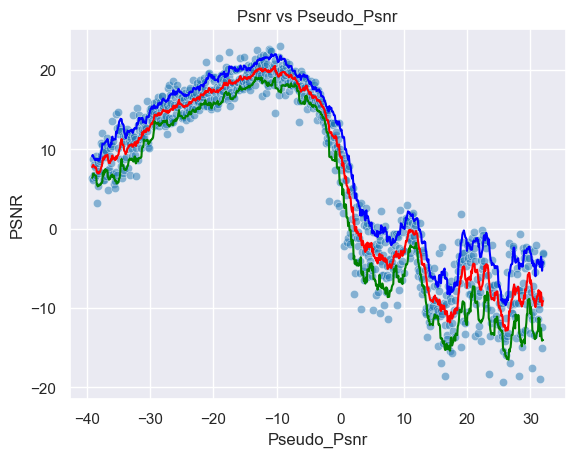

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

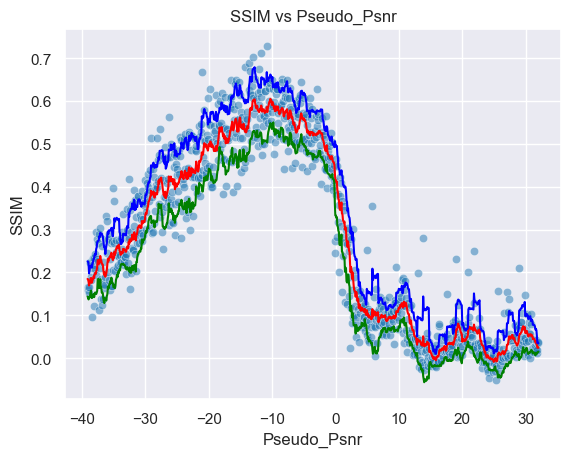

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

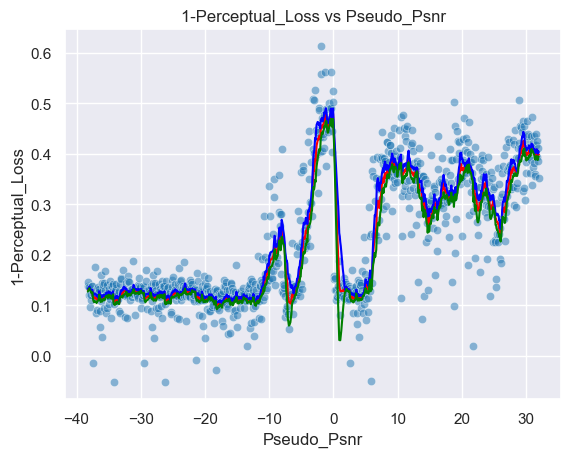

Psnr Area: 427.37055826839264, SSIM Area: 19.80246355418749, Perceptual Area: 15.768409954692684
Mean Psnr 5.9002977554259415
Std Psnr 11.454971448961599
Min Psnr -19.366604129577507
Max Psnr 22.995907590594168
Mean Roll Var 2.4945302318156837
Mean SSIM 0.27727467
Std SSIM 0.21726350486278534
Min SSIM -0.050930824130773544
Max SSIM 0.7277416586875916
Mean Roll SSIM 0.05435824207286235
Mean 1-PL 0.22619107
Std 1-PL 0.1296727955341339
Min 1-PL -0.052683234214782715
Max 1-PL 0.6125836372375488
Mean Roll 1-PL 0.05165705822936167


(427.37055826839264, 19.80246355418749, 15.768409954692684)

In [34]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Seventh Highest PSNR Range.
Plot_Creater(Psnr_Distribution_8, SSIM_Distribution_8, Perceptual_Distribution_8, minpsnr, maxpsnr)

In [56]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Eighth Highest PSNR Range
print(PSNR_Ranges[-8][0], PSNR_Ranges[-8][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-8][0] , maxPSNR = PSNR_Ranges[-8][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-8][0], maxPSNR = PSNR_Ranges[-8][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-32 -24


(16384, 4096)

In [36]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [57]:
# Creates the directory to save the model in for the Eighth Highest PSNR Range.
name = "FaceGenerationUNet128x128-m32-m24"
CHECKPOINT_PATH = "./models/" 

In [38]:
# Trains the model using the Pytorch Lightning Trainer for the Eighth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [39]:
# Trains the model using the Pytorch Lightning Trainer for the Eighth Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [40]:
# Loads the model from the checkpoint for the Eighth Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.08111811429262161    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.08111811429262161}]

In [41]:
# Validates the trained model on the Train Set for the Eighth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.08205880224704742    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.08205880224704742}]

In [58]:
# Validates the trained model on the Validation Set for the Eighth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


1.7945433 0.11259879 1.787505865097046 0.9570897221565247
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -30.83694839477539
-30.480885081161325 -30.480884798768958 0.0


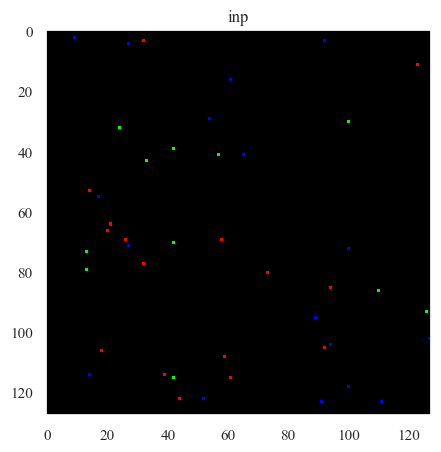

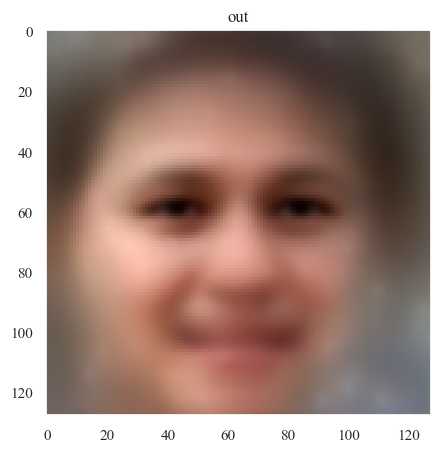

Text(0.5, 1.0, 'GT')

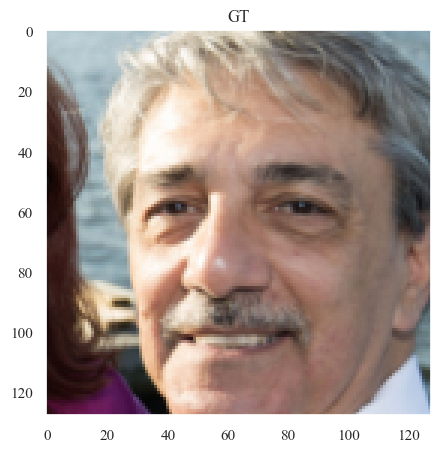

In [59]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

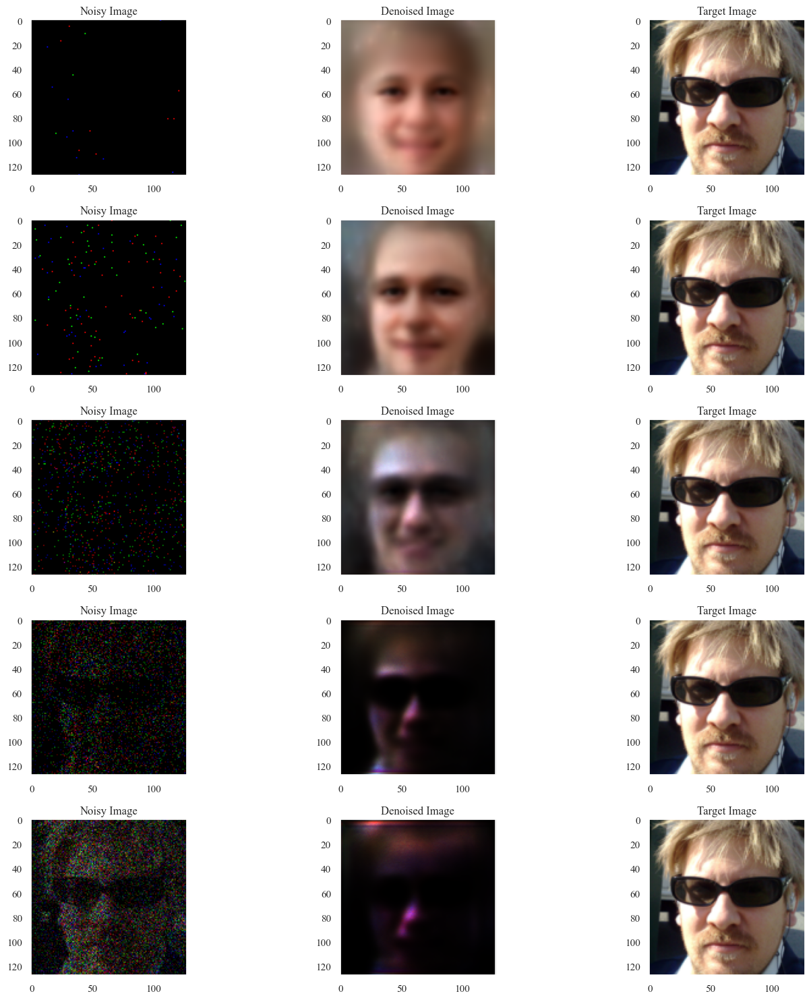

In [60]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

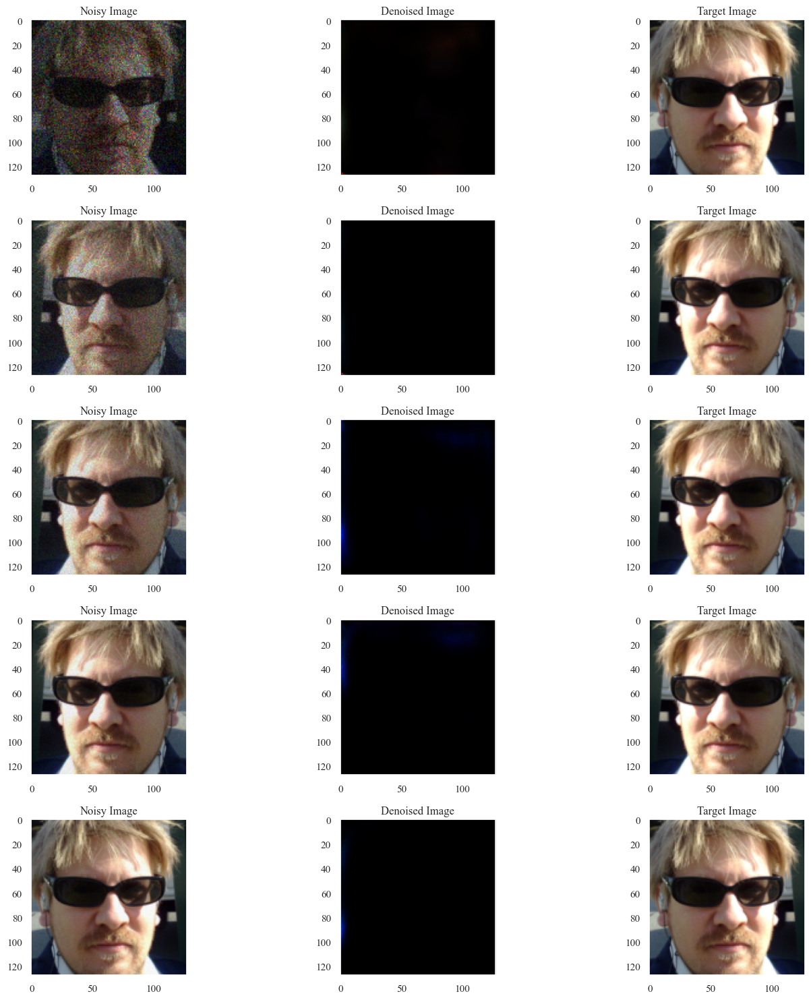

In [61]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [62]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Eighth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_9 = np.array(Psnr_Distribution)
SSIM_Distribution_9 = np.array(SSIM_Distribution)
Perceptual_Distribution_9 = np.array(Perceptual_Distribution)
Psnr_Distribution_9.shape, SSIM_Distribution_9.shape, Perceptual_Distribution_9.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,3.696040,-3.559511,3.850336,3.854676,7.705012,-0.004340
std,11.231314,20.564969,10.326027,2.331523,8.589241,12.261755
min,-35.801110,-39.119021,-13.180881,0.869311,-8.214299,-22.493702
25%,-5.300097,-21.339266,-6.617884,1.727827,-0.942629,-11.976507
50%,4.850666,-3.559511,2.311013,3.496260,8.566393,-2.165703
75%,14.434138,14.220245,14.306886,5.338269,16.295100,12.579032
max,20.394982,32.000000,17.584115,10.995521,19.513322,16.142047


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.258362,-3.559511,0.260196,0.055424,0.315620,0.204772
std,0.160179,20.564969,0.149508,0.018393,0.161387,0.139055
min,-0.020571,-39.119021,0.014767,0.011808,0.033265,-0.021325
25%,0.108854,-21.339266,0.107611,0.040782,0.159526,0.059744
50%,0.246533,-3.559511,0.232446,0.056513,0.287799,0.181541
75%,0.392623,14.220245,0.401801,0.069609,0.469041,0.336041
max,0.608339,32.000000,0.508370,0.100574,0.564442,0.458846


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.236124,-3.119021,0.234868,0.038827,0.243252,0.226484
std,0.127560,20.310653,0.120339,0.021075,0.122750,0.118709
min,-0.053129,-38.238042,0.094410,0.009047,0.096683,0.056412
25%,0.124513,-20.678532,0.121742,0.025803,0.125339,0.116450
50%,0.168076,-3.119021,0.146374,0.033938,0.184873,0.139343
75%,0.355105,14.440489,0.348826,0.044963,0.357516,0.341134
max,0.552282,32.000000,0.444528,0.164454,0.458569,0.440176


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

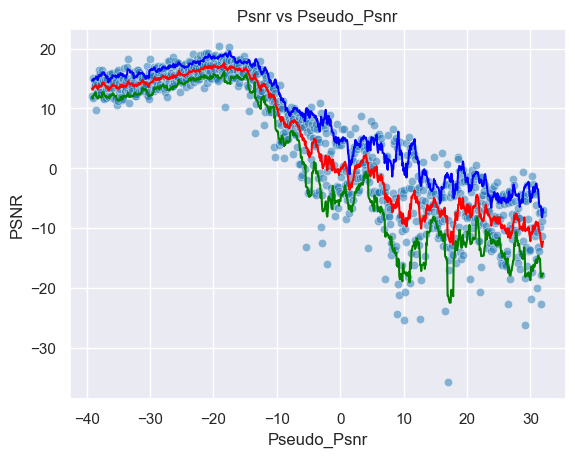

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

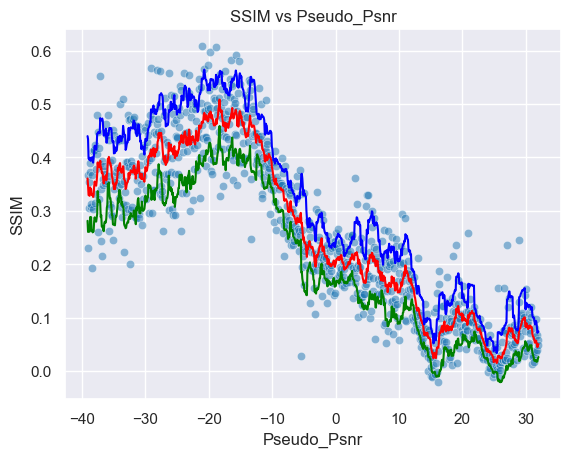

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

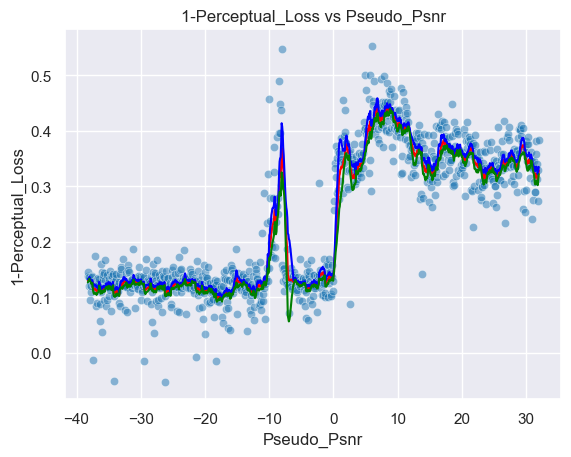

Psnr Area: 274.09859136623027, SSIM Area: 18.509276028592318, Perceptual Area: 16.49714251175871
Mean Psnr 3.6960398309700078
Std Psnr 11.231313620946423
Min Psnr -35.80111010735611
Max Psnr 20.39498213370036
Mean Roll Var 3.854676281079863
Mean SSIM 0.2583616
Std SSIM 0.16017921268939972
Min SSIM -0.020570630207657814
Max SSIM 0.6083394885063171
Mean Roll SSIM 0.05542415981494568
Mean 1-PL 0.23612392
Std 1-PL 0.12755993008613586
Min 1-PL -0.05312943458557129
Max 1-PL 0.5522822141647339
Mean Roll 1-PL 0.038827137149211884


(274.09859136623027, 18.509276028592318, 16.49714251175871)

In [46]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Eighth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_9, SSIM_Distribution_9, Perceptual_Distribution_9, minpsnr, maxpsnr)

In [63]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Ninth Highest PSNR Range
print(PSNR_Ranges[-9][0], PSNR_Ranges[-9][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-9][0] , maxPSNR = PSNR_Ranges[-9][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-9][0], maxPSNR = PSNR_Ranges[-9][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-40 -32


(16384, 4096)

In [48]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


In [64]:
# Creates the directory to save the model in for the Ninth Highest PSNR Range.
name = "FaceGenerationUNet128x128-m40-m32"
CHECKPOINT_PATH = "./models/" 

In [50]:
# Trains the model using the Pytorch Lightning Trainer for the Ninth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [51]:
# Trains the model using the Pytorch Lightning Trainer for the Ninth Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name       | Type       | Params
------------------------------------------
0 | conv_final | Conv2d     | 153   
1 | down_convs | ModuleList | 76.8 M
2 | up_convs   | ModuleList | 32.4 M
------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


In [65]:
# Loads the model from the checkpoint for the Ninth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [52]:
# Validates the trained model on the Train Set for the Ninth Highest PSNR Range.
Trainer.test(model, Train_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:492: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:441: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=23` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.047806981950998306   │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.047806981950998306}]

In [53]:
# Validates the trained model on the Validation Set for the Ninth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.04729708284139633    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.04729708284139633}]

1.7861032 0.021012979 1.7861032485961914 1.0086230039596558
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -36.42513656616211
-35.45413173129143 -35.45413173129143 -2.588596909321764e-07


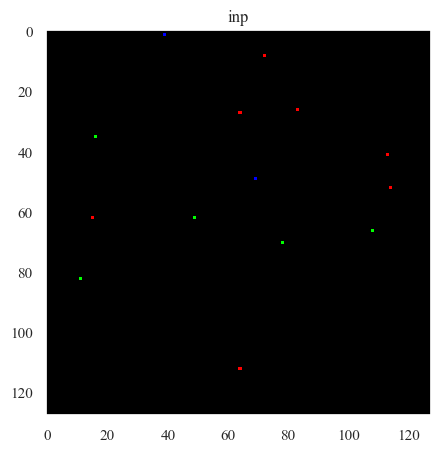

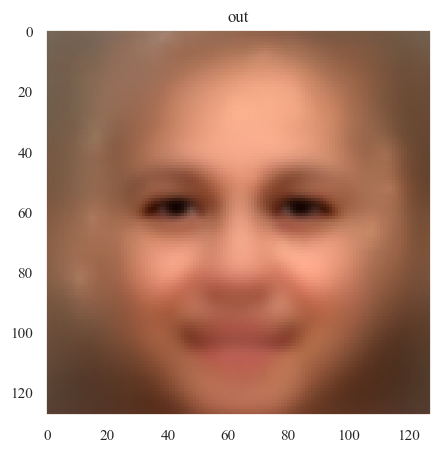

Text(0.5, 1.0, 'GT')

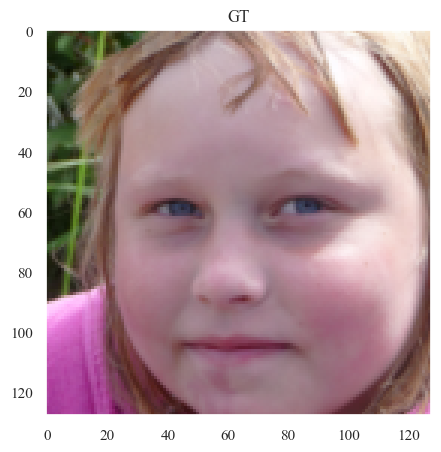

In [66]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

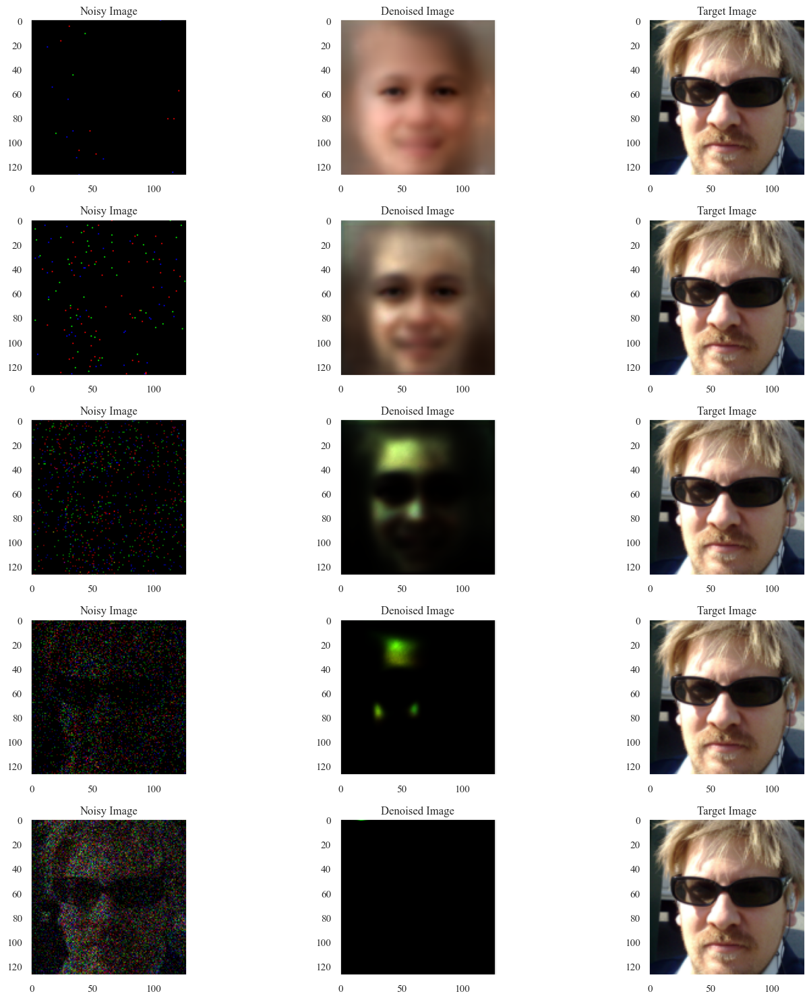

In [67]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

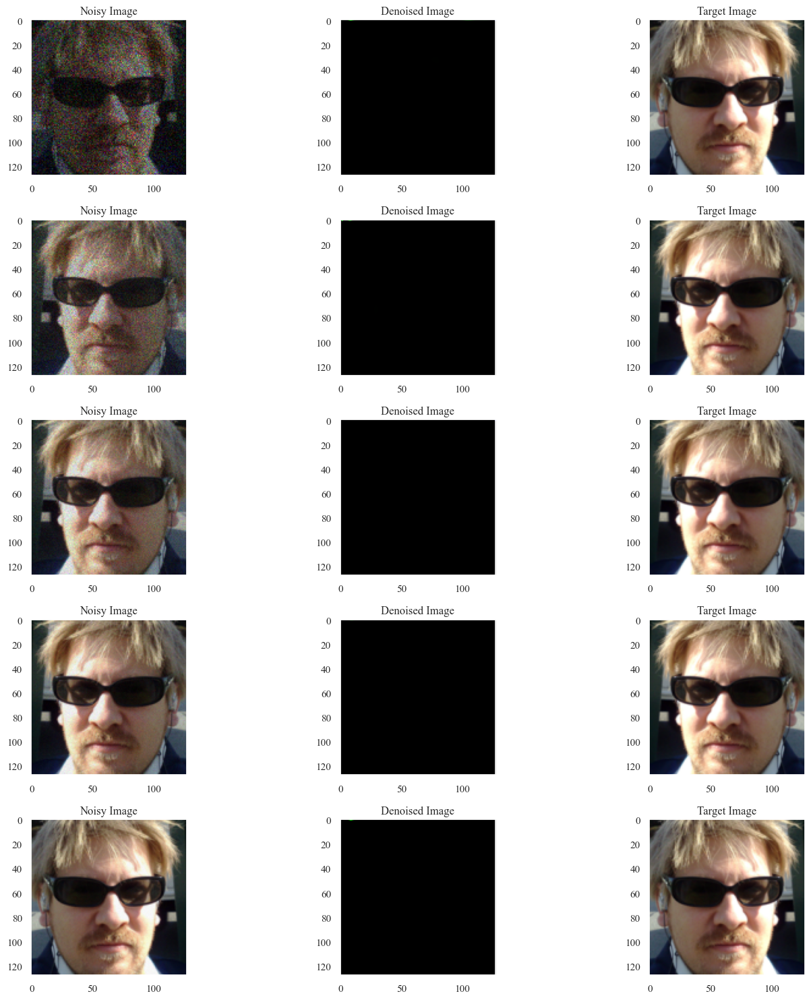

In [68]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [69]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Ninth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)
def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = model(Noisy_Images).detach().cpu()
    Predictions -= Predictions.max()
    Predictions = torch.exp(Predictions)
    Predictions = Noisy_Images.detach().cpu().sum() * Predictions/Predictions.sum()
    perceptual_score = lpips_model(Target_Images, Predictions.to(device))
    perceptual_score = 1 - perceptual_score
    #print(perceptual_score)

    Noisy_Images = Noisy_Images.detach().cpu().numpy()
    Target_Images = Target_Images.detach().cpu().numpy()
    Predictions = Predictions.detach().cpu().numpy()
    perceptual_score = perceptual_score.detach().cpu().numpy()

    Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True) 
    #Target_Images = Target_Images/Target_Images.mean(axis = (1,2,3), keepdims=True)
    
    Psnr_Scores = [psnr(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    SSIM_Scores = [ssim(Target_Image, Prediction, data_range = Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
    #lpips_score = lpips.lpips(Predictions, Target_Images)
    return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_10 = np.array(Psnr_Distribution)
SSIM_Distribution_10 = np.array(SSIM_Distribution)
Perceptual_Distribution_10 = np.array(Perceptual_Distribution)
Psnr_Distribution_10.shape, SSIM_Distribution_10.shape, Perceptual_Distribution_10.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\lpips\weights\v0.1\alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


C:\Users\kdarn\AppData\Local\Temp\ipykernel_25596\3123095116.py:21: RuntimeWarning: invalid value encountered in divide
  Predictions = Predictions/Predictions.mean(axis = (1,2,3), keepdims=True)


((900,), (900,), (900,))

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,870.000000,870.000000,870.000000,870.000000,870.000000,870.000000
mean,-12.936753,-4.204917,-12.615591,4.925540,-7.690051,-17.541131
std,19.946806,20.313738,19.231748,2.693399,17.149926,21.450153
min,-44.126707,-39.119021,-36.330504,0.939358,-31.450770,-41.210238
25%,-32.434233,-21.719689,-30.473096,2.040178,-23.447884,-37.136859
50%,-16.543932,-4.320356,-19.408560,5.095181,-11.632764,-27.097987
75%,10.880969,13.078977,11.997719,7.432634,13.884721,9.511766
max,18.040567,32.000000,15.101781,10.330563,16.741643,13.902367


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,870.000000,870.000000,870.000000,870.000000,870.000000,870.000000
mean,0.129427,-4.204917,0.131657,0.042026,0.173683,0.089631
std,0.163425,20.313738,0.157349,0.025155,0.174258,0.142889
min,-0.002587,-39.119021,0.001200,0.001276,0.002670,-0.050289
25%,0.001340,-21.719689,0.010069,0.016981,0.026474,-0.020801
50%,0.022501,-4.320356,0.026860,0.042213,0.075940,-0.001991
75%,0.290013,13.078977,0.342594,0.061116,0.402870,0.273609
max,0.558433,32.000000,0.426126,0.096862,0.489411,0.375901


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.122967,-3.119021,0.123045,0.032894,0.127959,0.118132
std,0.036175,20.310653,0.012031,0.013413,0.013677,0.011073
min,-0.053102,-38.238042,0.086258,0.009252,0.093643,0.078867
25%,0.112521,-20.678532,0.116013,0.022523,0.120612,0.110849
50%,0.126885,-3.119021,0.122208,0.027715,0.126274,0.117741
75%,0.140005,14.440489,0.128578,0.043809,0.132360,0.124505
max,0.362552,32.000000,0.189712,0.083515,0.213669,0.168052


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

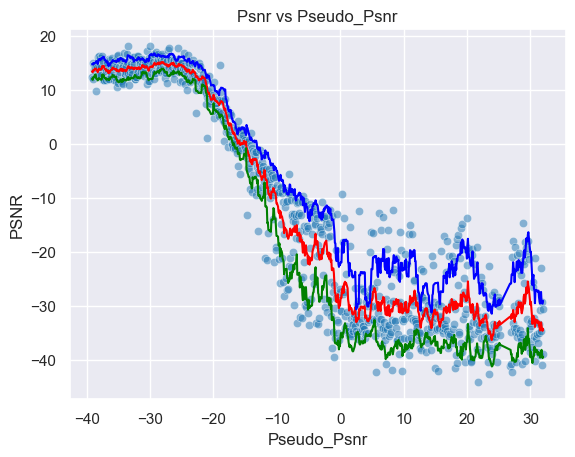

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

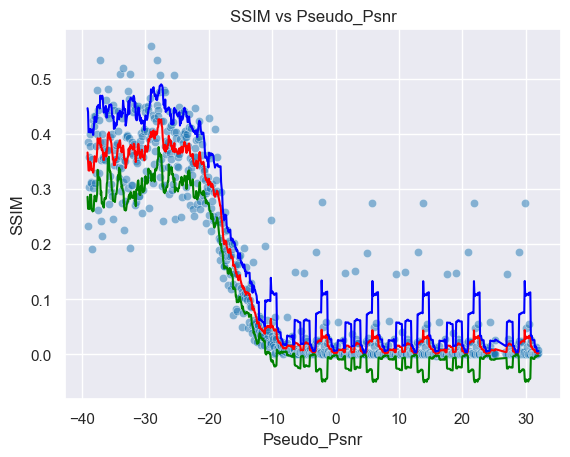

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

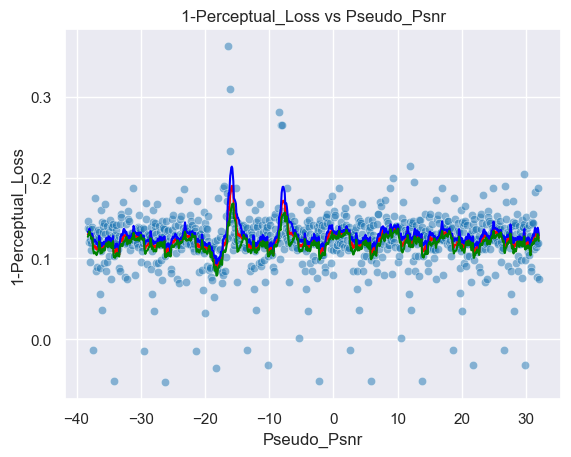

Psnr Area: -928.00338284436, SSIM Area: 9.169506035113487, Perceptual Area: 8.642107031236632
Mean Psnr -12.936753348767589
Std Psnr 19.94680630997687
Min Psnr -44.126706523224
Max Psnr 18.04056748489405
Mean Roll Var 4.925539971945785
Mean SSIM 0.1294267
Std SSIM 0.16342483460903168
Min SSIM -0.002586627146229148
Max SSIM 0.5584332346916199
Mean Roll SSIM 0.04202597647479062
Mean 1-PL 0.12296676
Std 1-PL 0.03617526963353157
Min 1-PL -0.05310177803039551
Max 1-PL 0.3625524044036865
Mean Roll 1-PL 0.032893875927368144


(-928.00338284436, 9.169506035113487, 8.642107031236632)

In [58]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Ninth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_10, SSIM_Distribution_10, Perceptual_Distribution_10, minpsnr, maxpsnr)

In [174]:
# Combines the data from the 9 uniformly spaced PSNR ranges into a single dataframe.
uniform = np.linspace(-40, 32, 900)
Psnr_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "Psnr_Distribution_m40_32":Psnr_Distribution_1, "Psnr_Distribution_24_32":Psnr_Distribution_2, "Psnr_Distribution_16_24":Psnr_Distribution_3, 
                                  "Psnr_Distribution_8_16":Psnr_Distribution_4, "Psnr_Distribution_0_8":Psnr_Distribution_5, "Psnr_Distribution_m8_0":Psnr_Distribution_6, 
                                  "Psnr_Distribution_m16_m8":Psnr_Distribution_7, "Psnr_Distribution_m24_m16":Psnr_Distribution_8, "Psnr_Distribution_m32_m24":Psnr_Distribution_9, 
                                  "Psnr_Distribution_m40_m32":Psnr_Distribution_10})
Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
0,-40.000000,13.931335,2.965824,-12.236445,-4.541243,-8.426771,-0.871807,3.273630,7.134330,13.397091,13.688814
1,-39.919911,11.197247,0.114115,-15.331080,-7.589405,-10.258649,-3.393983,1.574596,4.621635,10.693827,10.974952
2,-39.839822,15.486684,4.662463,-10.771771,-3.141318,-6.442770,0.765007,5.251142,9.440811,14.553434,14.746293
3,-39.759733,12.448342,4.534579,-9.640038,-2.154857,-5.364823,1.619372,4.962759,8.077298,13.301127,12.983700
4,-39.679644,11.442880,4.333899,-10.266336,-2.639903,-5.922700,0.218613,3.140301,8.989310,11.422859,11.543732
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,26.798373,35.897502,10.028850,4.849445,-6.361029,0.480720,-18.938224,-4.189297,-17.909539,-34.604646
896,31.759733,28.674237,38.076608,12.937120,3.864370,-13.551679,-2.866573,-23.841478,-15.024503,-8.795984,-29.240883
897,31.839822,29.096009,37.915652,17.610471,3.014188,-10.259230,1.570665,-29.245427,-12.399457,-11.291100,-40.994768
898,31.919911,30.148988,39.544179,4.433942,4.209054,-6.481376,-13.533871,-18.897920,-3.255308,-7.681849,-38.907631


In [175]:
# Generates the smoothed Psnr Distribution for the combined data.
Smoothed_Psnr_Distribution = Psnr_Distribution.rolling(window=10).mean()
Smoothed_Psnr_Distribution = Smoothed_Psnr_Distribution.dropna()
Smoothed_Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
9,-39.639600,13.287141,3.765767,-11.231332,-3.647327,-7.322335,-0.435936,3.613368,7.915047,13.187923,13.275795
10,-39.559511,13.361748,3.859848,-11.113585,-3.537902,-7.154348,-0.331758,3.663861,7.968414,13.405069,13.472133
11,-39.479422,13.514017,4.051239,-10.905131,-3.345745,-7.076301,-0.235572,3.668903,8.149532,13.546749,13.600881
12,-39.399333,13.179642,4.155577,-10.715744,-3.162211,-6.862965,-0.153124,3.649536,8.081043,13.259393,13.315085
13,-39.319244,13.476313,4.092745,-10.912408,-3.339795,-7.121424,-0.300242,3.490529,7.891637,13.440481,13.517356
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,29.550289,38.669348,16.483751,3.389027,-10.635234,-3.231332,-21.609878,-8.921717,-13.808349,-34.236807
896,31.399333,29.333183,38.460464,15.293004,3.506625,-10.897693,-3.164200,-21.952152,-9.510679,-13.170563,-33.558963
897,31.479422,29.168538,38.252258,14.862418,3.456431,-10.941530,-3.021661,-22.483770,-10.333312,-13.230954,-34.133893
898,31.559511,29.226247,38.297335,13.088174,3.835541,-10.531044,-3.929093,-22.293285,-9.810291,-12.001620,-34.176343


In [176]:
str(PSNR_Ranges[0][0]) + "_" + str(PSNR_Ranges[-1][1])

'-40_32'

In [177]:
Psnr_columns = ["m40_32", "24_32", "16_24", "8_16", "0_8", "m8_0", "m16_m8", "m24_m16", "m32_m24", "m40_m32"]

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

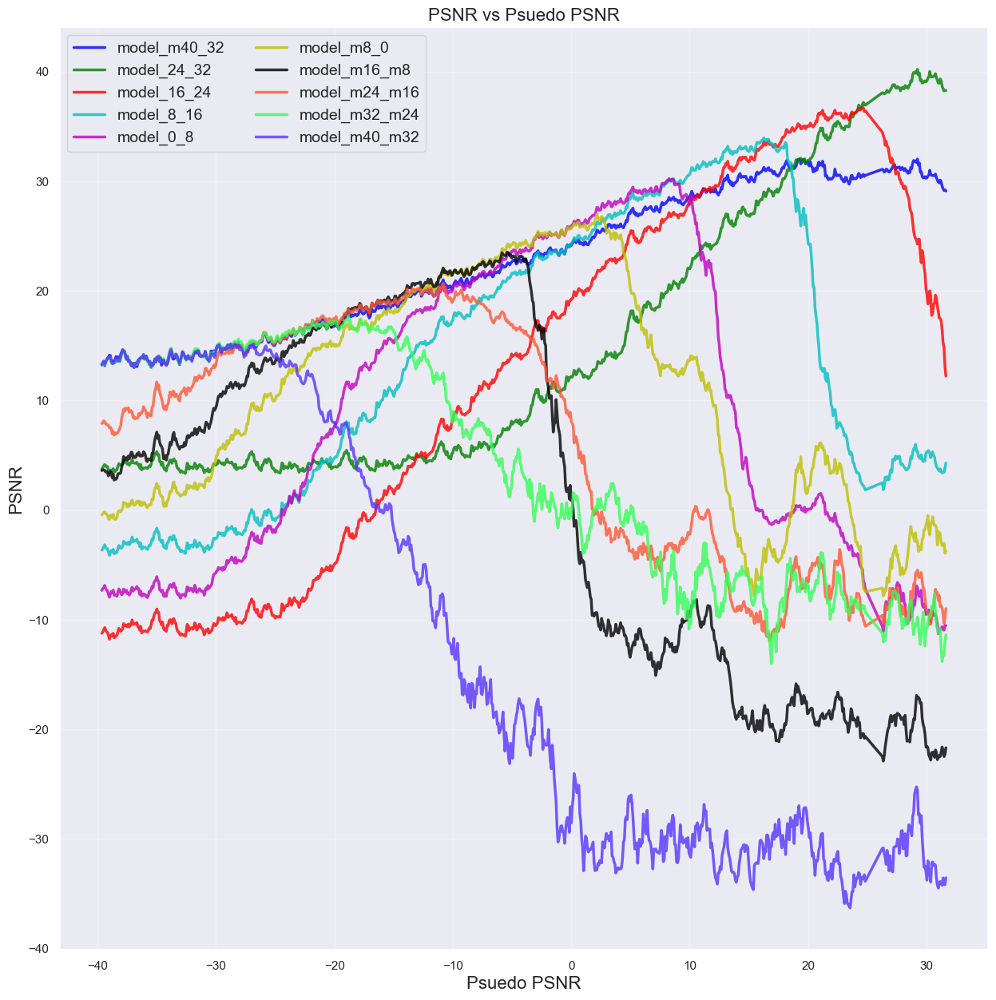

In [135]:
# Plots the PSNR vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, psnr in enumerate(Smoothed_Psnr_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = psnr, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("PSNR", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("PSNR vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [227]:
# Combines the 9 different models into a single model.
Augmented_Psnr_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_Psnr_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_Psnr_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_Psnr_Distribution.extend(Specific_Psnr_Distribution)
Augmented_Psnr_Distribution = np.array(Augmented_Psnr_Distribution)
Augmented_Psnr_Distribution.shape

(874,)

In [206]:
Augmented_Psnr_Distribution = []

In [179]:
Smoothed_Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
9,-39.639600,13.287141,3.765767,-11.231332,-3.647327,-7.322335,-0.435936,3.613368,7.915047,13.187923,13.275795
10,-39.559511,13.361748,3.859848,-11.113585,-3.537902,-7.154348,-0.331758,3.663861,7.968414,13.405069,13.472133
11,-39.479422,13.514017,4.051239,-10.905131,-3.345745,-7.076301,-0.235572,3.668903,8.149532,13.546749,13.600881
12,-39.399333,13.179642,4.155577,-10.715744,-3.162211,-6.862965,-0.153124,3.649536,8.081043,13.259393,13.315085
13,-39.319244,13.476313,4.092745,-10.912408,-3.339795,-7.121424,-0.300242,3.490529,7.891637,13.440481,13.517356
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,29.550289,38.669348,16.483751,3.389027,-10.635234,-3.231332,-21.609878,-8.921717,-13.808349,-34.236807
896,31.399333,29.333183,38.460464,15.293004,3.506625,-10.897693,-3.164200,-21.952152,-9.510679,-13.170563,-33.558963
897,31.479422,29.168538,38.252258,14.862418,3.456431,-10.941530,-3.021661,-22.483770,-10.333312,-13.230954,-34.133893
898,31.559511,29.226247,38.297335,13.088174,3.835541,-10.531044,-3.929093,-22.293285,-9.810291,-12.001620,-34.176343


In [226]:
idx = 8
print(PSNR_Ranges[idx][0], PSNR_Ranges[idx][1])
Specific_Psnr_Distribution = Smoothed_Psnr_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
Specific_Psnr_Distribution.iloc[:, -(idx+1)]

24 32


804    36.291826
805    36.332858
806    36.510092
807    36.955130
808    36.840013
         ...    
895    38.669348
896    38.460464
897    38.252258
898    38.297335
899    38.293837
Name: Psnr_Distribution_24_32, Length: 79, dtype: float64

In [229]:
Smoothed_Psnr_Distribution["Augmented_Psnr_Distribution_m40_32"] = Augmented_Psnr_Distribution

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

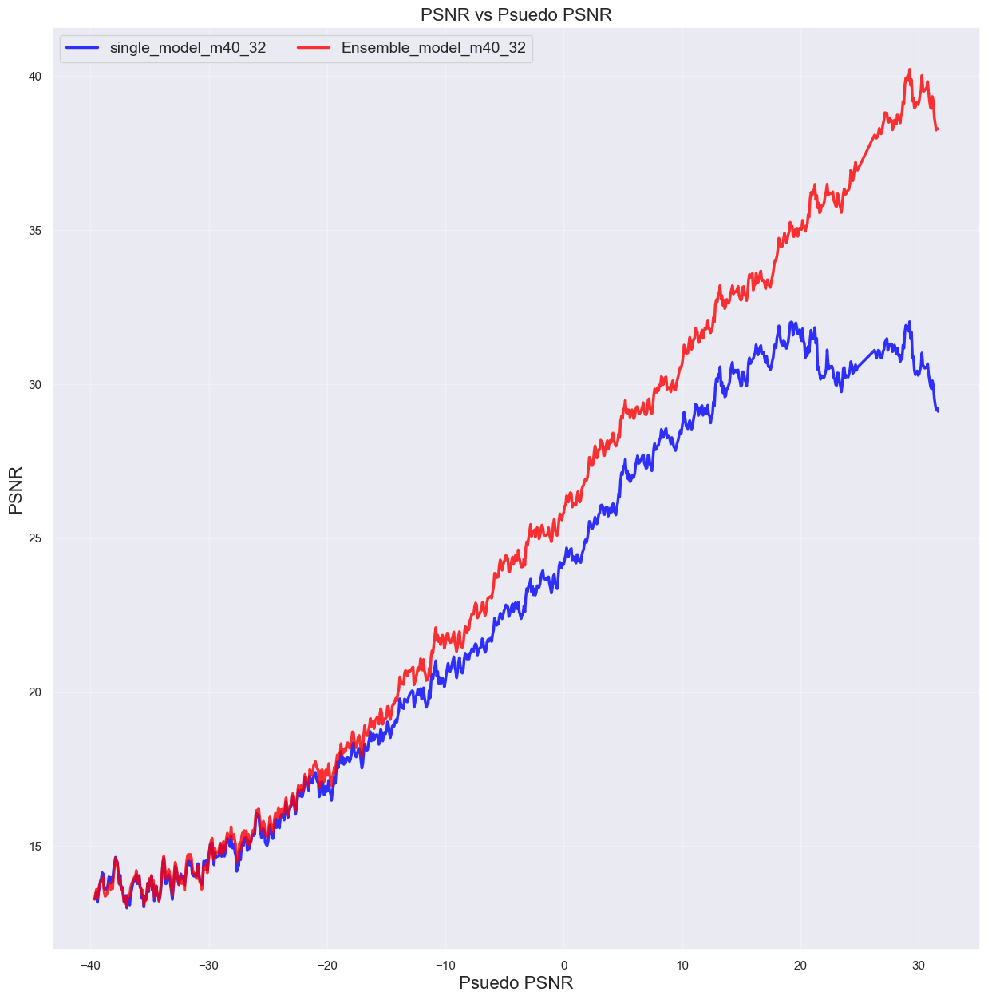

In [234]:
# Plots the PSNR vs Psuedo PSNR for the different models in the cascade and compares this to the original model.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = "Psnr_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = "Augmented_Psnr_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("PSNR", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("PSNR vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [232]:
# Generates the SSIM Distribution for the combined data.
uniform = np.linspace(-40, 32, 900)
SSIM_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "SSIM_Distribution_m40_32":SSIM_Distribution_1, "SSIM_Distribution_24_32":SSIM_Distribution_2, "SSIM_Distribution_16_24":SSIM_Distribution_3, 
                                  "SSIM_Distribution_8_16":SSIM_Distribution_4, "SSIM_Distribution_0_8":SSIM_Distribution_5, "SSIM_Distribution_m8_0":SSIM_Distribution_6, 
                                  "SSIM_Distribution_m16_m8":SSIM_Distribution_7, "SSIM_Distribution_m24_m16":SSIM_Distribution_8, "SSIM_Distribution_m32_m24":SSIM_Distribution_9, 
                                  "SSIM_Distribution_m40_m32":SSIM_Distribution_10})
SSIM_Distribution

,Psuedo_Psnr,SSIM_Distribution_m40_32,SSIM_Distribution_24_32,SSIM_Distribution_16_24,SSIM_Distribution_8_16,SSIM_Distribution_0_8,SSIM_Distribution_m8_0,SSIM_Distribution_m16_m8,SSIM_Distribution_m24_m16,SSIM_Distribution_m32_m24,SSIM_Distribution_m40_m32
0,-40.000000,0.390496,0.253798,0.133622,0.186210,0.116960,0.103345,0.139385,0.180896,0.388972,0.404327
1,-39.919911,0.526384,0.417053,0.191070,0.224400,0.159999,0.111933,0.132529,0.206845,0.519637,0.523050
2,-39.839822,0.375515,0.339386,0.172902,0.208192,0.194636,0.134956,0.186364,0.277113,0.358011,0.359853
3,-39.759733,0.356718,0.240629,0.155005,0.190018,0.126259,0.125862,0.110696,0.168706,0.386496,0.378016
4,-39.679644,0.221678,0.187922,0.103604,0.138458,0.121413,0.071084,0.093698,0.151773,0.200211,0.209349
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,0.918908,0.984814,0.173030,0.027855,0.033537,0.031935,0.001755,0.022123,0.035776,0.001007
896,31.759733,0.911203,0.976551,0.473045,0.045947,0.025937,0.061554,0.000971,0.010872,0.066682,0.000277
897,31.839822,0.906421,0.975027,0.504064,0.019798,0.021118,0.040911,0.000698,0.019402,0.039930,0.000065
898,31.919911,0.928583,0.982508,0.287272,0.018299,0.040583,0.042205,0.003784,0.035020,0.057032,0.001834


In [233]:
# Generates the smoothed SSIM Distribution for the combined data.
Smoothed_SSIM_Distribution = SSIM_Distribution.rolling(window=10).mean()
Smoothed_SSIM_Distribution = Smoothed_SSIM_Distribution.dropna()
Smoothed_SSIM_Distribution

,Psuedo_Psnr,SSIM_Distribution_m40_32,SSIM_Distribution_24_32,SSIM_Distribution_16_24,SSIM_Distribution_8_16,SSIM_Distribution_0_8,SSIM_Distribution_m8_0,SSIM_Distribution_m16_m8,SSIM_Distribution_m24_m16,SSIM_Distribution_m32_m24,SSIM_Distribution_m40_m32
9,-39.639600,0.351868,0.263678,0.140284,0.177878,0.132955,0.104155,0.126472,0.185125,0.351358,0.354853
10,-39.559511,0.356867,0.268843,0.143262,0.178250,0.134161,0.108622,0.128527,0.187731,0.357047,0.360200
11,-39.479422,0.345892,0.260380,0.140857,0.176865,0.134439,0.105809,0.125009,0.182903,0.341766,0.346367
12,-39.399333,0.332943,0.248024,0.138112,0.172453,0.129423,0.104276,0.118766,0.171700,0.329059,0.333739
13,-39.319244,0.327897,0.245457,0.133839,0.166896,0.128015,0.100679,0.119601,0.169939,0.321007,0.326298
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,0.925335,0.979839,0.573080,0.022974,0.025823,0.036317,0.003559,0.026290,0.042759,0.001874
896,31.399333,0.923415,0.979794,0.537988,0.025723,0.026417,0.039728,0.003472,0.025008,0.048173,0.001885
897,31.479422,0.920253,0.979157,0.512851,0.026349,0.025785,0.041043,0.003277,0.022394,0.049396,0.001863
898,31.559511,0.920735,0.979576,0.466770,0.027434,0.027955,0.043231,0.003451,0.024566,0.052069,0.002029


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

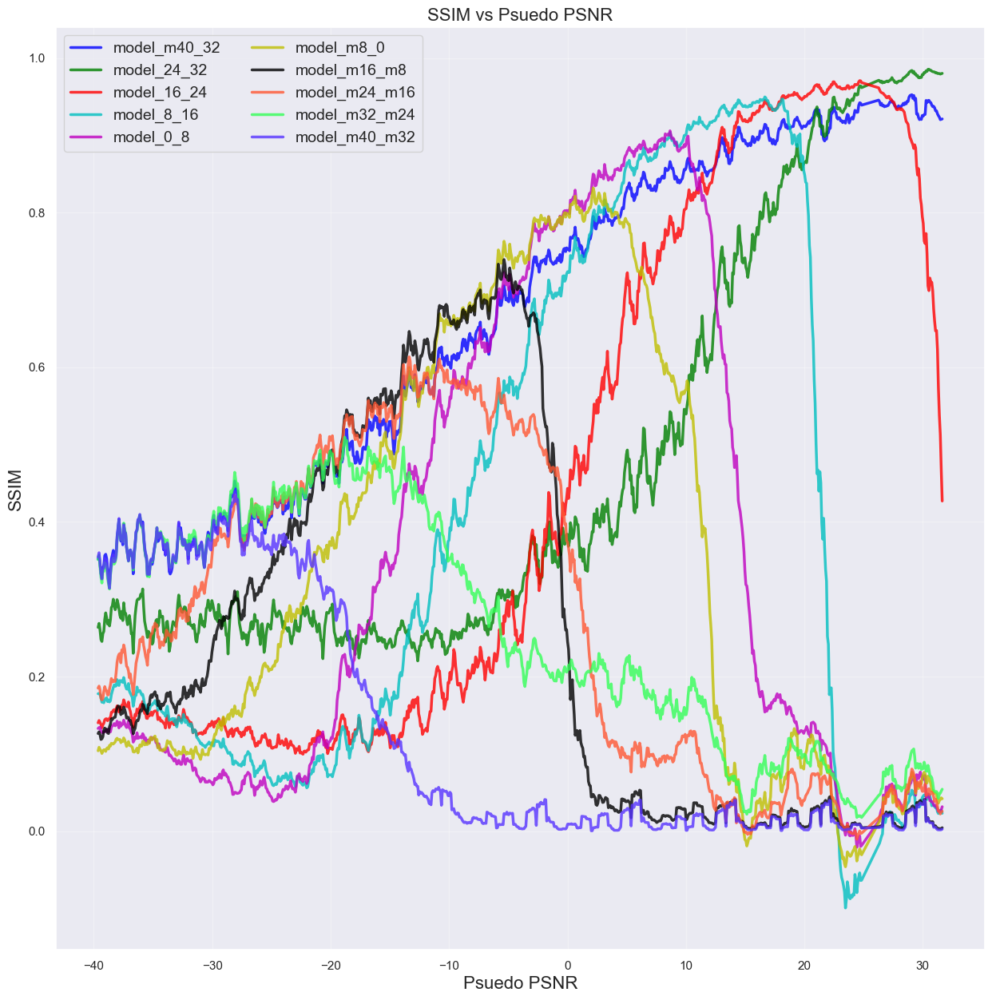

In [236]:
# Plots the SSIM vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, SSIM in enumerate(Smoothed_SSIM_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = SSIM, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("SSIM", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("SSIM vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [237]:
# Combines the 9 different models into a single model.
Augmented_SSIM_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_SSIM_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_SSIM_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_SSIM_Distribution.extend(Specific_SSIM_Distribution)
Augmented_SSIM_Distribution = np.array(Augmented_SSIM_Distribution)
Augmented_SSIM_Distribution.shape

(874,)

In [240]:
Smoothed_SSIM_Distribution["Augmented_SSIM_Distribution_m40_32"] = Augmented_SSIM_Distribution

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

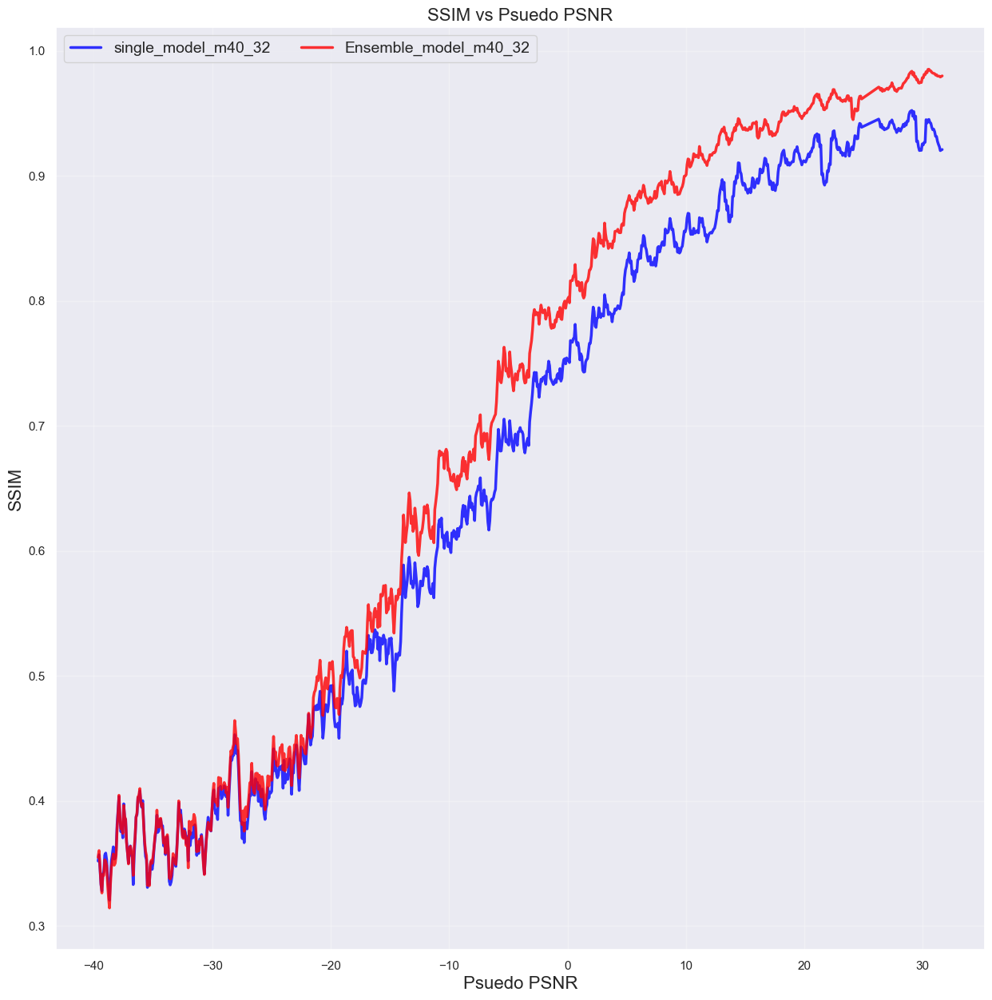

In [242]:
# Plots the SSIM vs Psuedo PSNR for the different models in the cascade and compares this to the original model.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = "SSIM_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = "Augmented_SSIM_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("SSIM", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("SSIM vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [243]:
# Generates the Perceptual Loss Distribution for the combined data.
uniform = np.linspace(-40, 32, 900)
Perceptual_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "Perceptual_Distribution_m40_32":Perceptual_Distribution_1, "Perceptual_Distribution_24_32":Perceptual_Distribution_2, "Perceptual_Distribution_16_24":Perceptual_Distribution_3, 
                                  "Perceptual_Distribution_8_16":Perceptual_Distribution_4, "Perceptual_Distribution_0_8":Perceptual_Distribution_5, "Perceptual_Distribution_m8_0":Perceptual_Distribution_6, 
                                  "Perceptual_Distribution_m16_m8":Perceptual_Distribution_7, "Perceptual_Distribution_m24_m16":Perceptual_Distribution_8, "Perceptual_Distribution_m32_m24":Perceptual_Distribution_9, 
                                  "Perceptual_Distribution_m40_m32":Perceptual_Distribution_10})
Perceptual_Distribution

,Psuedo_Psnr,Perceptual_Distribution_m40_32,Perceptual_Distribution_24_32,Perceptual_Distribution_16_24,Perceptual_Distribution_8_16,Perceptual_Distribution_0_8,Perceptual_Distribution_m8_0,Perceptual_Distribution_m16_m8,Perceptual_Distribution_m24_m16,Perceptual_Distribution_m32_m24,Perceptual_Distribution_m40_m32
0,-40.000000,0.172402,0.172497,0.173299,0.173065,0.173189,0.172218,0.172255,0.172343,0.172393,0.172396
1,-39.919911,0.151720,0.151895,0.152719,0.151971,0.152194,0.151663,0.151642,0.151700,0.151710,0.151709
2,-39.839822,0.126976,0.127165,0.128287,0.127292,0.127420,0.126979,0.126932,0.126947,0.126962,0.126959
3,-39.759733,0.153367,0.153395,0.153825,0.153802,0.155864,0.153245,0.153214,0.153360,0.153355,0.153361
4,-39.679644,0.111610,0.111719,0.112338,0.111689,0.113396,0.111319,0.111206,0.111623,0.111617,0.111617
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,0.700143,0.755424,0.533138,0.285814,0.415021,0.409062,0.076578,0.393063,0.340066,0.076578
896,31.759733,0.675431,0.710425,0.541965,0.313000,0.389663,0.419958,0.192127,0.424661,0.312874,0.117681
897,31.839822,0.577300,0.607244,0.541344,0.374395,0.361178,0.394255,0.261122,0.384568,0.273253,0.187772
898,31.919911,0.661423,0.696174,0.439222,0.290636,0.428832,0.340894,0.119215,0.411898,0.329917,0.119215


In [244]:
# Generates the smoothed Perceptual Loss Distribution for the combined data.
Smoothed_Perceptual_Distribution = Perceptual_Distribution.rolling(window=10).mean()
Smoothed_Perceptual_Distribution = Smoothed_Perceptual_Distribution.dropna()
Smoothed_Perceptual_Distribution

,Psuedo_Psnr,Perceptual_Distribution_m40_32,Perceptual_Distribution_24_32,Perceptual_Distribution_16_24,Perceptual_Distribution_8_16,Perceptual_Distribution_0_8,Perceptual_Distribution_m8_0,Perceptual_Distribution_m16_m8,Perceptual_Distribution_m24_m16,Perceptual_Distribution_m32_m24,Perceptual_Distribution_m40_m32
9,-39.639600,0.135467,0.135591,0.136345,0.136131,0.137780,0.135322,0.135252,0.135433,0.135458,0.135459
10,-39.559511,0.136927,0.137045,0.137781,0.137541,0.139258,0.136781,0.136693,0.136891,0.136918,0.136921
11,-39.479422,0.135272,0.135384,0.136116,0.135992,0.137973,0.135150,0.135025,0.135236,0.135263,0.135266
12,-39.399333,0.134909,0.135017,0.135700,0.135678,0.137662,0.134761,0.134611,0.134871,0.134901,0.134905
13,-39.319244,0.127537,0.127652,0.128395,0.128388,0.130391,0.127406,0.127232,0.127496,0.127530,0.127532
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,0.648668,0.684697,0.563545,0.349385,0.399628,0.402528,0.184609,0.391513,0.315664,0.130382
896,31.399333,0.655081,0.691673,0.559178,0.350232,0.404293,0.410616,0.184177,0.400104,0.322849,0.127676
897,31.479422,0.649299,0.686905,0.553707,0.357103,0.401824,0.408472,0.187715,0.401188,0.322714,0.130918
898,31.559511,0.653860,0.692127,0.538824,0.347249,0.404427,0.402524,0.185182,0.400229,0.322592,0.128399


c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

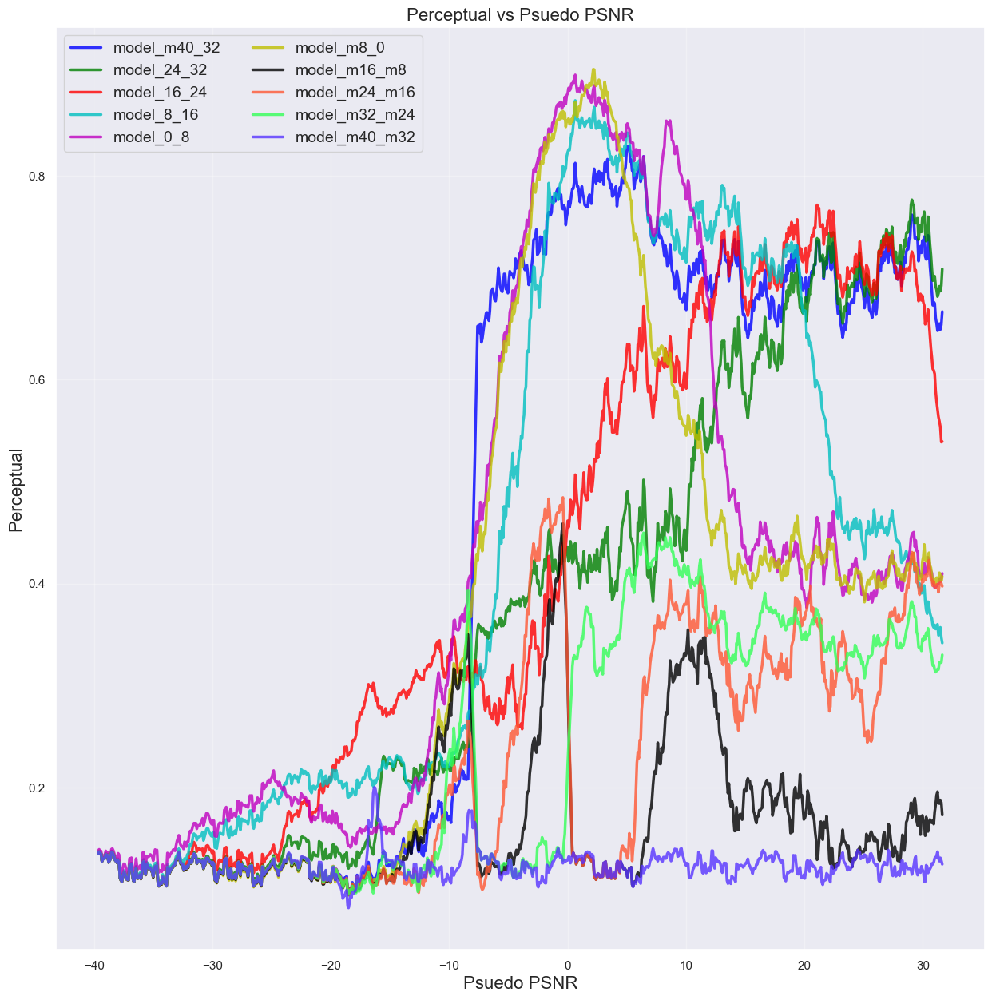

In [245]:
# Plots the Perceptual Loss vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, psnr in enumerate(Smoothed_Perceptual_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = psnr, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("Perceptual", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("Perceptual vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [246]:
# Combines the 9 different models into a single model.
Augmented_Perceptual_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_Perceptual_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_Perceptual_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_Perceptual_Distribution.extend(Specific_Perceptual_Distribution)
Augmented_Perceptual_Distribution = np.array(Augmented_Perceptual_Distribution)
Augmented_Perceptual_Distribution.shape

(891,)

In [247]:
Smoothed_Perceptual_Distribution["Augmented_Perceptual_Distribution_m40_32"] = Augmented_Perceptual_Distribution

c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\GAPGalaxy\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in 

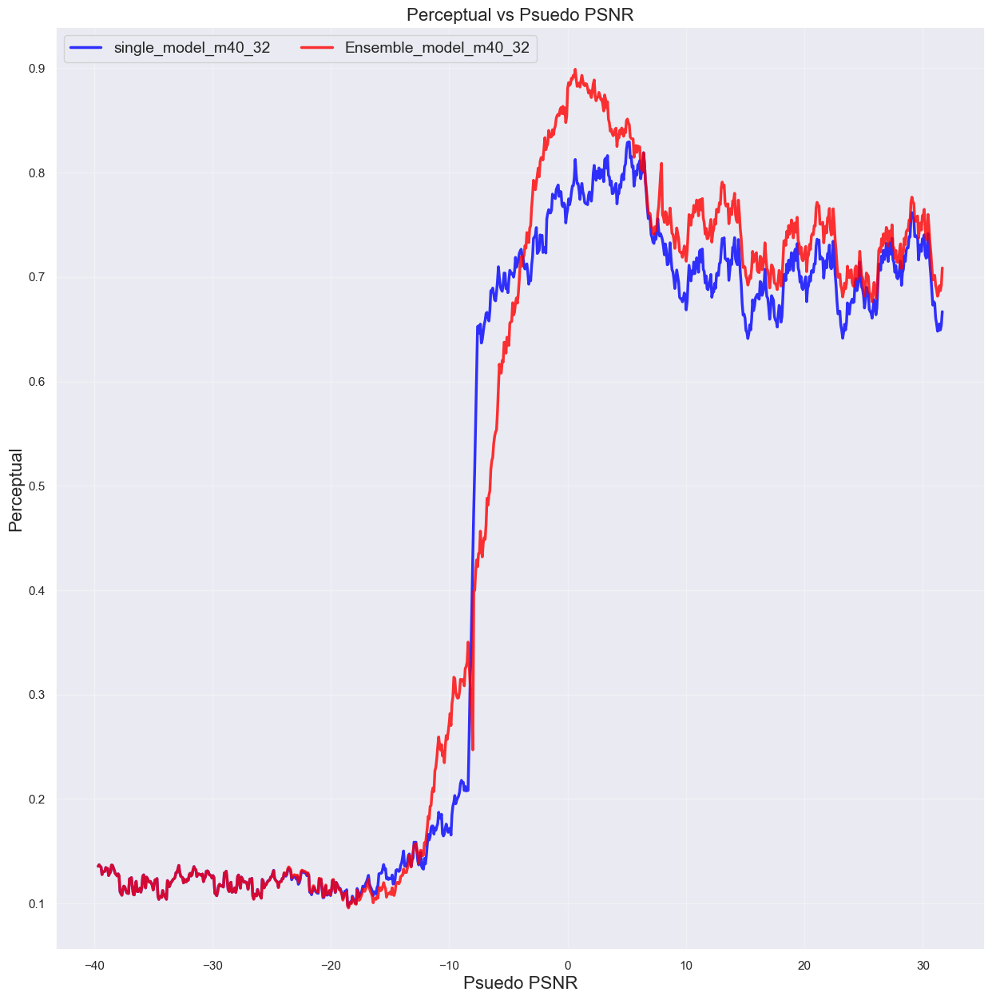

In [248]:
# Plots the Perceptual Loss vs Psuedo PSNR for the different models in the cascade and compares this to the original model.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = "Perceptual_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = "Augmented_Perceptual_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("Perceptual", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("Perceptual vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [250]:
# Loads the models from their checkpoints and combines them to form the ensemble model.
name = "FaceGenerationUNet128x128-m40-m32"
CHECKPOINT_PATH = "./models/"
model_m40_32 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-m32-m24"
CHECKPOINT_PATH = "./models/"
model_m32_24 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-m24-m16"
CHECKPOINT_PATH = "./models/"
model_m24_16 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-m16-m8"
CHECKPOINT_PATH = "./models/"
model_m16_8 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-m8-0"
CHECKPOINT_PATH = "./models/"
model_m8_0 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-0-8"
CHECKPOINT_PATH = "./models/"
model_0_8 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-8-16"
CHECKPOINT_PATH = "./models/"
model_8_16 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-16-24"
CHECKPOINT_PATH = "./models/"
model_16_24 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-24-32"
CHECKPOINT_PATH = "./models/"
model_24_32 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

Models = [model_m40_32, model_m32_24, model_m24_16, model_m16_8, model_m8_0, model_0_8, model_8_16, model_16_24, model_24_32]
Models

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


[UNet(
   (conv_final): Conv2d(50, 3, kernel_size=(1, 1), stride=(1, 1))
   (down_convs): ModuleList(
     (0): DownConv(
       (conv1): Conv2d(30, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(50, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv3): Conv2d(50, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
     )
     (1): DownConv(
       (conv1): Conv2d(50, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(100, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv3): Conv2d(100, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
     )
     (2): DownConv(
       (conv1): Conv2d(100, 200, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(200, 200, kernel_size=(3, 3), stride=(1,

In [251]:
def sample_image_3(input_image,
                 model,
                 max_photons = None,
                 max_its = 500000,
                 max_psnr = -15,
                 save_every_n = 5,
                 beta = 0.1
                ):

    start = input_image.clone()
    photons = start
    photnum = 1
    model = model.to(device)

    denoised = None
    stack = []
    
    sumDenoised = start
    region = 64
    
    for i in range(max_its):
        #print(i)
        # compute the pseudo PSNR
        psnr = np.log10(photons.mean().item() + 1e-50) * 10
        psnr = max(-40, psnr)
        print("Hello World", psnr, max_psnr)
        if i % 10 == 0:
            print(psnr)
            
        if (max_photons is not None) and (photons.sum().item() > max_photons):
            print(max_photons, "Maximum Photons Reached")
            break
            
        if psnr > max_psnr:
            print(psnr, "Maximum Psnr Reached")
            break
    
        denoised = model(photons).detach()
        denoised = denoised - denoised.max()
        denoised = torch.exp(denoised)   
        denoised = denoised / (denoised.sum(dim=(-1,-2,-3), keepdim = True))

        #denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
        #plt.figure(figsize=(5,5))
        #plt.imshow(denoised.squeeze(0).permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
        #plt.title('denoised')
        #plt.show()
        #plt.clf()

        #photon_image = (photons - photons.min())/(photons.max() - photons.min())
        #plt.imshow(photon_image.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons')
        #plt.show()
        #plt.clf()

        # here we save an image into our stack
        if (save_every_n is not None) and (i%save_every_n == 0):  

            imgsave = denoised.squeeze(0).permute(1,2,0).detach().cpu()
            imgsave = imgsave/imgsave.max()
            photsave = photons.squeeze(0).permute(1,2,0).detach().cpu()
            photsave = photsave / max(photsave.max(),1)      
            combi = torch.hstack((photsave,imgsave))
            stack.append(combi.numpy())

        # increase photon number
        photnum = max(beta* photons.sum(),1)
        
        # draw new photons
        new_photons = torch.poisson(denoised*(photnum)) 
        
        # add new photons
        photons = photons + new_photons 
        #photon_image_new = (photons_new - photons_new.min())/(photons_new.max() - photons_new.min())
        #plt.imshow(photon_image_new.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons_new')
        #plt.show()
        #plt.clf()
    
    #print("Final PSNR Score", psnr)
    denoised_2 = denoised[...].detach().cpu().numpy()
    denoised_2 = (denoised_2 - denoised_2.min())/(denoised_2.max() - denoised_2.min())
    vmax = denoised_2.max()
    plt.figure(figsize=(5,5))
    plt.imshow(denoised_2[0].transpose(1,2,0),vmin = 0, vmax = vmax)
    plt.show()
    plt.clf()
    return denoised, photons, stack, i, psnr


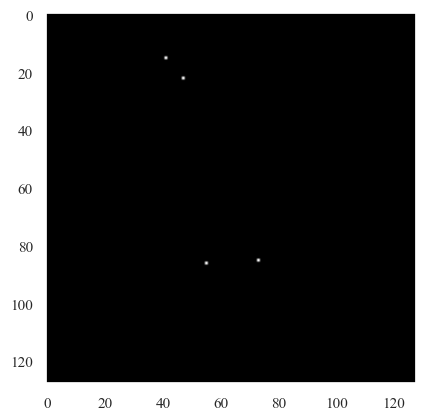

PSNR: -35.68800735473633


In [254]:
# Checks the Train_Dataset works
ImageNoise, psnr_map, image_target = Train_Dataset.__getitem__(40)
plt.imshow(ImageNoise.detach().cpu().numpy().transpose(1,2,0)[:,:,0], cmap = "gray")
plt.show()
print(f"PSNR: {psnr_map.min().detach().cpu().numpy()}")

In [255]:
PSNR_Ranges

[(-40, -32),
 (-32, -24),
 (-24, -16),
 (-16, -8),
 (-8, 0),
 (0, 8),
 (8, 16),
 (16, 24),
 (24, 32)]

PSNR: -500.0
Model: 1, psnr_level -32
Hello World -40 -32
-40
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -39.92571168970606 -32
Hello World -39.133899436317556 -32
Hello World -38.46443124417179 -32
-38.46443124417179
Hello World -38.46443124417179 -32
Hello World -36.91541173306625 -32
Hello World -36.50148499444094 -32
Hello World -36.50148499444094 -32
Hello World -35.45413128753198 -32
Hello World -35.45413128753198 -32
Hello World -35.45413128753198 -32
Hello World -35.45413128753198 -32
Hello World -35.45413128753198 -32
Hello World -35.15449934959718 -32
-35.15449934959718
Hello World -34.610922482738616 -32
Hello World -34.36268688912093 -32
Hello World -34.36268688912093 -32
Hello World -33.90511177642644 -32
Hello World -33.90511177642644 -32
Hello World -33.6932189928148 -32
Hello World -33.6932189928148 -32
Hello World -33.49118503780113 -32
Hello World -33.298133399

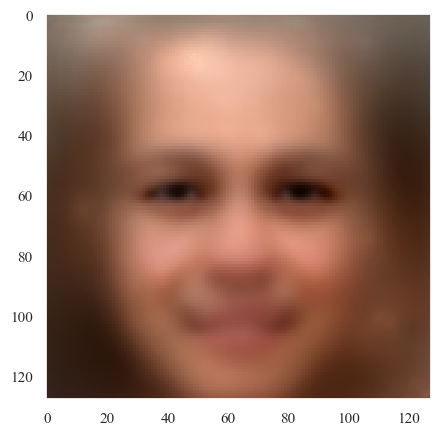

Psnr_Range -31.863912027525096 has been reached at 38 iterations
Model: 2, psnr_level -24
Hello World -31.863912027525096 -24
-31.863912027525096
Hello World -31.863912027525096 -24
Hello World -31.863912027525096 -24
Hello World -31.863912027525096 -24
Hello World -31.73027254137512 -24
Hello World -31.474731378315383 -24
Hello World -31.11757586499234 -24
Hello World -30.78757327193823 -24
Hello World -30.580727191718363 -24
Hello World -30.580727191718363 -24
Hello World -30.194433272674374 -24
-30.194433272674374
Hello World -30.102999566398122 -24
Hello World -30.013450970817637 -24
Hello World -29.925711565453422 -24
Hello World -29.925711565453422 -24
Hello World -29.925711565453422 -24
Hello World -29.591474341924307 -24
Hello World -29.511784894602286 -24
Hello World -29.433531374252357 -24
Hello World -29.433531374252357 -24
Hello World -29.433531374252357 -24
-29.433531374252357
Hello World -29.35666338342908 -24
Hello World -29.281131861705486 -24
Hello World -29.2068915429

<Figure size 640x480 with 0 Axes>

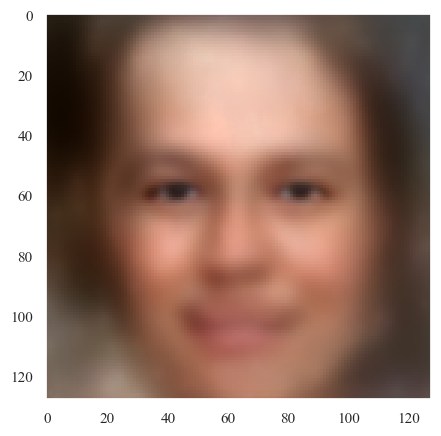

Psnr_Range -23.94876003753868 has been reached at 120 iterations
Model: 3, psnr_level -16
Hello World -23.94876003753868 -16
-23.94876003753868
Hello World -23.94876003753868 -16
Hello World -23.92688100955422 -16
Hello World -23.840451234578136 -16
Hello World -23.819110265895006 -16
Hello World -23.79787316796699 -16
Hello World -23.6932189928148 -16
Hello World -23.6932189928148 -16
Hello World -23.672587230143705 -16
Hello World -23.672587230143705 -16
Hello World -23.631615905766616 -16
-23.631615905766616
Hello World -23.631615905766616 -16
Hello World -23.631615905766616 -16
Hello World -23.570874428644682 -16
Hello World -23.570874428644682 -16
Hello World -23.510970791752808 -16
Hello World -23.451882195647606 -16
Hello World -23.43236316108925 -16
Hello World -23.355153076292908 -16
Hello World -23.355153076292908 -16
Hello World -23.355153076292908 -16
-23.355153076292908
Hello World -23.317056972064986 -16
Hello World -23.26053194842586 -16
Hello World -23.20473317644072 -1

<Figure size 640x480 with 0 Axes>

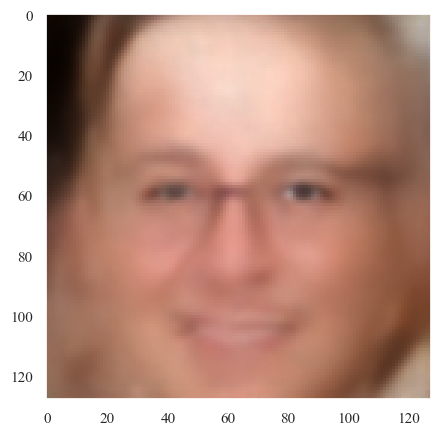

Psnr_Range -15.974195981748379 has been reached at 187 iterations
Model: 4, psnr_level -8
Hello World -15.974195981748379 -8
-15.974195981748379
Hello World -15.946311598015582 -8
Hello World -15.897941095835774 -8
Hello World -15.867127799504196 -8
Hello World -15.819626471110125 -8
Hello World -15.765967681311984 -8
Hello World -15.716257737015539 -8
Hello World -15.680162130726671 -8
Hello World -15.667110346588426 -8
Hello World -15.61529224693954 -8
Hello World -15.576830493357743 -8
-15.576830493357743
Hello World -15.548206075106485 -8
Hello World -15.510331317968788 -8
Hello World -15.460340226057365 -8
Hello World -15.413990321668404 -8
Hello World -15.359015602556227 -8
Hello World -15.328772040038974 -8
Hello World -15.280816240523885 -8
Hello World -15.215730200185067 -8
Hello World -15.180635505624046 -8
Hello World -15.142933489475311 -8
-15.142933489475311
Hello World -15.074178311018958 -8
Hello World -15.026127102545457 -8
Hello World -14.981382569911233 -8
Hello World

<Figure size 640x480 with 0 Axes>

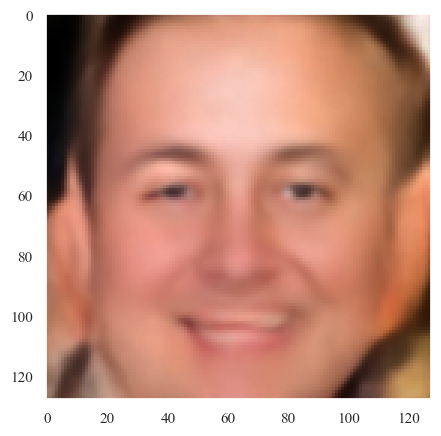

Psnr_Range -7.971143560512113 has been reached at 185 iterations
Model: 5, psnr_level 0
Hello World -7.971143560512113 0
-7.971143560512113
Hello World -7.927063425630144 0
Hello World -7.879086779311615 0
Hello World -7.8332431472985515 0
Hello World -7.7905343268307545 0
Hello World -7.747188837372967 0
Hello World -7.710526166239532 0
Hello World -7.665902798938161 0
Hello World -7.624800699306338 0
Hello World -7.579526714639425 0
Hello World -7.54374465793508 0
-7.54374465793508
Hello World -7.503777338569259 0
Hello World -7.454821336302755 0
Hello World -7.407870124218956 0
Hello World -7.361902248967779 0
Hello World -7.322612438844604 0
Hello World -7.2850929587157855 0
Hello World -7.242272642966256 0
Hello World -7.1956991761564275 0
Hello World -7.160174698374498 0
Hello World -7.114923378490996 0
-7.114923378490996
Hello World -7.072389620354959 0
Hello World -7.01868946391526 0
Hello World -6.9770830589235056 0
Hello World -6.941985034137767 0
Hello World -6.9063011072283

<Figure size 640x480 with 0 Axes>

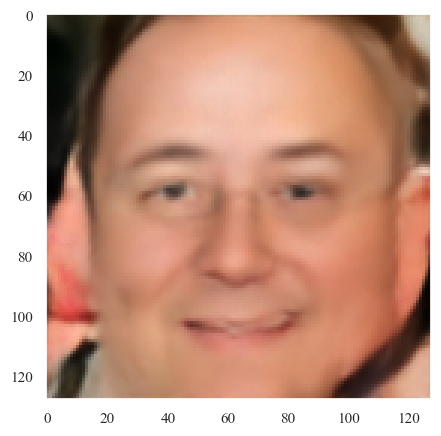

Psnr_Range 0.037040249139962164 has been reached at 185 iterations
Model: 6, psnr_level 8
Hello World 0.037040249139962164 8
0.037040249139962164
Hello World 0.080450879838603 8
Hello World 0.12377556357572829 8
Hello World 0.16573654017492415 8
Hello World 0.20872812871600646 8
Hello World 0.25096456889400953 8
Hello World 0.29312425256912167 8
Hello World 0.33626930062924865 8
Hello World 0.377208465462568 8
Hello World 0.42193620472155113 8
Hello World 0.46596988959151087 8
0.46596988959151087
Hello World 0.5086185808304405 8
Hello World 0.5539643805008714 8
Hello World 0.5983801680710871 8
Hello World 0.6417362894539681 8
Hello World 0.6830791308600281 8
Hello World 0.7271716961752163 8
Hello World 0.7683050689044836 8
Hello World 0.8097855537097755 8
Hello World 0.8510191486290142 8
Hello World 0.8897053481765193 8
0.8897053481765193
Hello World 0.9347529419885416 8
Hello World 0.97658652267513 8
Hello World 1.0215145578373412 8
Hello World 1.0654985168209437 8
Hello World 1.10958

<Figure size 640x480 with 0 Axes>

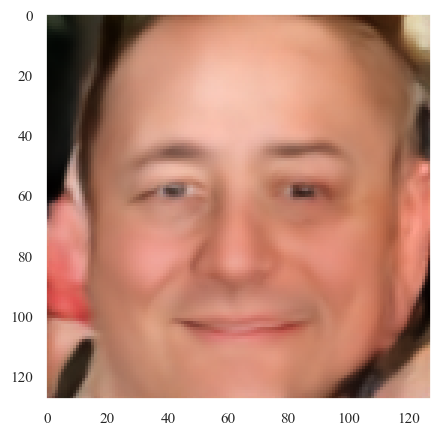

Psnr_Range 8.01022273408285 has been reached at 185 iterations
Model: 7, psnr_level 16
Hello World 8.01022273408285 16
8.01022273408285
Hello World 8.053704841467516 16
Hello World 8.096043919197966 16
Hello World 8.139249005010855 16
Hello World 8.18240460009888 16
Hello World 8.22553444598979 16
Hello World 8.269030002180887 16
Hello World 8.313553773304006 16
Hello World 8.356245342010222 16
Hello World 8.398904589967653 16
Hello World 8.442198995368512 16
8.442198995368512
Hello World 8.486718888085448 16
Hello World 8.530526486593757 16
Hello World 8.57332024731145 16
Hello World 8.61734871103102 16
Hello World 8.660129329941743 16
Hello World 8.702361697734098 16
Hello World 8.745296338119974 16
Hello World 8.788931586720576 16
Hello World 8.832977071821658 16
Hello World 8.875286770523495 16
8.875286770523495
Hello World 8.918831730532983 16
Hello World 8.961630377035345 16
Hello World 9.005067172257634 16
Hello World 9.048326498596166 16
Hello World 9.092662586602495 16
Hello W

<Figure size 640x480 with 0 Axes>

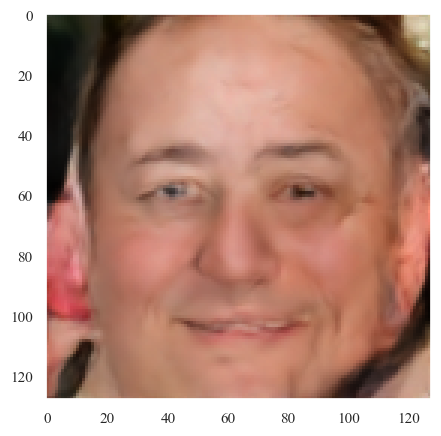

Psnr_Range 16.010234408400702 has been reached at 185 iterations
Model: 8, psnr_level 24
Hello World 16.010234408400702 24
16.010234408400702
Hello World 16.053562158961263 24
Hello World 16.097161088855305 24
Hello World 16.140436265831795 24
Hello World 16.183584078613414 24
Hello World 16.226659764173068 24
Hello World 16.26992719589233 24
Hello World 16.313162771489786 24
Hello World 16.35663615124809 24
Hello World 16.40056370264102 24
Hello World 16.443570089565213 24
16.443570089565213
Hello World 16.486139147427373 24
Hello World 16.529383351088903 24
Hello World 16.572833671773203 24
Hello World 16.616862452523552 24
Hello World 16.65967935808333 24
Hello World 16.702855979429202 24
Hello World 16.745444936806418 24
Hello World 16.7887788387606 24
Hello World 16.83171073818494 24
Hello World 16.874938935074326 24
16.874938935074326
Hello World 16.91823694377447 24
Hello World 16.96179755721982 24
Hello World 17.005086049165126 24
Hello World 17.048771745549985 24
Hello World 1

<Figure size 640x480 with 0 Axes>

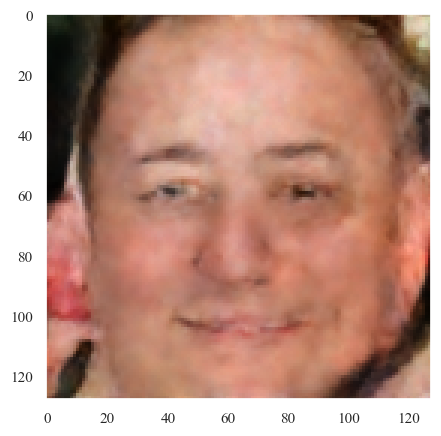

Psnr_Range 24.009338364606684 has been reached at 185 iterations
Model: 9, psnr_level 32
Hello World 24.009338364606684 32
24.009338364606684
Hello World 24.0524078748096 32
Hello World 24.095648570836154 32
Hello World 24.13902615267049 32
Hello World 24.18241038833479 32
Hello World 24.225663573758315 32
Hello World 24.268807162436797 32
Hello World 24.312052318003936 32
Hello World 24.35524937455225 32
Hello World 24.398456671509166 32
Hello World 24.44170877664085 32
24.44170877664085
Hello World 24.484966640814246 32
Hello World 24.52820110422767 32
Hello World 24.571462293911242 32
Hello World 24.61474977391152 32
Hello World 24.657858557384394 32
Hello World 24.700975139308067 32
Hello World 24.74429292603297 32
Hello World 24.787495418452433 32
Hello World 24.830768743901245 32
Hello World 24.873894740026895 32
24.873894740026895
Hello World 24.91696325563726 32
Hello World 24.960356712641083 32
Hello World 25.003597276900145 32
Hello World 25.046842783016242 32
Hello World 25.

<Figure size 640x480 with 0 Axes>

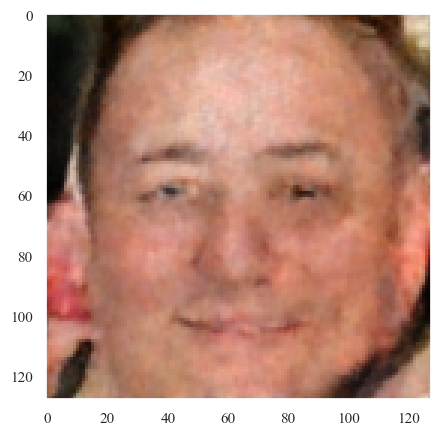

Psnr_Range 32.00384669195975 has been reached at 185 iterations


((9, 1, 3, 128, 128), (9, 1, 3, 128, 128))

<Figure size 640x480 with 0 Axes>

In [261]:
# Generates an unseen image from a blank canvas using the ensemble model.
def Sample_From_Scratch(input_image,
                        Models,
                        max_photons = None,
                        max_its = 500000,
                        max_psnr_list = None,
                        save_every_n = 5,
                        beta = 0.15
                        ):
    output_images = np.zeros((len(Models), input_image.shape[0], input_image.shape[1], input_image.shape[2], input_image.shape[3]))
    output_photons = np.zeros((len(Models), input_image.shape[0], input_image.shape[1], input_image.shape[2], input_image.shape[3]))
    stacks = []
    for i, model in enumerate(Models):
        if i == 0:
            photons = input_image.clone()
        if max_psnr_list is not None:
            max_psnr = max_psnr_list[i]
        else:
            max_psnr = -15
        print(f"Model: {i+1}, psnr_level {max_psnr_list[i]}")
        denoised, photons, stack, it, psnr = sample_image_3(photons, model, max_photons = max_photons, max_its = max_its, max_psnr = max_psnr, save_every_n = save_every_n, beta = beta)
        print(f"Psnr_Range {psnr} has been reached at {it} iterations")
        output_images[i] = denoised[...].detach().cpu().numpy()
        output_photons[i] = photons[...].detach().cpu().numpy()
        stacks.append(stack)

    return output_images, output_photons

inp_img = torch.zeros(1,3,128,128).to(device)
Psnr = np.log10(inp_img.mean().item() + 1e-50) * 10
print(f"PSNR: {Psnr}")
Output_Images, Output_Photons = Sample_From_Scratch(inp_img, Models, max_photons = 1e8, max_its = 1000, max_psnr_list = [-32, -24, -16, -8, 0, 8, 16, 24, 32], save_every_n = 5, beta = 0.01)
Output_Images.shape, Output_Photons.shape